<img align="left" src = https://project.lsst.org/sites/default/files/Rubin-O-Logo_0.png width=250 style="padding: 10px"> 
<br>
<b>Reduced Chi^2 Notebook</b> <br>
Contact author: Brianna Smart<br>
Last verified to run: -  01/26/2023<br>
LSST Science Piplines version: - Weekly 2023_04 Large Container<br>
Container Size: Large <br># Clean Notebook

## Table of Contents

1. [Introduction](#Introduction)
2. [Conclusions](#Conclusions)
3. [Setup](#Setup)
4. [Missing dipNdata](#Missing-dipNdata)
5. [Negative Artifacts](#Negative-Artifacts)
6. [Non-Dipole negative sources with SNR < 8.0](#Non-Dipole-negative-sources-with-SNR-<-8.0)
7. [Sources where various flux/FluxErr <= 4.0](#Sources-where-various-flux/FluxErr-<=-4.0)
8. [Sources with Dipoles and dipChi2 > 30000](#Sources-with-Dipoles-and-dipChi2->-30000)
9. [Solar System Objects snr > 8.0 psFlux > 0](#Solar-System-Objects-snr->-8.0-psFlux->-0)
10. [Sources w/ apflux/psflux >= 1.5](#Sources-w/-apflux/psflux->=-1.5)
11. [apFlux/psFlux ratio < 1.5 and totFlux/psFlux > 1.1](#apFlux/psFlux-ratio-<-1.5-and-totFlux/psFlux->-1.1)
12. [Non-Dipole Source w/ snr above 8.0 and negative aperture flux](#Non-Dipole-Source-w/-snr-above-8.0-and-negative-aperture-flux)
13. [Non-Dipole Source w/ snr above 8.0 and positive aperture flux](#Non-Dipole-Source-w/-snr-above-8.0-and-positive-aperture-flux)

## Introduction

The purpose of this notebook is to use the reduced chi^2 of the psFlux to investigate if it reveals bad sources/issues with the data. This only looks at a subset of 100,000 sources. Not all sources can be plotted as the cutouts are limited to 10,000, so only a portion can be displayed with the current cuttout library. While looking at the reduced chi^2 is a good way of checking sources, it likely shouldn't ever be used as a hard cut for good or bad sources on its own. Combined with other values, such as the psFlux, apFlux, or snr, it can reveal missed cosmic rays, strange dipoles, and what looks like edge effects. However, there are almost always good sources mixed in with the bad ones, so a straight cut using the values would not be so simple.

## Conclusions

Section 4 shows missing dipNdata. While looking through the data, it was noted that dipNdata is 0 for all cases, so I was not able to do a reduced chi^2 compparison using the dipoles. However, this will be addressed in a future notebook.

Using comparisons of the reduced chi^2 for both the psFlux and the aperture flux does appear to help us find artifacts. In particular, missed cosmic rays or poorly subtracted ones often appear when looking at sources with a high reduced chi^2 ( > 4.0) with a psFlux or apFlux below -800. These are shown is section 5. After discussing with the HSC channel, these are badly subtracted slow moving CRs which came from a night when only 3 darks were taken. This is unlikely to be an issue with LSST, however it is pretty consistent at only finding these bad CRs. This appeared to be the only combination trialed that guarunteed to find only bad sources. All of the other examples in this notebook would find a mixture of real and bad sources. 

Other artifacts can also be found, which can be seen in Non-Dipole negative sources with SNR < 8.0 in section 6. Many of the sources meeting those criteria seem to be streaking, possibly from vinietted regions? However, it shouldn't be used as more than a cursory diagnostic tool, as many valid sources, such as solar system objects and dipoles, can have a larger reduced chi^2.

Section 7 looks at psFlux, apFlux, and totFlux, and plots any sources where the flux is not at least 4x greater than the error. While it does puick out some bad sources it does look like there are valid sources mixed in, primarily solar system objects. 

Section 8 looks at the chi reduced chi^2 sources, both with a dipchi^2 over 30000 and later in the section with a dipChi^2 less than 30000. 30000 was chosen since most of the dipoles are below 30000, and I wanted to see if using that cut would make it obvious which are good or bad sources. However, it did not seem to make a difference as both selection criterias appeared to have sources which didn't look like good ones.

In section 9 I look at combining the > 4.0 reduced chi^2 with a signal to noise  > 8.0, no dipole, and only positive values seemed to find a number of SSOs. There are likely better ways to find these brighter SSO's, but it is an easy way to find several with no/few stellar sources mixed in.

Section 10, 12, and 13 do not uncover obvious bad sources.

Section 11 seems to find a 


## Setup

In [1]:
# Basic imports
import os
import sys
import numpy as np
import matplotlib.pyplot as plt
import importlib
import pandas as pd
from IPython.display import Image, display

from astropy.coordinates import SkyCoord

import lsst.geom
import lsst.daf.butler as dafButler
from lsst.ap.association import UnpackApdbFlags, TransformDiaSourceCatalogConfig
from lsst.analysis.ap import legacyApdbUtils as utils
from lsst.analysis.ap import legacyPlotUtils as plac
from lsst.analysis.ap import ZooniverseCutoutsTask
from lsst.analysis.ap.nb_utils import make_simbad_link
from lsst.analysis.ap import apdb


import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

importlib.reload(utils)

bandList = ['i', 'z', 'y']
colorList = ['C2', 'C3', 'C5', 'k']
import lsst.afw.display as afwDisplay
from IPython.display import IFrame
import matplotlib.pyplot as plt
import numpy as np
import scipy.ndimage
import gc


afwDisplay.setDefaultBackend('matplotlib') 

In [2]:
class PathManager:
    """Manage paths to local files, chunked directories, and s3 buckets.
    Parameters
    ----------
    root : `str`
        Root file path to manage.
    chunk_size : `int`, optional
        How many files per directory?
    """
    def __init__(self, root, chunk_size=None):
        self._root = root
        if chunk_size is not None and chunk_size % 10 != 0:
            raise RuntimeError(f"PathManager file chunking must be a multiple of 10, got {chunk_size}.")
        self._chunk_size = chunk_size

    def __call__(self, id=None, filename=None):
        """Return the full path to this diaSourceId cutout.
        Parameters
        ----------
        id : `int`
            Description
        filename : None, optional
            Description
        Returns
        -------
        TYPE
            Description
        """
        def chunker(id, size):
            return (id // size)*size

        if id is not None:
            if self._chunk_size is not None:
                return os.path.join(self._root, f"images/{chunker(id, self._chunk_size)}/{id}.png")
            else:
                return os.path.join(self._root, f"images/{id}.png")
        elif filename is not None:
            return os.path.join(self._root, filename)

In [3]:
def m_and_v_plots (datasetRefs, matplot=None, display_num=None):
    """
    Create an array of plots with their mask and variance

    Parameters
    ----------
    datasetRefs: a set of DataSetRefs
    returned by the butler
    matplot: Can be set to True
    display_num: Integer setting number of images

    Returns
    -------
    None
    """
    
    if display_num == None:
        display_num=1
    else:
        display_num=display_num
    
    if matplot != None:
        afwDisplay.setDefaultBackend('matplotlib') 
        
        for i, ref in enumerate(datasetRefs):

            calexp = butler.getDirect(ref)
            print('Visit: ', calexp.visitInfo.getId(), ', Detector: ',calexp.detector.getId())
            fig, ax = plt.subplots(1, 3, figsize=(14, 7))
            plt.sca(ax[0])  # set the first axis as current
            plt.xlabel('Image with Mask Overlay')
            display1 = afwDisplay.Display(frame=fig)
            display1.scale('asinh', -1, 30)
            display1.mtv(calexp)
            plt.sca(ax[1])  # set the second axis as current
            display2 = afwDisplay.Display(frame=fig)
            display2.mtv(calexp.mask)
            plt.tight_layout()
            plt.sca(ax[2]) 
            display3 = afwDisplay.Display(frame=fig)
            display3.scale('asinh', 'zscale')
            display3.mtv(calexp.variance)
            plt.tight_layout()
            plt.show()
            remove_figure(fig)
            
            if i == display_num:
                print('...')
                break

    else:
        afwDisplay.setDefaultBackend('firefly')
        for i, ref in enumerate(datasetRefs):

            calexp = butler.getDirect(ref)
            print('Visit: ', calexp.visitInfo.getId(), ', Detector: ',calexp.detector.getId())
            display = afwDisplay.Display(frame=3*i)
            display.scale('asinh', -1, 30)
            display.mtv(calexp)
            display = afwDisplay.Display(frame=3*i+1)
            display.setMaskTransparency(90)
            display.mtv(calexp.mask)
            display = afwDisplay.Display(frame=3*i+2)
            display.scale('asinh', 'zscale')
            display.mtv(calexp.variance)
            
            print(display_num)

            if i == display_num:
                print('...')
                break

In [4]:
def remove_figure(fig):
    """
    Remove a figure to reduce memory footprint.

    Parameters
    ----------
    fig: matplotlib.figure.Figure
        Figure to be removed.

    Returns
    -------
    None
    """
    # get the axes and clear their images
    for ax in fig.get_axes():
        for im in ax.get_images():
            im.remove()
    fig.clf()       # clear the figure
    plt.close(fig)  # close the figure
    gc.collect()    # call the garbage collector

In [5]:
def filter_data(data, filter_key, action_key, value_key):
    
    for index, keyword in enumerate(filter_key):
        
        if action_key[index] == 'ge':
            data_loc=np.where(data[keyword] >= value_key[index])
            data=data.iloc[data_loc]
            
        elif action_key[index] == 'le':
            data_loc=np.where(data[keyword] <= value_key[index])
            data=data.iloc[data_loc]
            
        elif action_key[index] == 'eq' or action_key[index] == 'bool':
            data_loc=np.where(data[keyword] == value_key[index])
            data=data.iloc[data_loc]
    
    print("Length of filtered data:", len(data))
    return data

In [6]:
def plot_sources(data, range=[]):
    paths=sources['diaSourceId'] 
    if range:
        for index, source in sources[range[0]:range[1]].iterrows():
            single_path = path_manager(source['diaSourceId'])
            display(Image(single_path))
            make_simbad_link(source['ra'], source['decl'])
            print(source['trailLength'])
            print(source['psChi2']/source["psNdata"])
        
    else:
        for index, source in sources.iterrows():
            single_path = path_manager(source['diaSourceId'])
            display(Image(single_path))
            make_simbad_link(source['ra'], source['decl'])
            print(source['trailLength'])
            print(source['psChi2']/source["psNdata"])

In [7]:
path_manager = PathManager("/sdf/group/rubin/u/parejko/scratch/cutouts", chunk_size=10000)

In [8]:
collection="u/elhoward/DM-35285/hsc-output-collection"
butler = lsst.daf.butler.Butler("/repo/main", collections=collection)

apdbQuery = apdb.ApdbPostgresQuery("elhoward_dm35285_hsc_appipewithfakes", butler=butler, instrument="HSC")
sources = apdbQuery.load_sources(exclude_flagged=True, limit=100000)
objects = apdbQuery.load_objects()

# Missing dipNdata

This is an example showing the missing dipNdata. A different ticket will fix this issue.

In [9]:
loc=np.where(sources["dipNdata"] >= 1.0)
test=sources.iloc[loc]

In [10]:
test

,diaSourceId,ccdVisitId,diaObjectId,ssObjectId,parentDiaSourceId,prv_procOrder,ssObjectReassocTime,midPointTai,ra,raErr,...,extendedness,spuriousness,flags,filterName,isDipole,bboxSize,pixelId,visit,detector,instrument


We are only looking at locations with a reducedChi2 above 4.0. the highReducedChiSources is used for the initial filter and the rest are done with the filter_data function.

In [11]:
loc=np.where(sources['psChi2']/sources["psNdata"] >= 4.0)
highReducedChiSources=sources.iloc[loc]

In [12]:
sources.iloc[loc]

,diaSourceId,ccdVisitId,diaObjectId,ssObjectId,parentDiaSourceId,prv_procOrder,ssObjectReassocTime,midPointTai,ra,raErr,...,extendedness,spuriousness,flags,filterName,isDipole,bboxSize,pixelId,visit,detector,instrument
911,136730283868428,63670,10176645834999199,0,0,0,None,56741.400239,150.936668,None,...,None,None,25165824,y,False,52,15559632681812,318,70,HSC
2938,138484778008815,64487,139356656369854,0,0,0,None,56741.406784,149.998834,None,...,None,None,41943040,y,True,72,15560542355770,322,87,HSC
4406,139300821795247,64867,506952169816741,0,0,0,None,56741.410019,149.736109,None,...,None,None,41943056,y,False,23,15560586186081,324,67,HSC
4950,139367393788126,64898,139367393788126,0,0,0,None,56741.410019,149.911444,None,...,None,None,0,y,False,51,15560534956517,324,98,HSC
6522,140874927309653,65600,505947147469722,0,0,0,None,56741.417458,150.473312,None,...,None,None,0,y,True,40,15558262971649,328,0,HSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99493,516285133750993,240414,510272179536771,0,0,0,None,56744.347048,149.827265,None,...,None,None,25165824,r,False,35,15560504030199,1202,14,HSC
99679,516287281235364,240415,516287281235364,0,0,0,None,56744.347048,149.596013,None,...,None,None,0,r,False,13,15560634462033,1202,15,HSC
99750,516287281235555,240415,531749163500379,0,0,0,None,56744.347048,149.644776,None,...,None,None,0,r,True,36,15560639841107,1202,15,HSC
99759,516287281235571,240415,531749163500394,0,0,0,None,56744.347048,149.649353,None,...,None,None,25165824,r,True,36,15560640103901,1202,15,HSC


We are looking at sources with a high reduced chi2, no dipole flag, only positive total fluxes, and a signal to noise above 10

# Negative Artifacts

### No Dipoles

In this section I am exploring sources with a negative total flux which are not marked dipole. This uncovers several negative artifacts which are the result of having only 3 darks and the CR and dark combination failing to completely remove the slow moving CR's. This is unlikely to occur normally assuming enough darks are taken. These artifacts appear in visits 1168-1190.

In [13]:
filter_key=["isDipole", "totFlux"]
action_key=["bool", "le"]
value_key=[False, -800.0]

filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)


Length of filtered data: 36


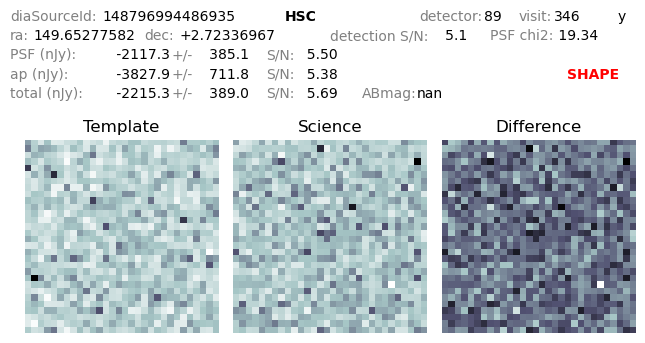

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6527758152871+2.7233696721571654&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


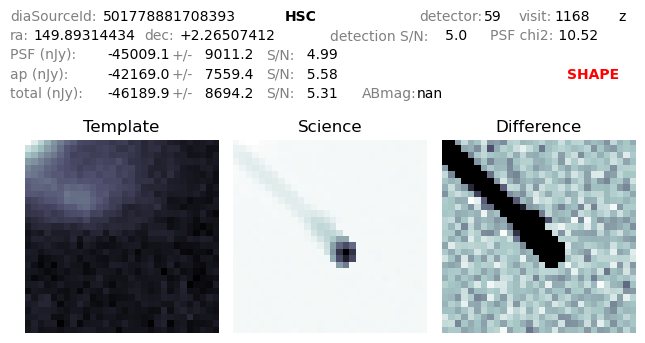

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.89314433582743+2.265074124754425&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


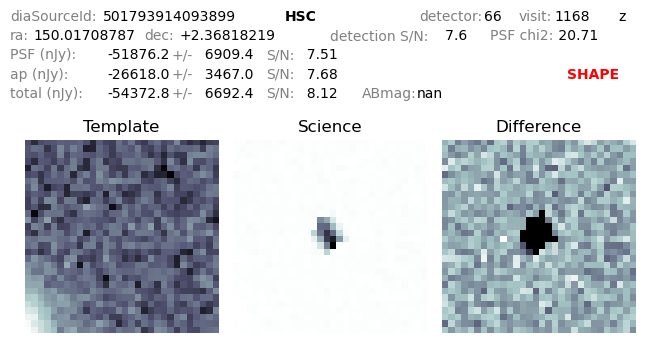

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.01708786774708+2.368182193996123&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


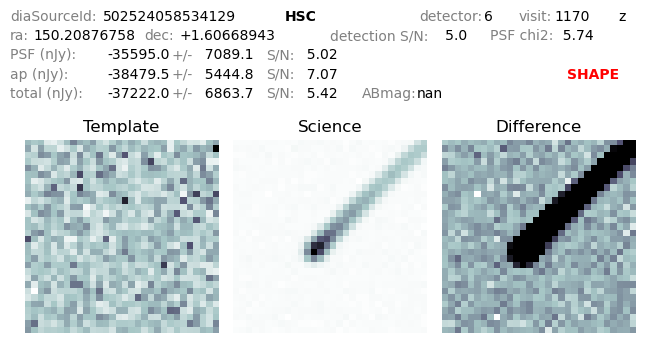

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.208767575911+1.6066894269907963&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


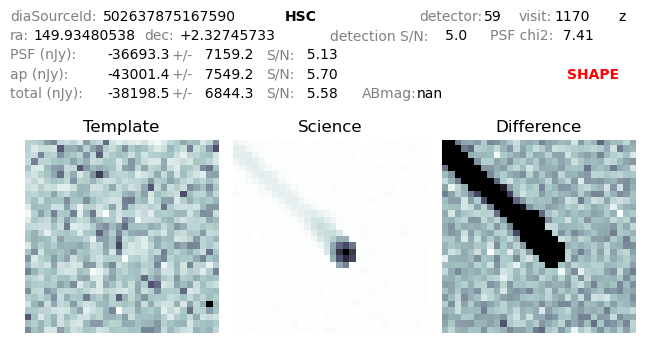

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.93480537982643+2.3274573262391964&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


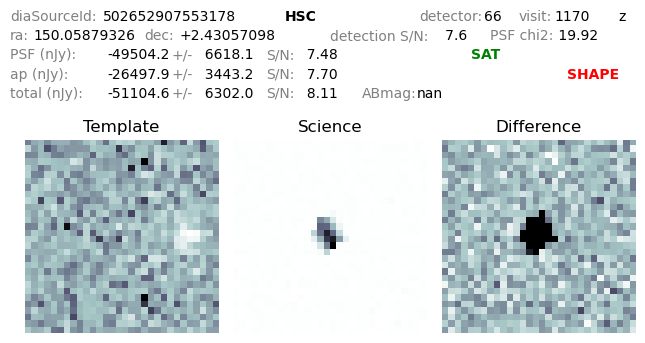

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.05879326375162+2.430570979007554&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


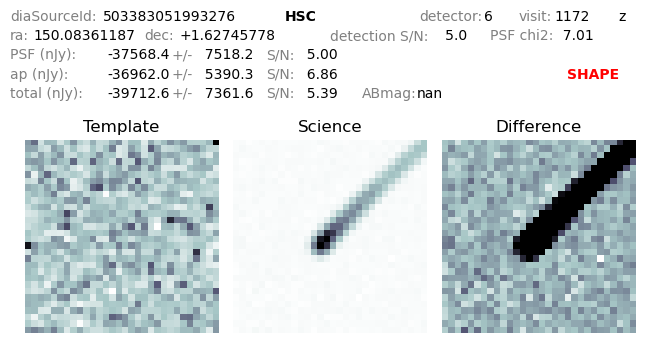

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.0836118708457+1.627457776898226&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


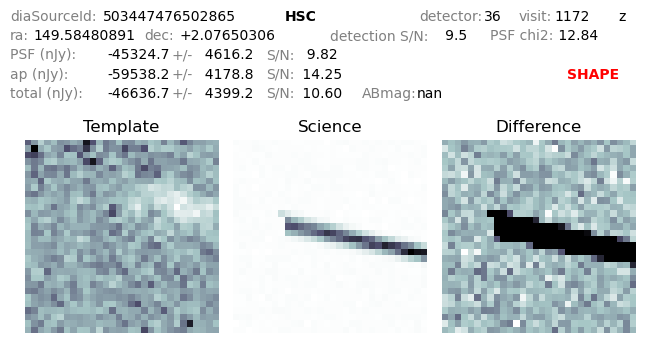

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.58480890993823+2.076503063672765&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


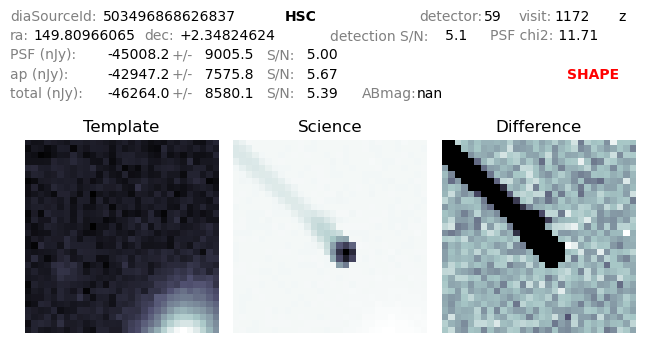

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.80966064519703+2.348246240156303&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


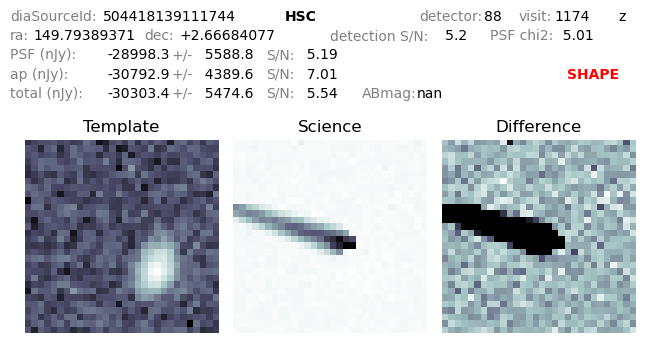

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.79389370933407+2.66684076856631&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


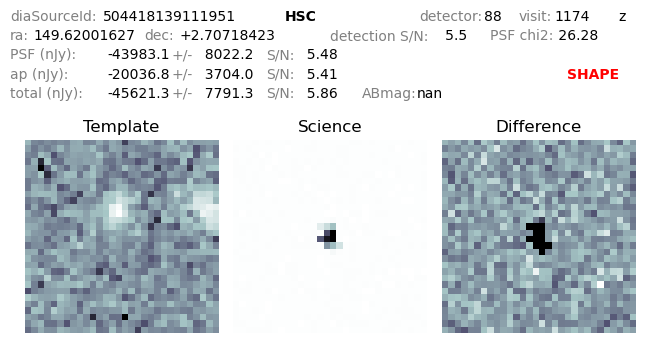

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.62001626849502+2.707184231633593&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


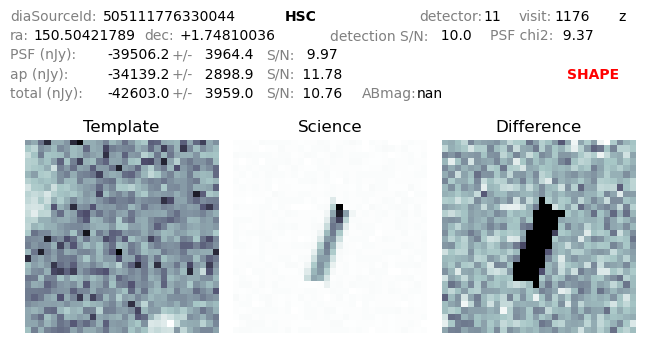

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.50421788712015+1.7481003565352207&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


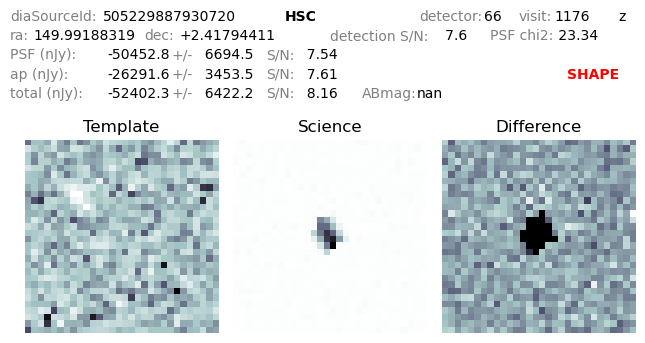

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.99188319221832+2.4179441094475167&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


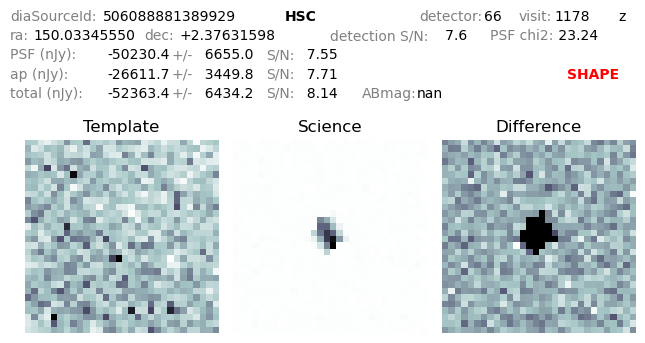

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.03345550358083+2.37631597932884&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


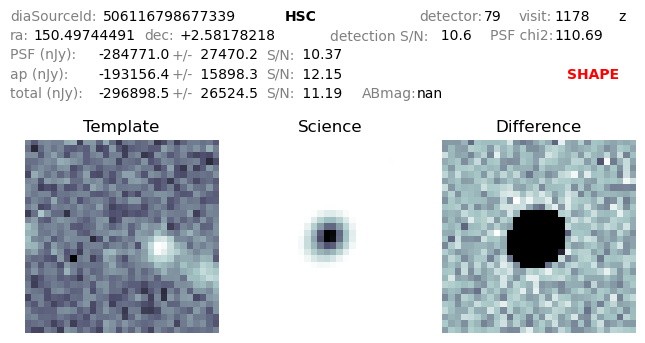

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4974449075851+2.5817821813390656&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


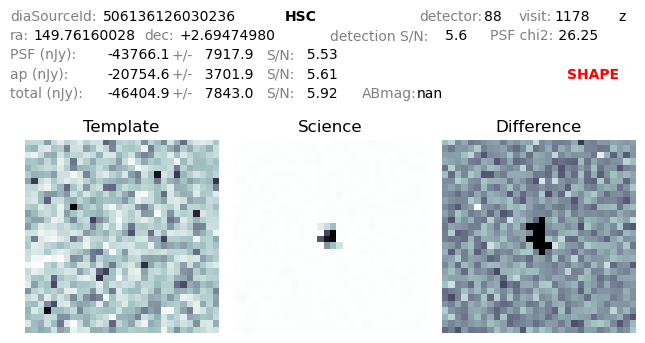

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.76160027683105+2.694749802707867&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


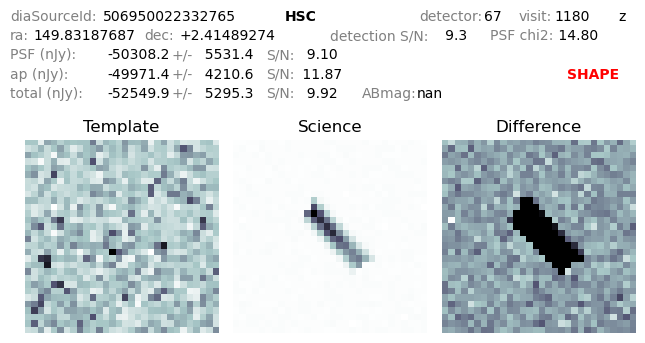

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.83187686589875+2.414892742272615&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


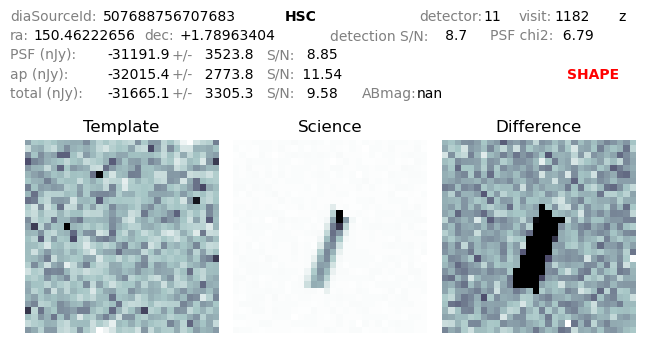

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.46222656439298+1.7896340419027683&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


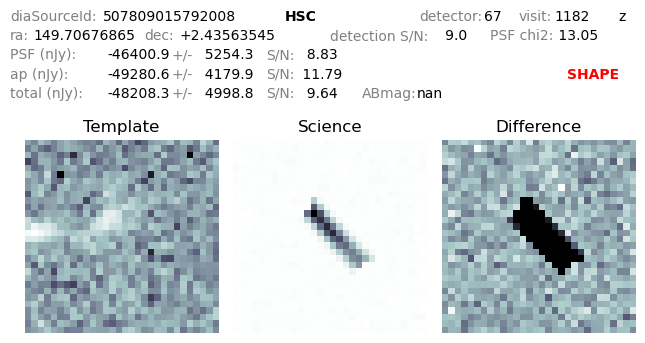

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7067686485846+2.4356354516097936&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


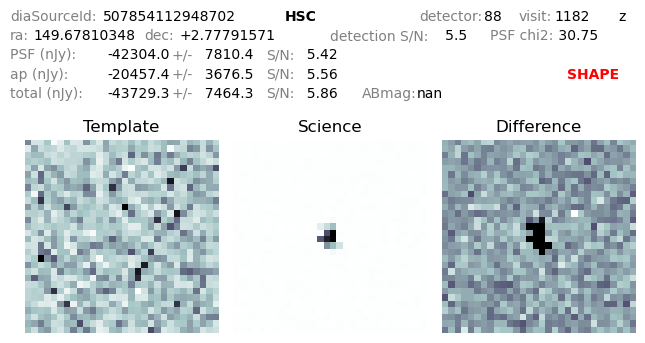

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.67810348498642+2.777915712974043&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


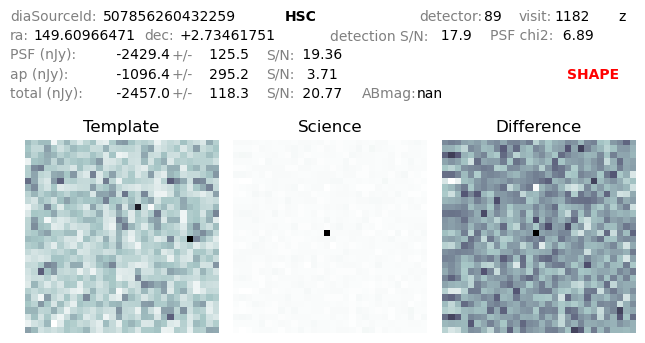

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.60966470837462+2.734617509825219&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


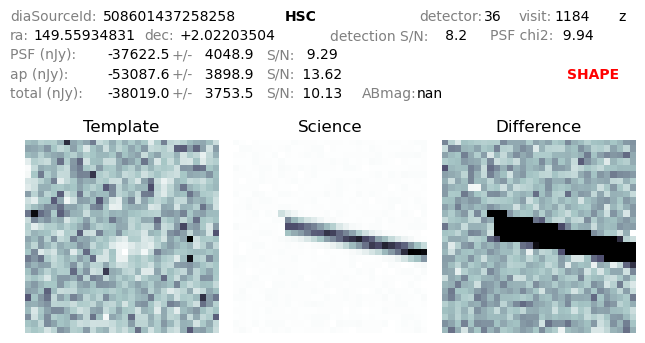

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.5593483056105+2.0220350355892602&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


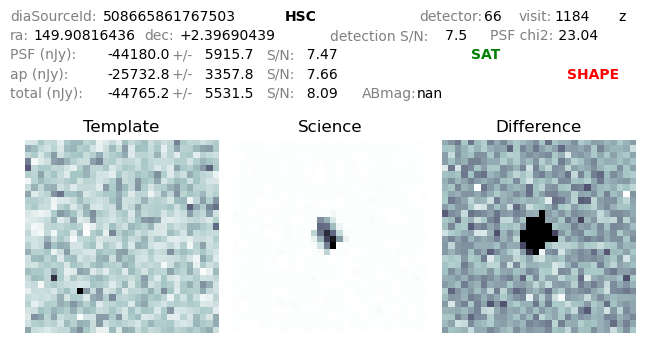

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.90816436063741+2.396904392449773&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


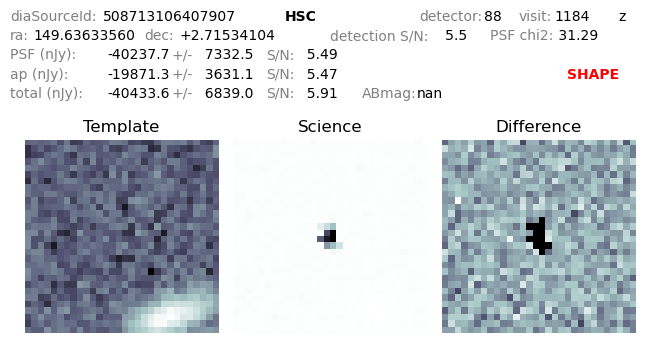

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.63633560184536+2.7153410439302035&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


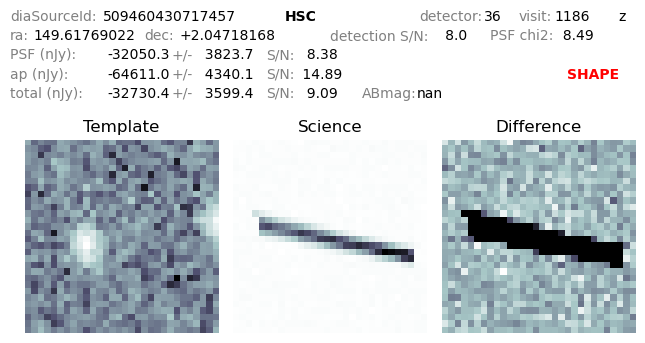

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6176902181534+2.0471816758761636&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


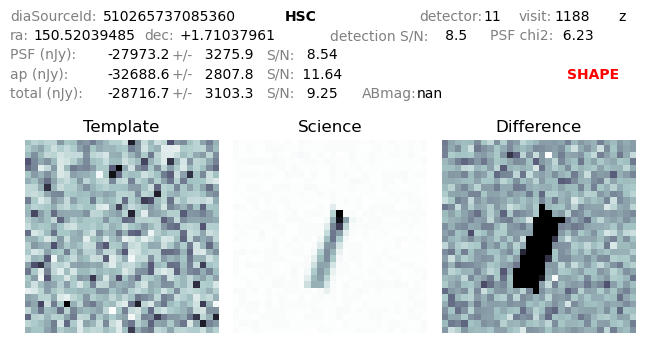

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.52039485000898+1.7103796108095324&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


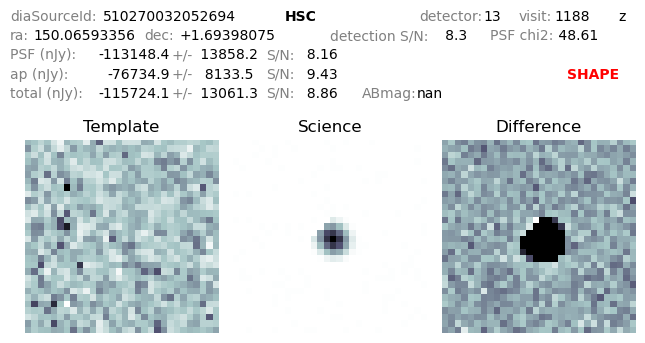

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.06593356484882+1.6939807489867023&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


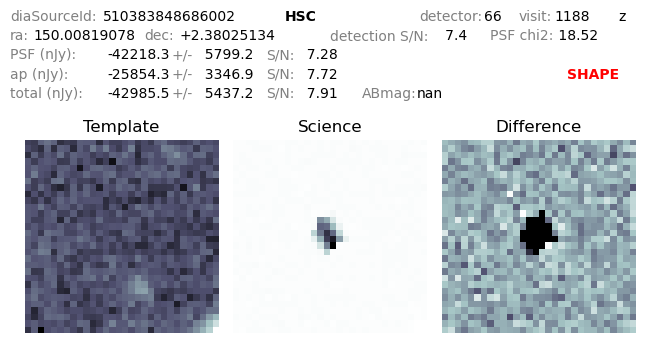

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.00819077878555+2.3802513388633924&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


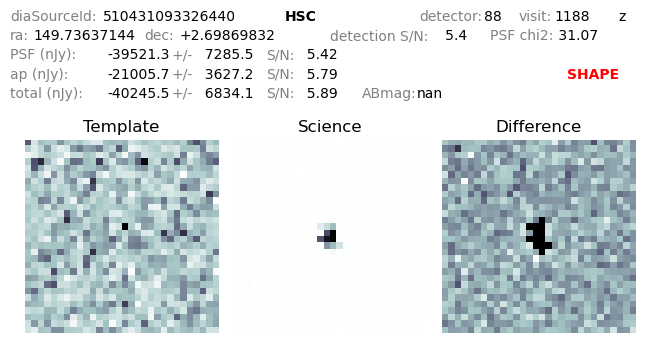

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.73637144036863+2.6986983165436977&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


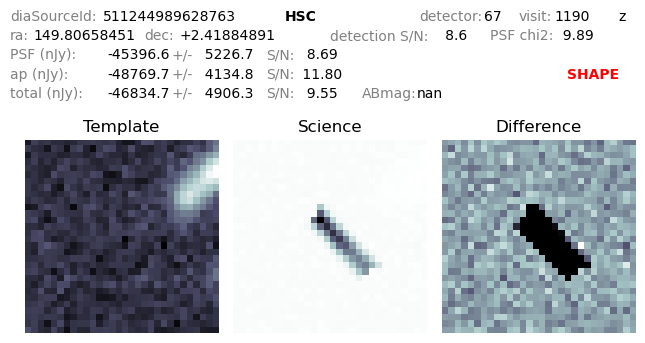

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.80658450562353+2.4188489108483124&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


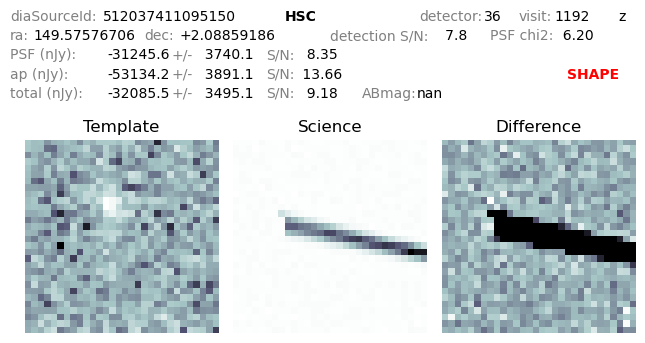

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.57576706190738+2.0885918615495624&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


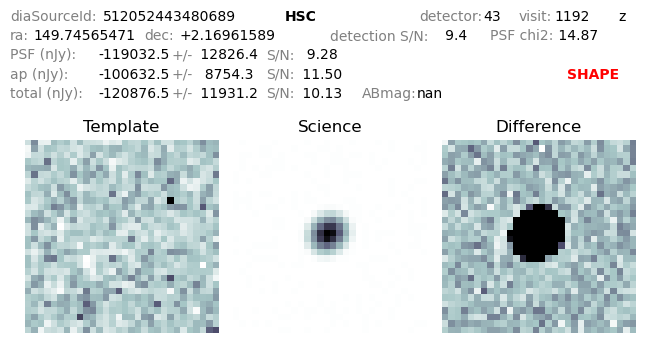

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.74565471191144+2.1696158933665646&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


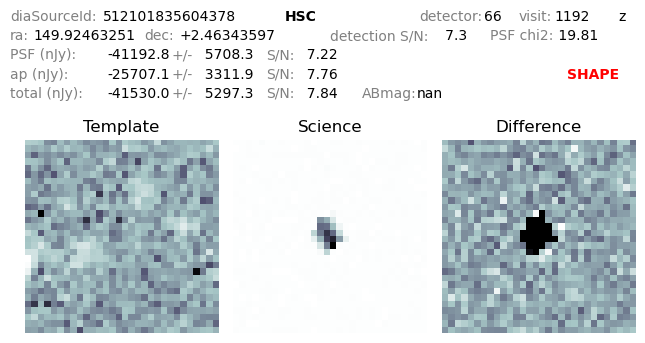

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9246325138625+2.463435972997305&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


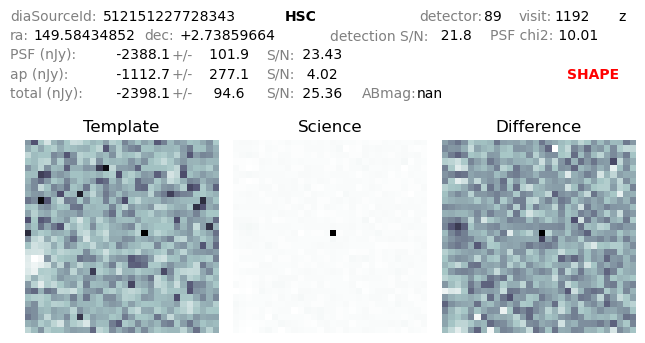

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.5843485199418+2.738596639648832&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


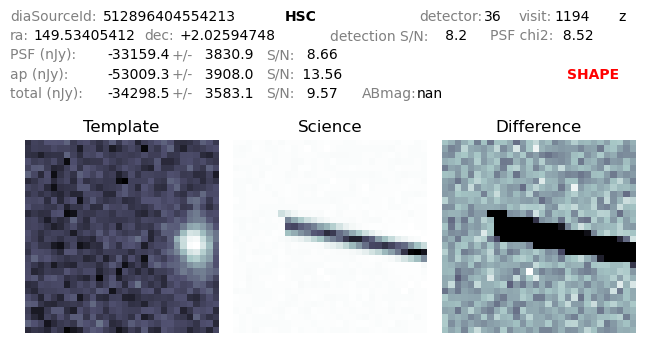

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.53405412211504+2.025947475976837&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


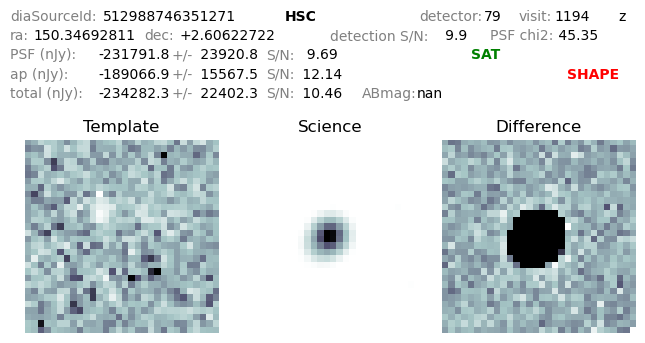

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.34692810736246+2.6062272230177537&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


In [14]:
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    single_path = path_manager(source['diaSourceId'])
    display(Image(single_path))
    make_simbad_link(source['ra'], source['decl'])
    print(source['trailLength'])

This section is looking at the negative sources with totalFlux less than -800 and a SNR greater than 8.0

In [69]:
filter_key=["isDipole", "totFlux", "totFlux", "snr"]
action_key=["bool", "ge", "le", "ge"]
value_key=[False, -800.0, 0, 8.0]

filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)

Length of filtered data: 7


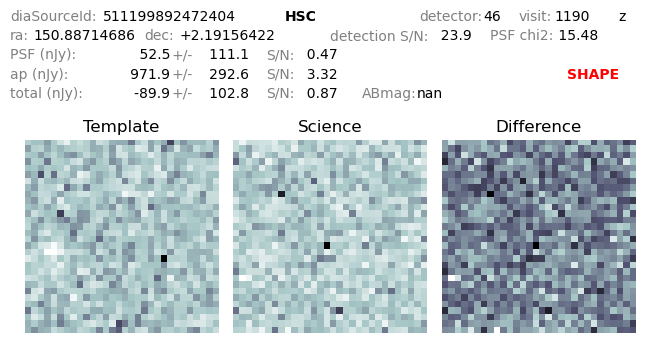

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.8871468605309+2.19156422087997&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


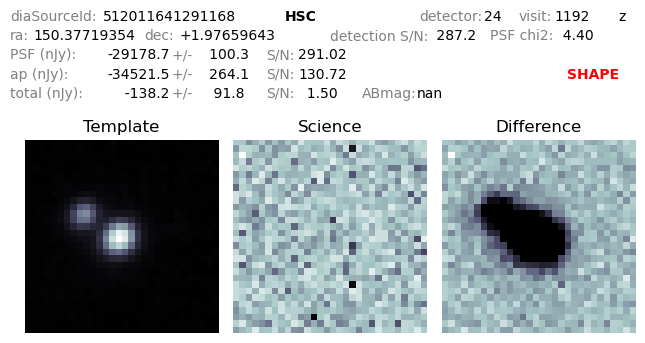

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3771935391013+1.9765964255970727&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


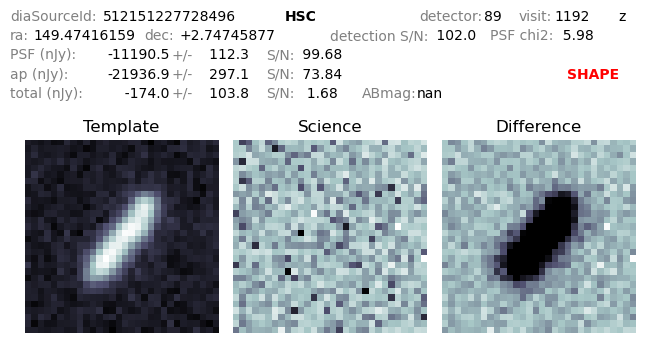

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.47416158701944+2.7474587748947026&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


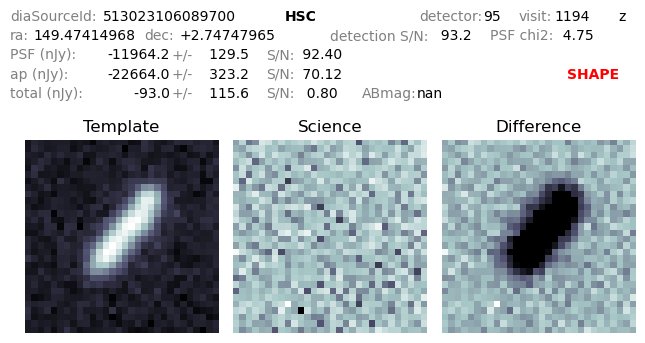

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.47414967905215+2.7474796457652686&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


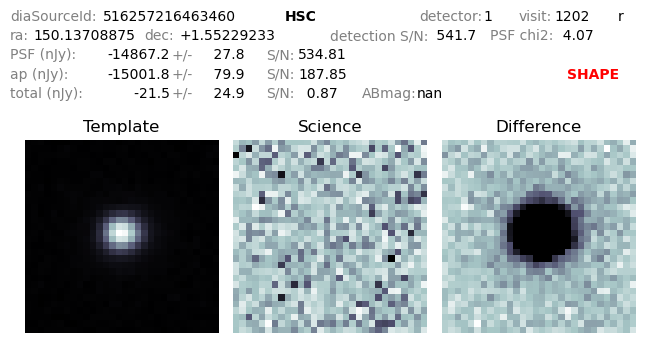

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.13708874540842+1.552292327480804&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


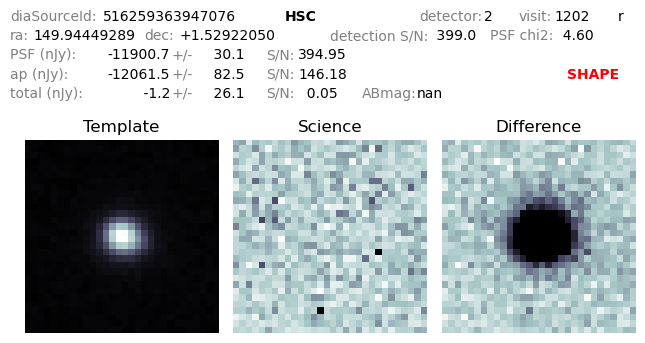

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9444928880133+1.529220497445968&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


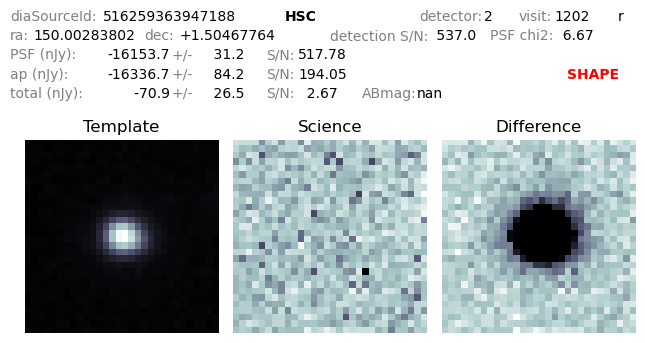

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.0028380232019+1.5046776424946011&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


In [70]:
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    single_path = path_manager(source['diaSourceId'])
    display(Image(single_path))
    make_simbad_link(source['ra'], source['decl'])
    print(source['trailLength'])

## Non-Dipole negative sources with SNR < 8.0

Here we look at non dipole sources with a flux between -800 and 0 with a snr less than 8.0. In general it seems like these are bad sources with some sort of bleed from the detector. Out of 10,000 sources, 13 met this criteria.

In [67]:
filter_key=["isDipole", "totFlux", "totFlux", "snr"]
action_key=["bool", "ge", "le", "le"]
value_key=[False, -800.0, 0, 8.0]
filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)

Length of filtered data: 13


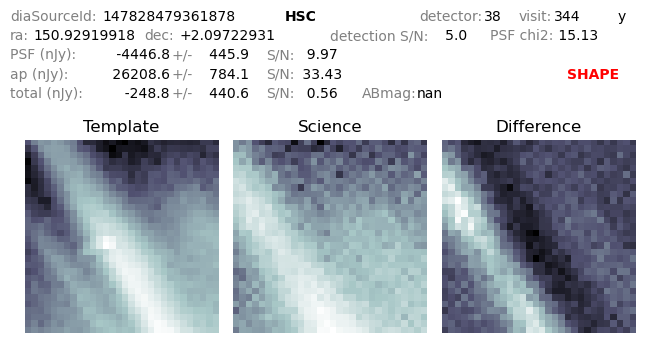

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.92919918148473+2.0972293059747327&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


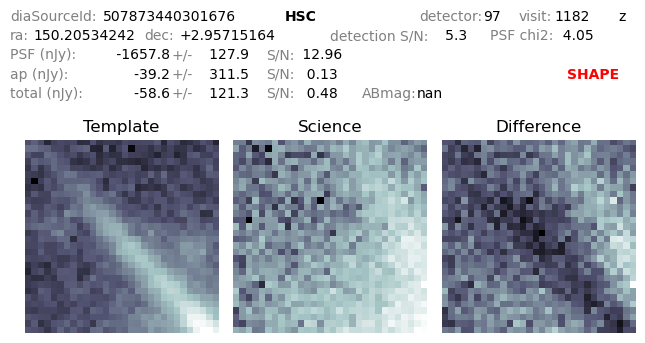

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.20534242491394+2.95715164342854&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


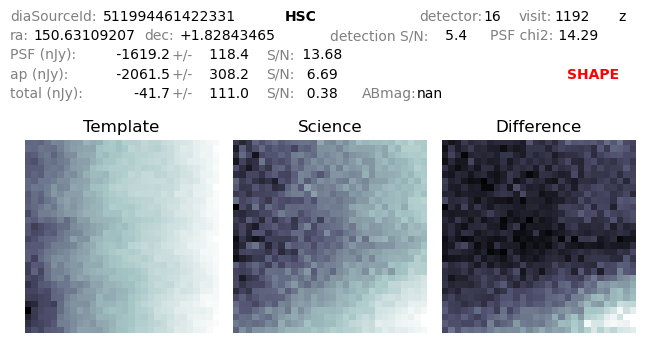

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63109207327895+1.8284346544562236&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


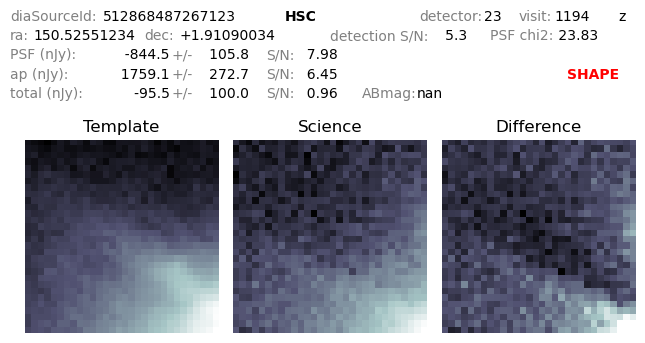

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.52551234042727+1.9109003430157525&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


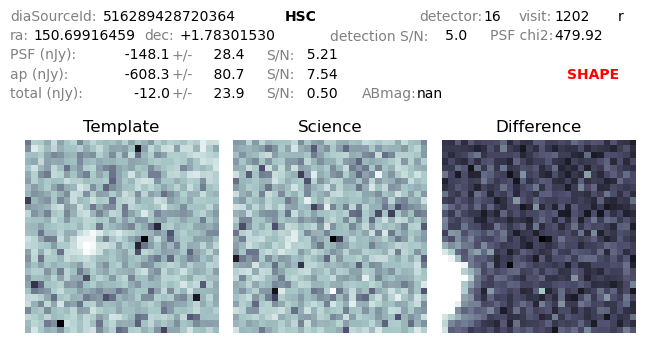

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69916459014672+1.783015300105343&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


In [68]:
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if abs(source["totFlux"]/source["totFluxErr"]) <= 1.0:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])

## Sources where various flux/FluxErr <= 4.0

Length of filtered data: 131


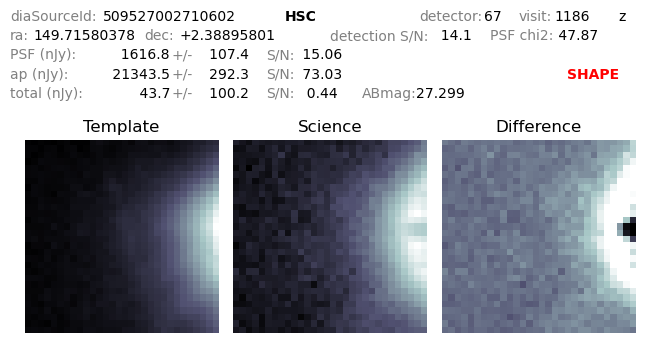

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.71580378375612+2.3889580130467976&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


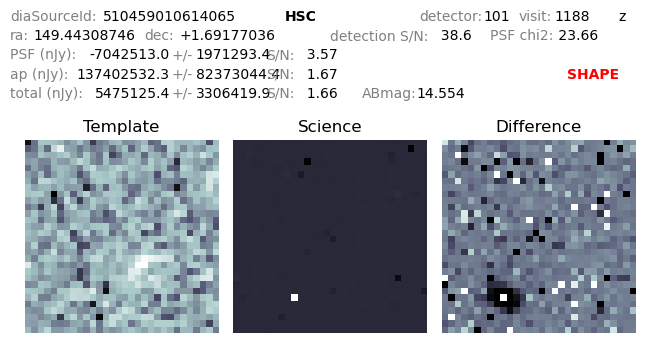

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4430874627304+1.691770355676727&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


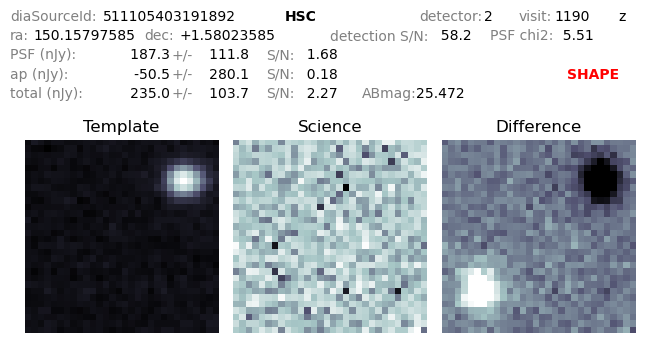

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15797585383777+1.5802358481942684&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4549044201069525


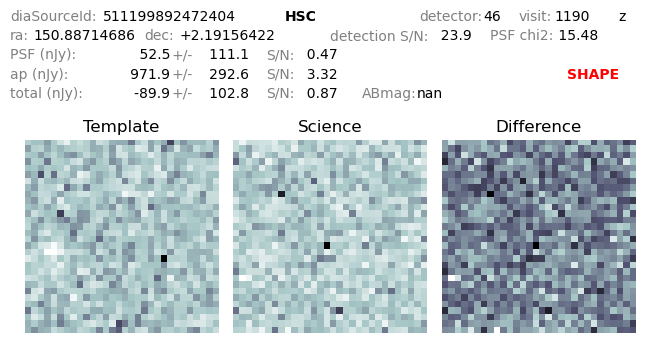

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.8871468605309+2.19156422087997&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


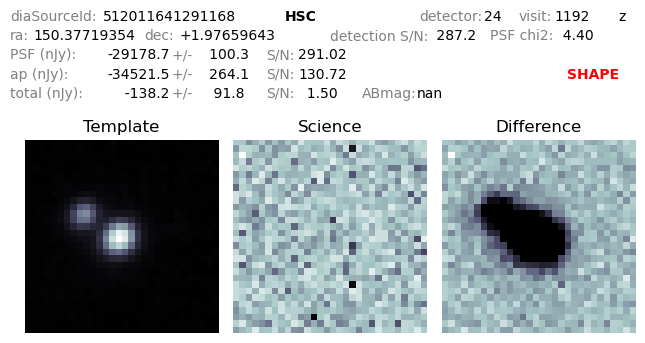

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3771935391013+1.9765964255970727&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


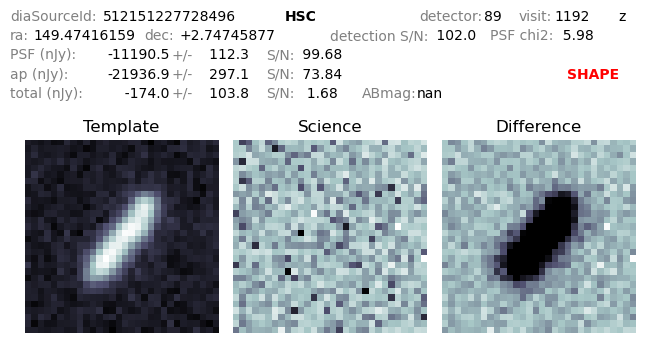

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.47416158701944+2.7474587748947026&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


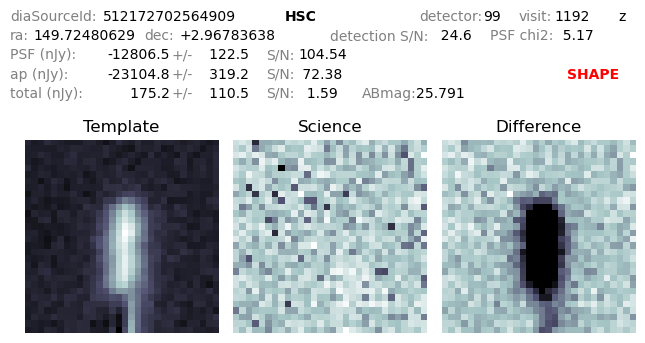

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.72480629228994+2.967836378329485&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


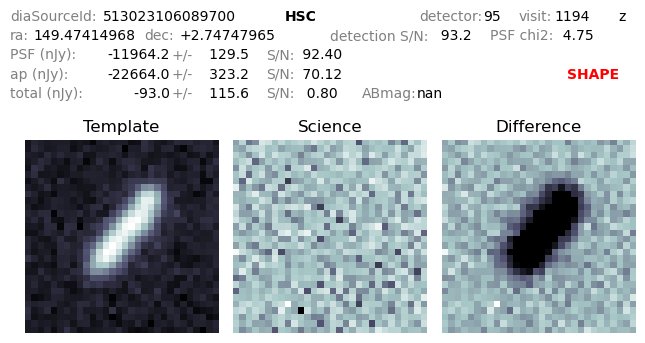

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.47414967905215+2.7474796457652686&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


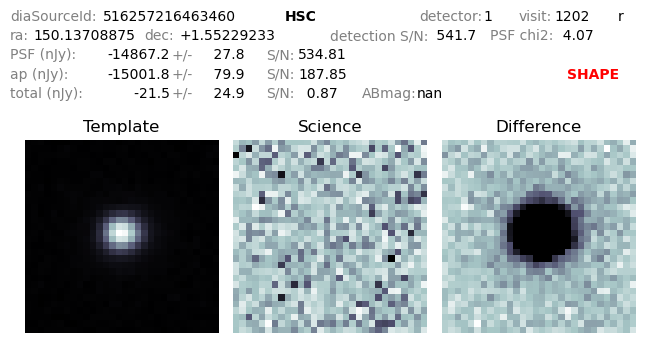

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.13708874540842+1.552292327480804&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


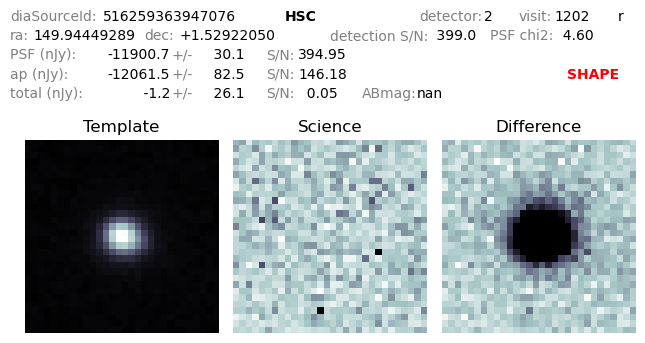

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9444928880133+1.529220497445968&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


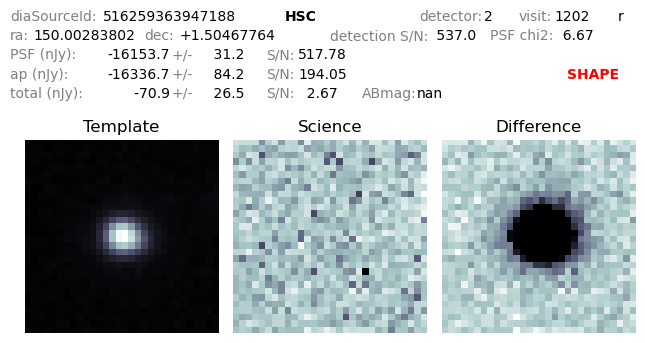

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.0028380232019+1.5046776424946011&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


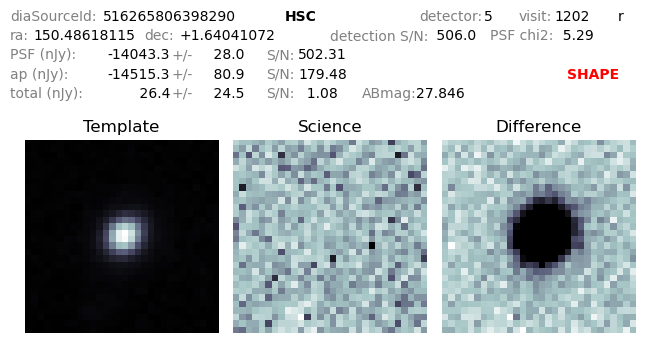

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.48618115289332+1.6404107235686667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


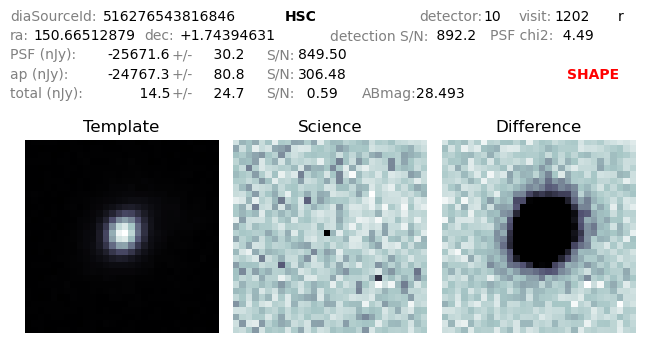

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.66512878973163+1.7439463079211224&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


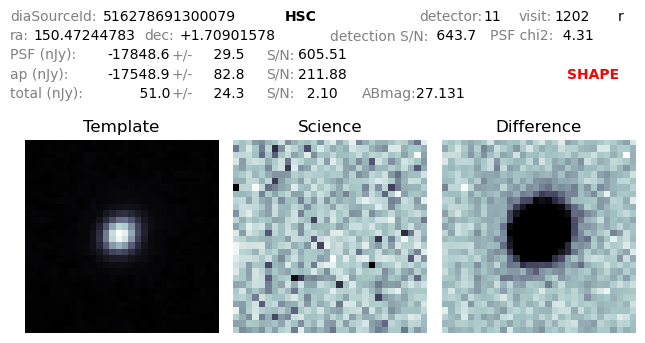

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4724478339106+1.7090157772019396&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


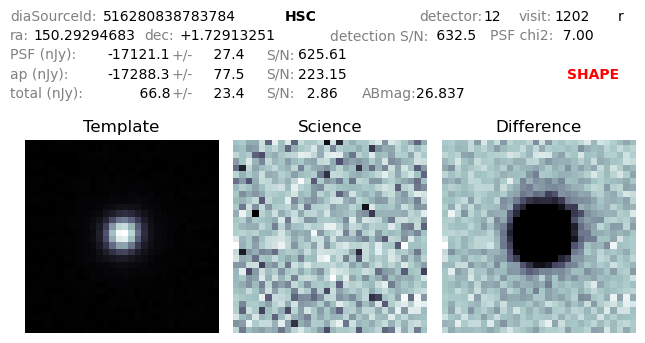

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2929468284317+1.7291325107460267&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


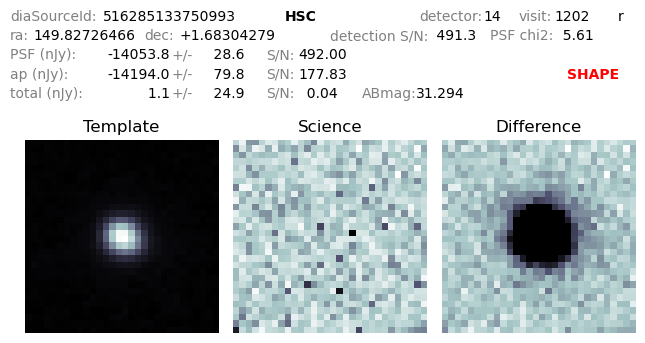

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.82726465787013+1.6830427885412143&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


In [85]:
filter_key=["isDipole", "snr"]
action_key=["bool", "ge"]
value_key=[False, 8.0]

filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if abs(source["totFlux"]/source["totFluxErr"]) <= 4.0:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])

(array([114.,  10.,   2.,   2.,   1.,   1.,   0.,   0.,   0.,   1.]),
 array([  4.01532291,  59.60074407, 115.18616523, 170.77158639,
        226.35700755, 281.94242871, 337.52784987, 393.11327103,
        448.69869218, 504.28411334, 559.8695345 ]),
 <BarContainer object of 10 artists>)

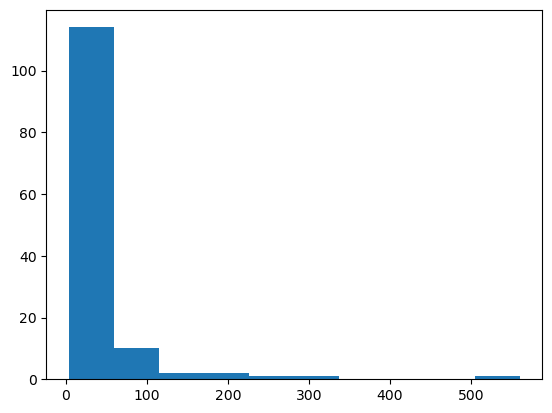

In [77]:
plt.hist(filteredData['psChi2']/filteredData["psNdata"])

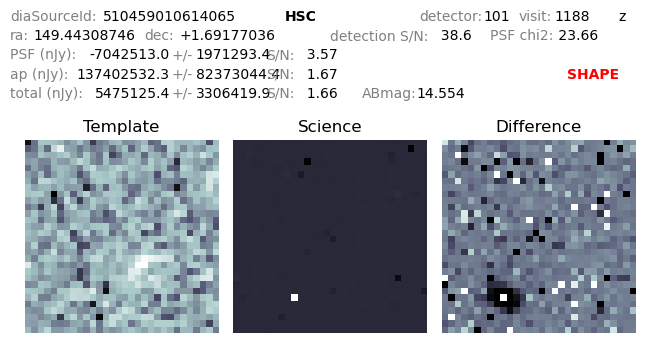

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4430874627304+1.691770355676727&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan
-7042513.04704095
1971293.3729947864


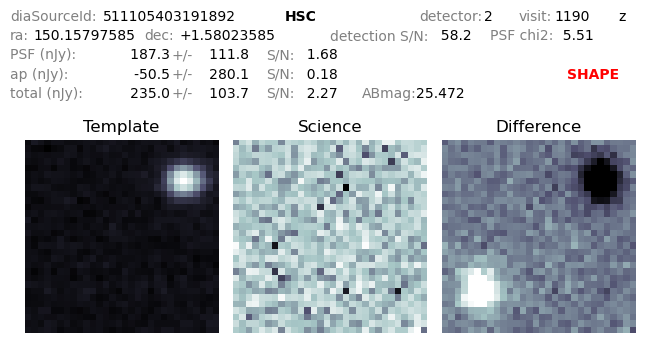

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15797585383777+1.5802358481942684&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4549044201069525
187.32718487659
111.80579441208445


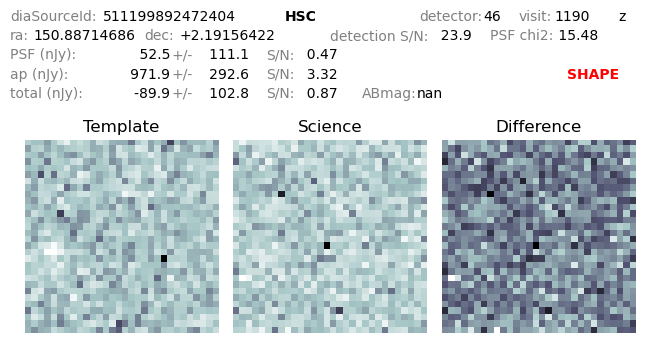

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.8871468605309+2.19156422087997&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan
52.516187576522356
111.06977288281841


In [83]:
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if abs(source["psFlux"]/source["psFluxErr"]) <= 4.0:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])
        print(source['psFlux'])
        print(source['psFluxErr'])

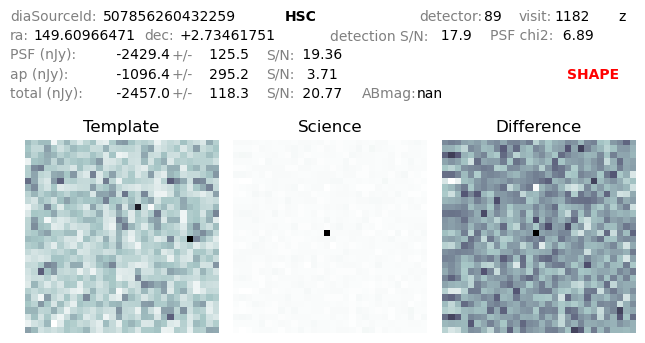

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.60966470837462+2.734617509825219&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


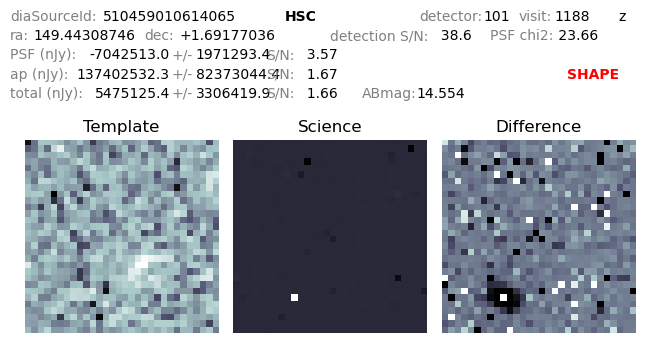

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4430874627304+1.691770355676727&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


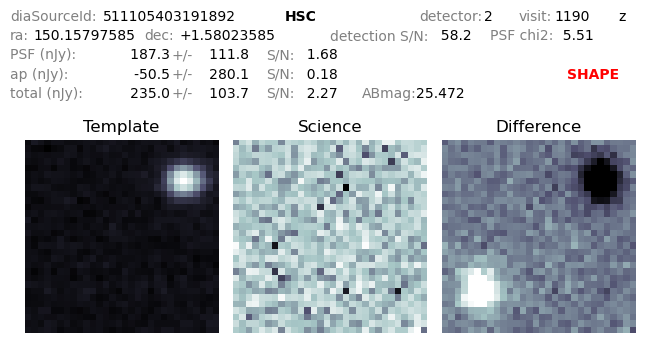

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15797585383777+1.5802358481942684&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4549044201069525


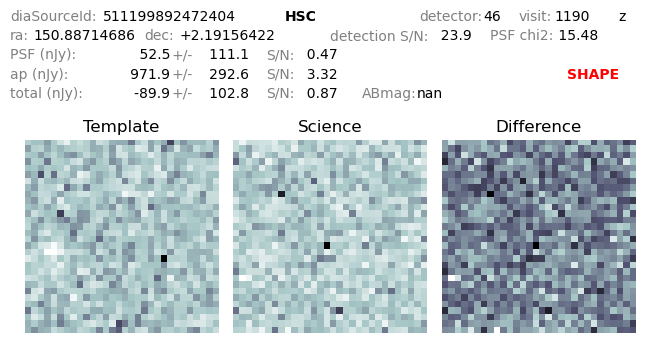

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.8871468605309+2.19156422087997&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


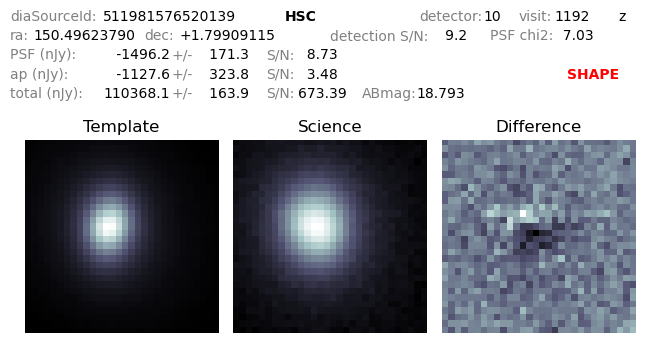

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.49623790326845+1.7990911524645676&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


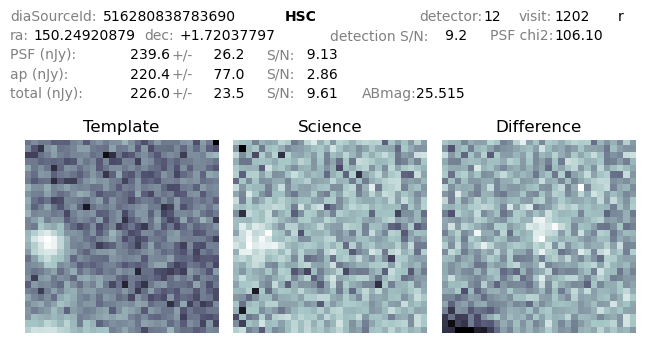

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2492087877263+1.7203779703912938&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6226175073461835


In [84]:
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if abs(source["apFlux"]/source["apFluxErr"]) <= 4.0:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])

## Sources with Dipoles and dipChi2 > 30000

In [62]:
filter_key=["isDipole", "totFlux"]
action_key=["bool", "ge"]
value_key=[True, 0.0]

filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)

Length of filtered data: 153


Looking at the isDipole flag, there are a number of bad sources, but it is hard to seperate them out. Looking at sources with a reduced chi^2 over 2 and a dipChi2 over 30000 does seem to help. It's possiblle that these dipoles should be looked at to see if they are genuine dipoles or something else is going on with the psf.

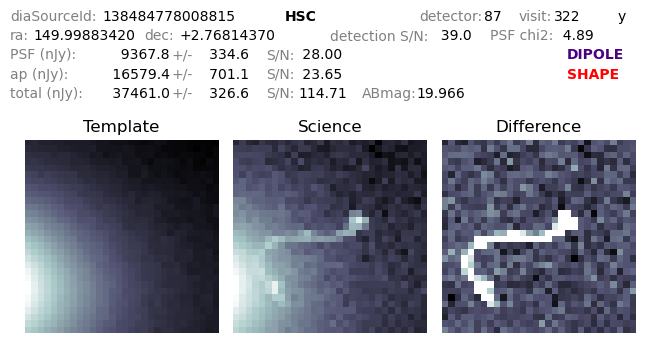

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9988341972046+2.7681437005570375&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.41608735277056


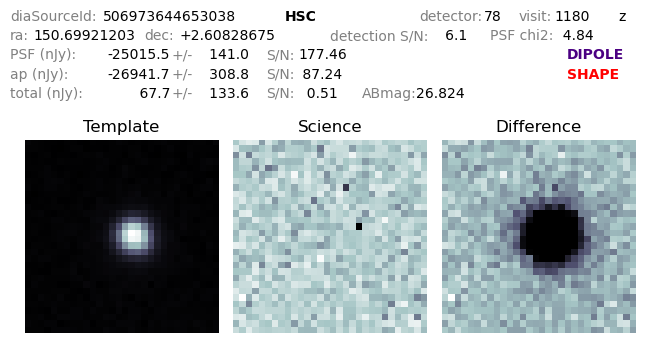

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69921202669636+2.6082867475156206&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


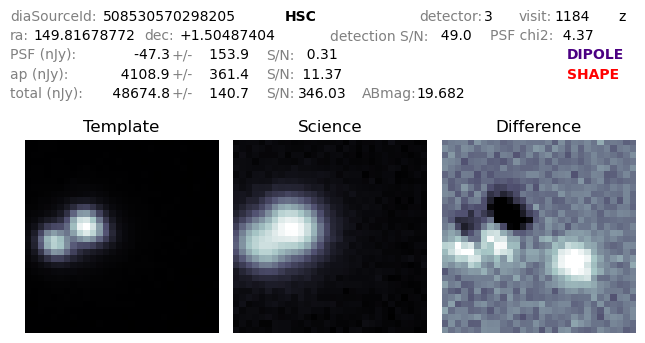

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.81678771746763+1.5048740386124633&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


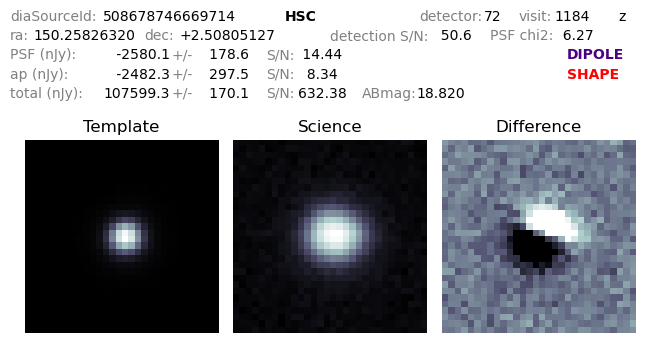

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.25826319854292+2.5080512749154393&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


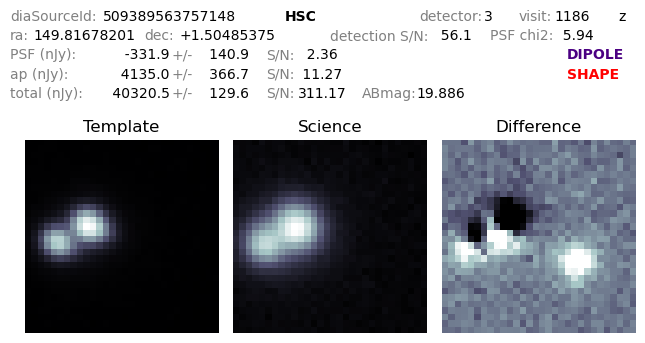

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8167820130452+1.5048537487521703&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


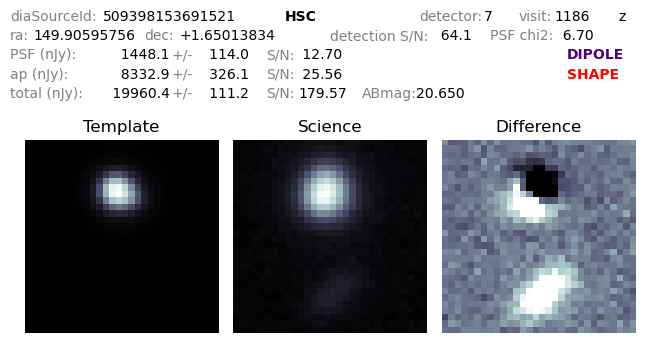

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9059575581529+1.6501383412831045&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.1280627956751508


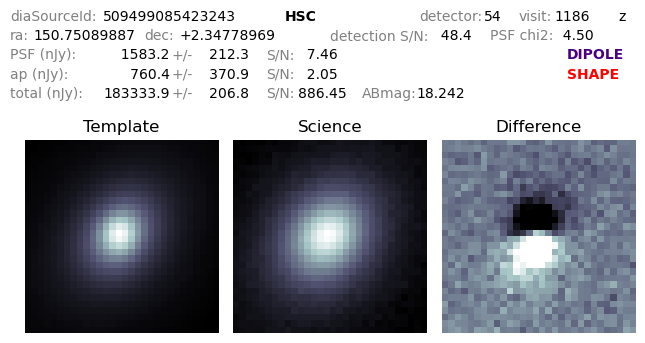

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.7508988657607+2.3477896881692524&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.2928673445276082


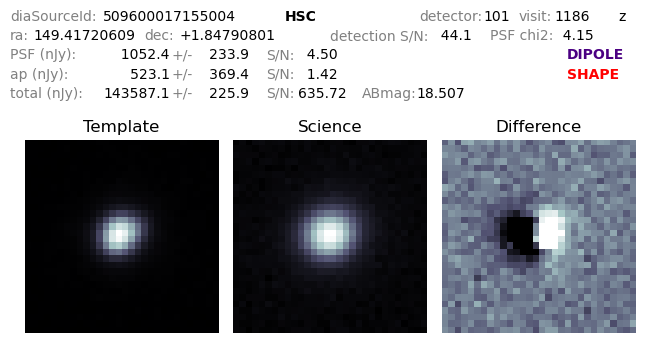

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4172060887403+1.8479080133316972&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


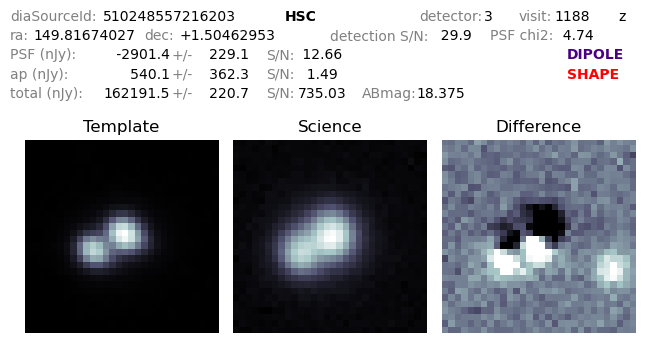

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.81674026652038+1.5046295346372267&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


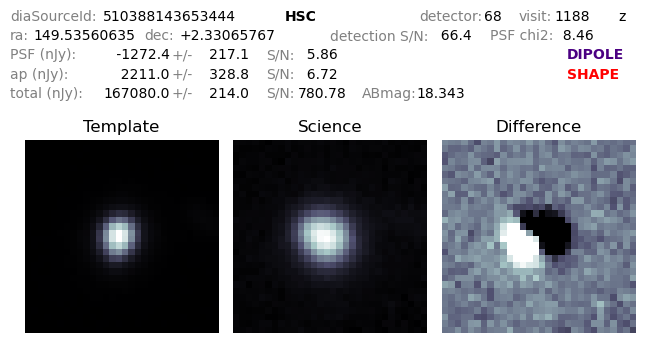

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.53560634862464+2.3306576692869156&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


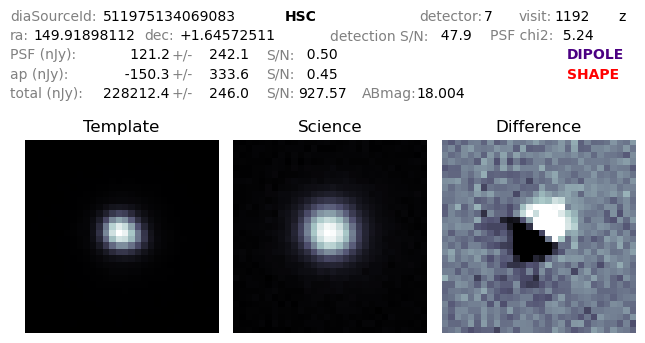

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.91898112159012+1.645725110053762&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


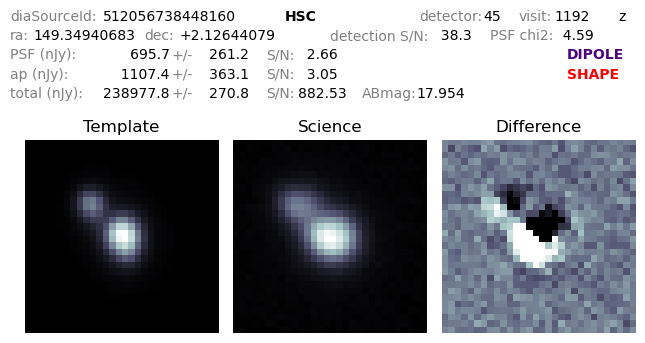

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.34940683241484+2.1264407927418096&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


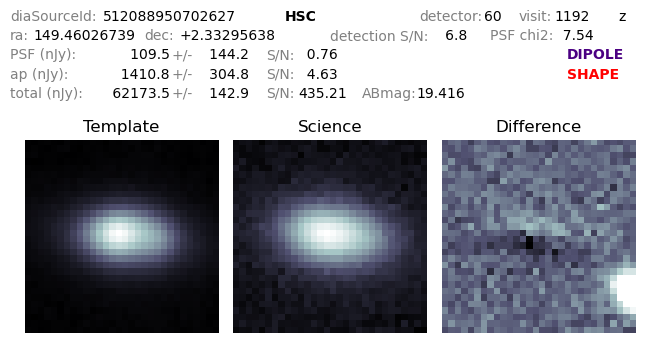

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.46026739178507+2.3329563788387864&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


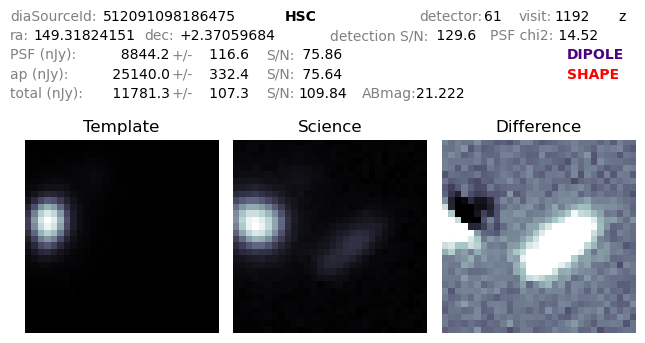

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.3182415143031+2.370596843848895&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


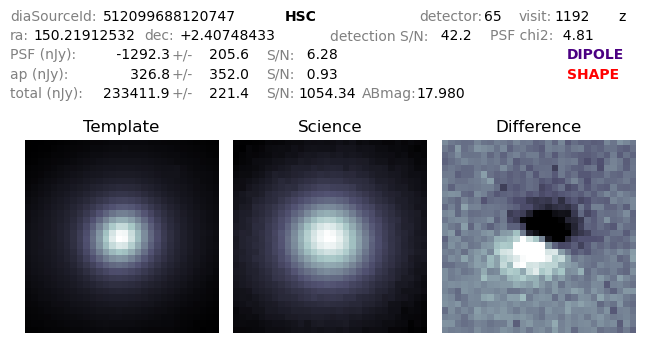

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.21912531718812+2.407484333787901&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


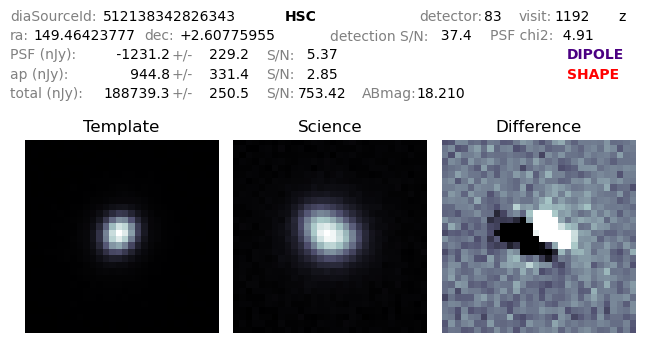

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.46423776898038+2.607759545664726&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


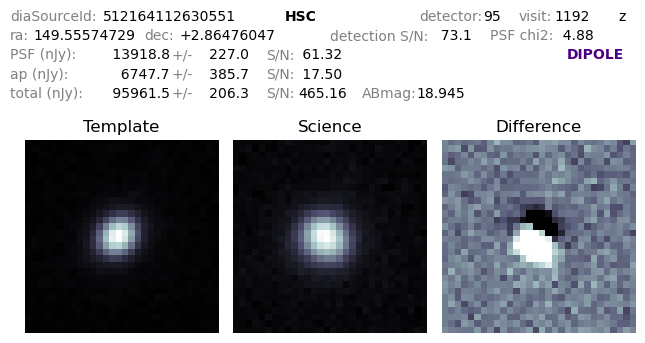

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.55574728605947+2.864760468553271&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5662444695226789


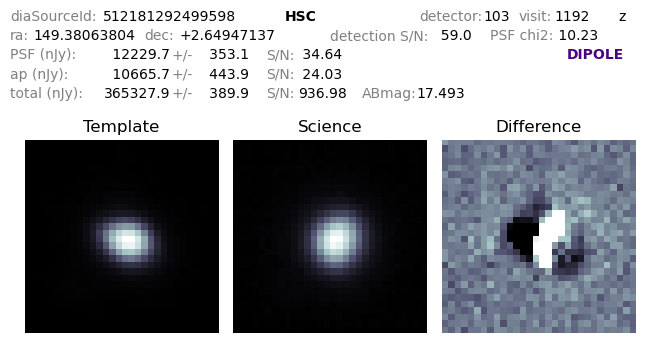

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.38063803951724+2.6494713747219985&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6179686656333141


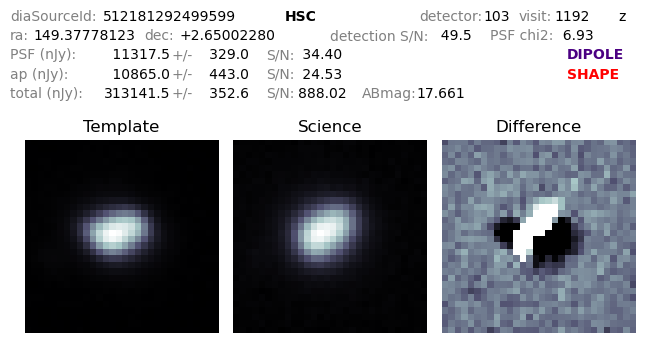

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.37778123463818+2.6500228034430378&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


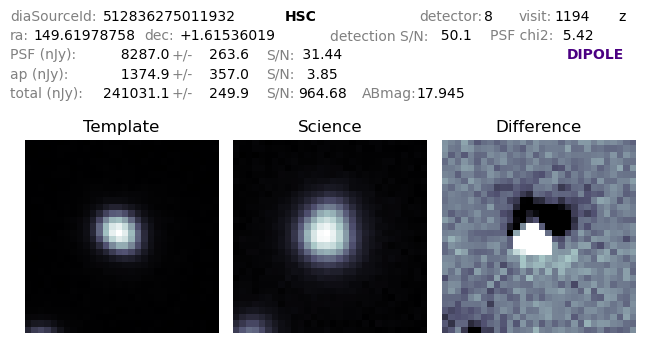

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.61978758355588+1.6153601876886825&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.43579297065649353


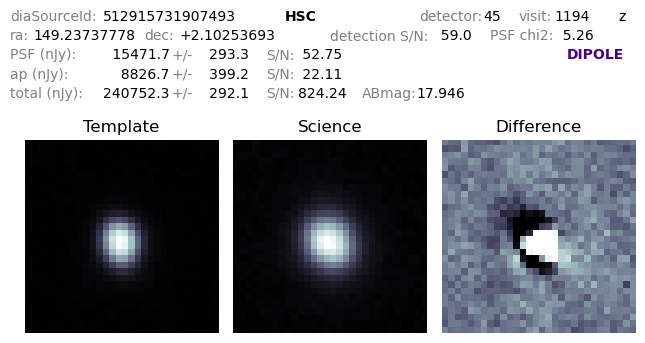

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.2373777783492+2.102536926887037&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.38363400950902155


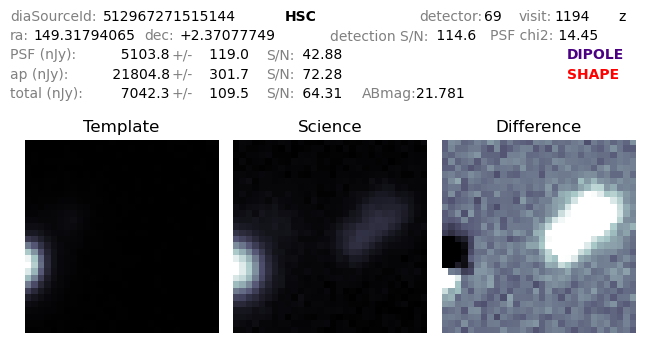

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.31794065450057+2.370777491493932&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.611132528648044


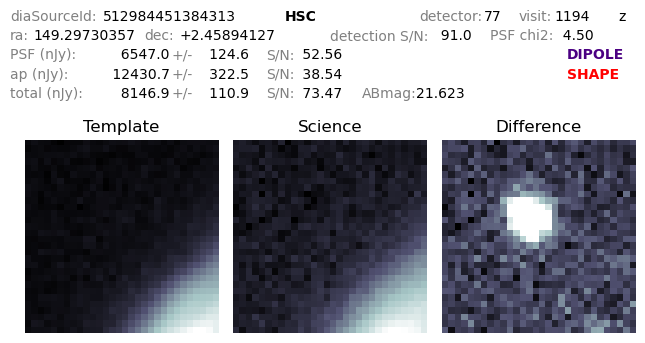

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.29730357419734+2.4589412687602805&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.635948075880731


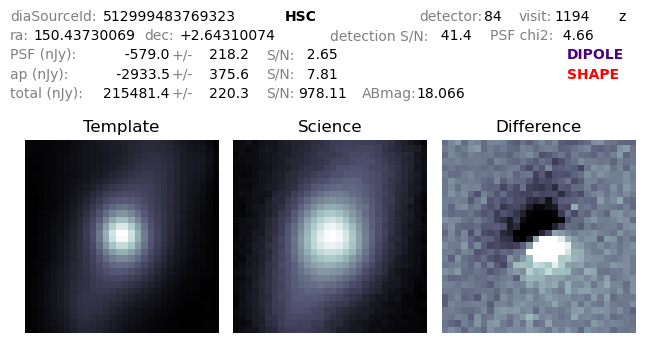

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.43730068713987+2.643100744561909&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


In [63]:
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if source["dipChi2"] >= 30000:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])

## Sources with Dipoles and dipChi2 < 30000

Seperating out the dipoles to thpse woth a dipChi2 less than 30000 doesn't obviously show any sources or patterns for bad dipoles, but there are a number of bad sources mixed in.

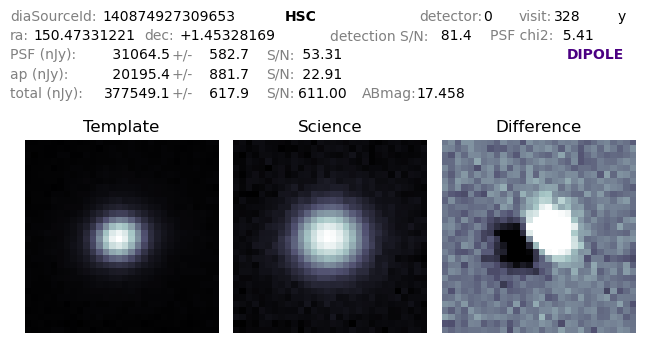

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4733122133146+1.4532816899565544&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.7014187048188759


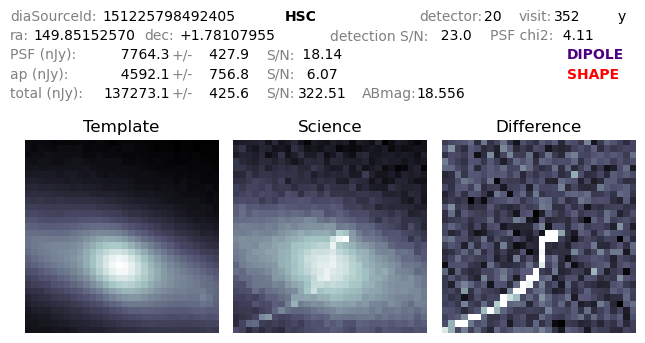

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8515256974489+1.7810795455845587&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


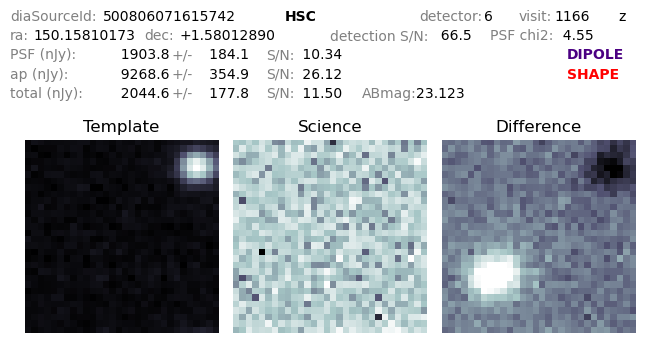

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15810173409648+1.5801288986858655&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0770292712049354


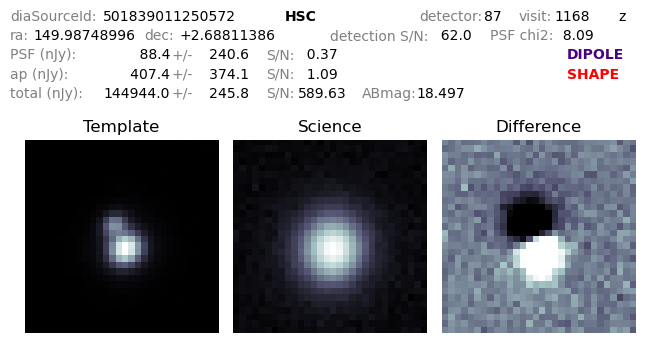

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98748995891373+2.6881138600132815&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


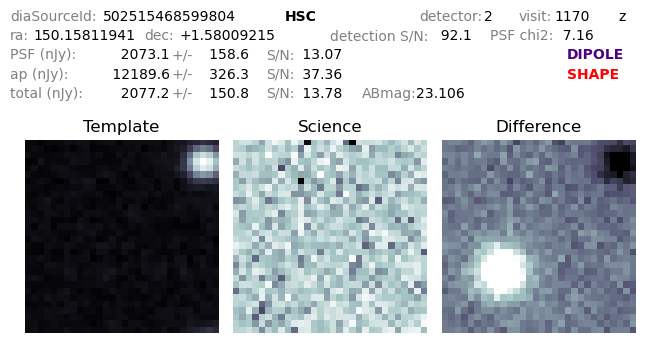

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15811941171629+1.5800921541056985&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.299911130745255


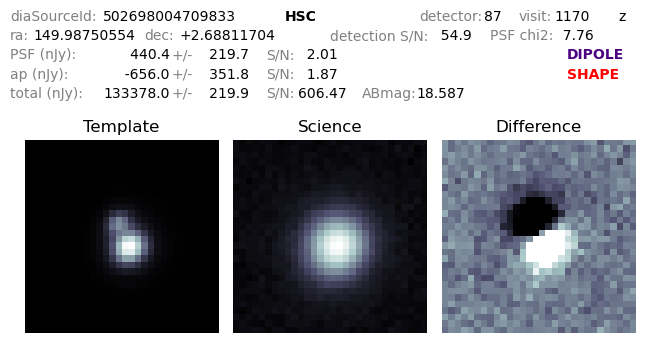

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9875055375544+2.6881170394630645&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


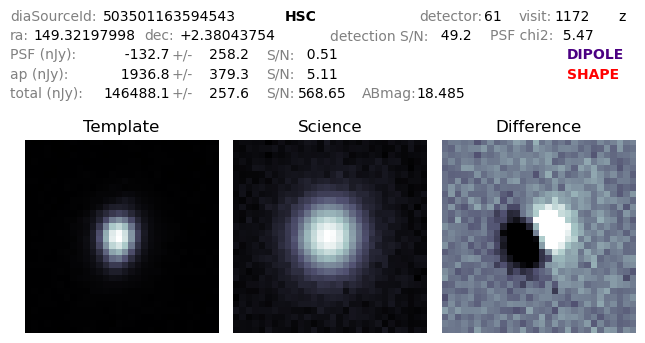

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.32197997715454+2.3804375357450813&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


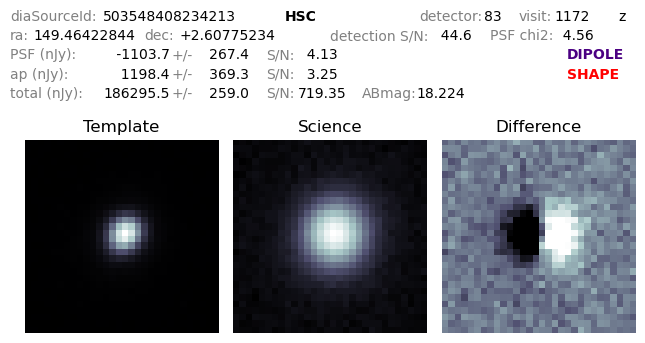

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.46422844357735+2.607752339623933&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


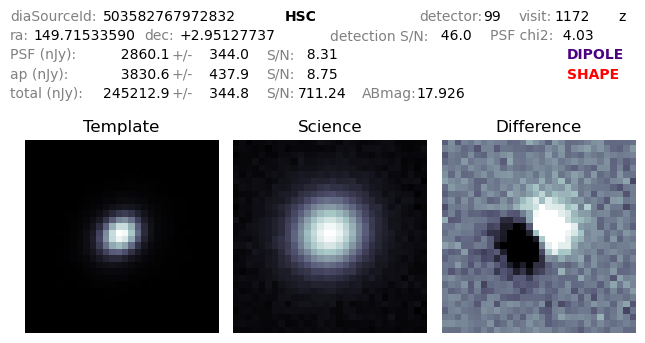

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7153358979708+2.9512773708407507&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.5601344517110856


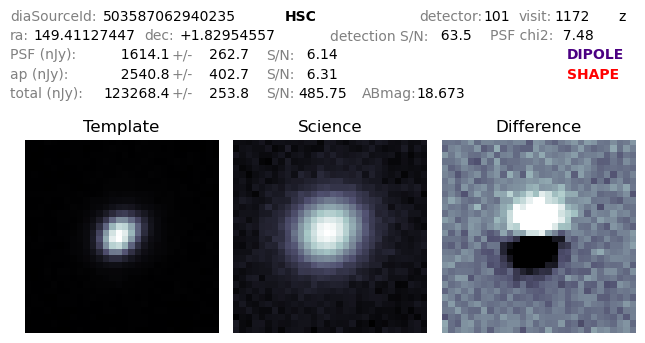

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.41127447031138+1.8295455702544965&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


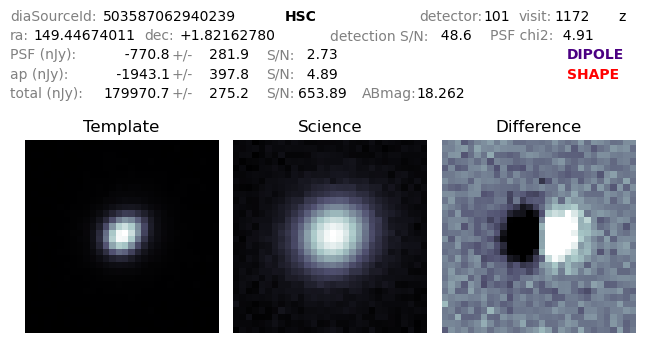

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.44674010688522+1.821627796831706&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


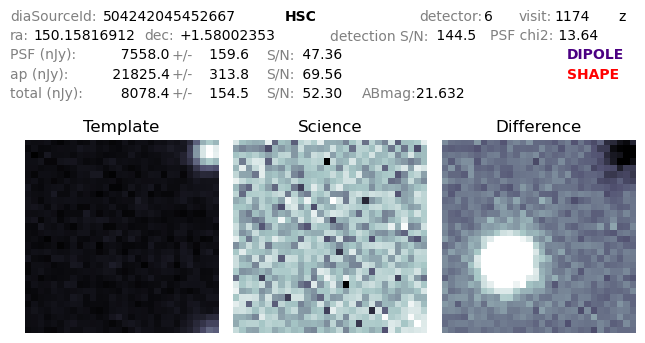

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.1581691237374+1.5800235257100654&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.3323866661212227


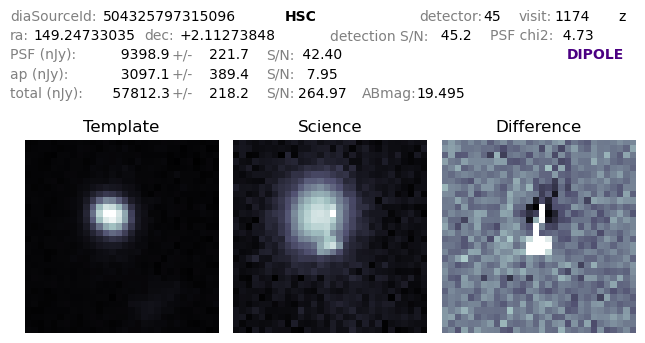

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.2473303515684+2.112738484655889&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0064259252742813


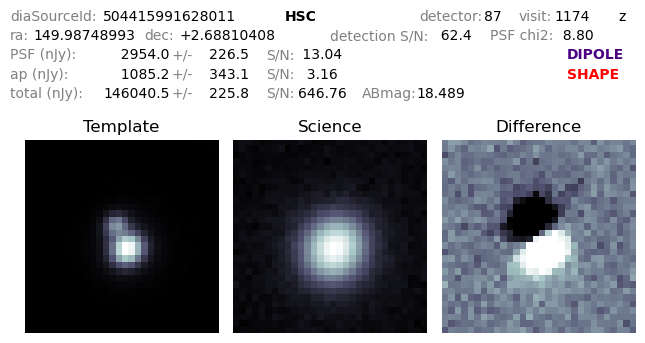

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9874899324465+2.6881040823350757&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.7789715117135039


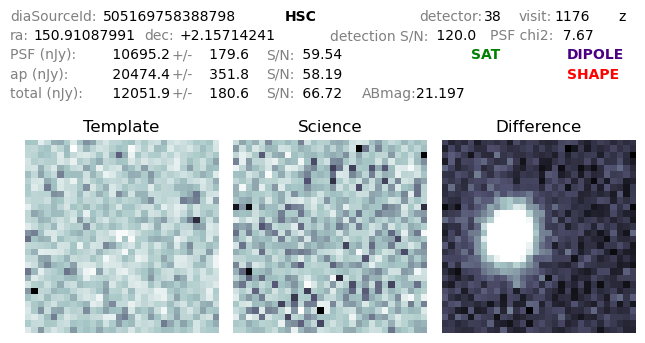

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.9108799134127+2.157142405038112&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


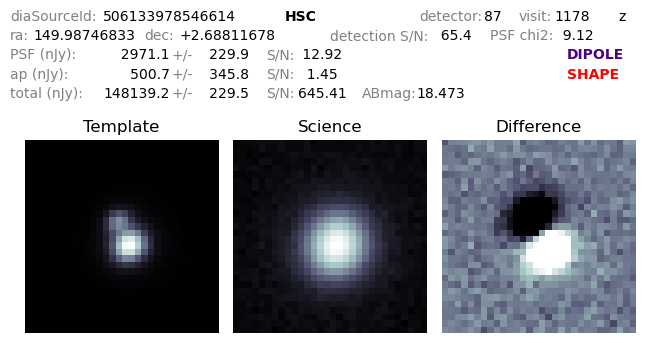

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98746832961018+2.6881167813584392&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.0972078165586154


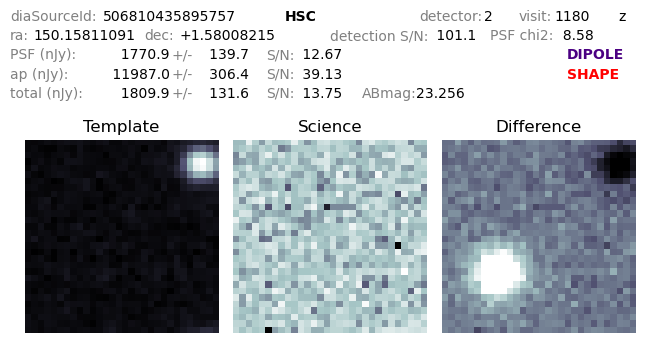

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.1581109121138+1.5800821485666505&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.7799706129300374


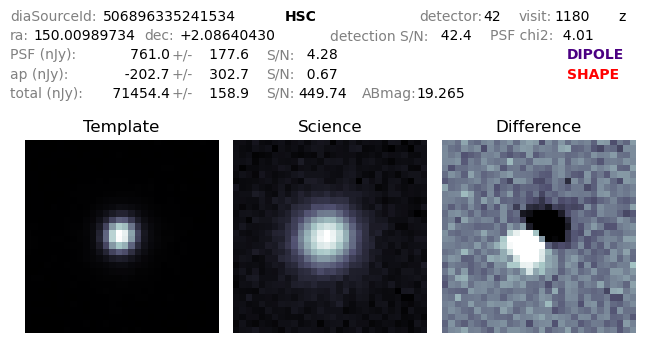

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.00989734440117+2.086404301294175&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


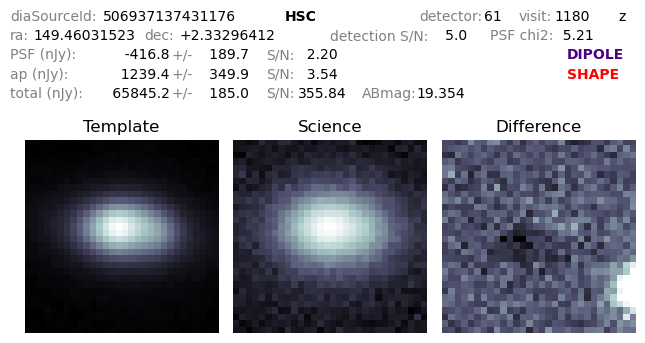

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.46031522804918+2.3329641174440106&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


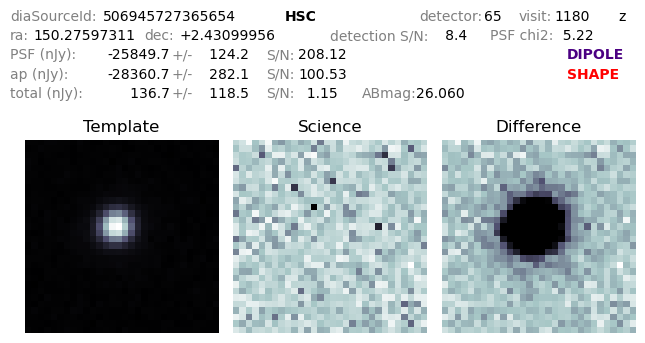

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2759731078485+2.430999562146463&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


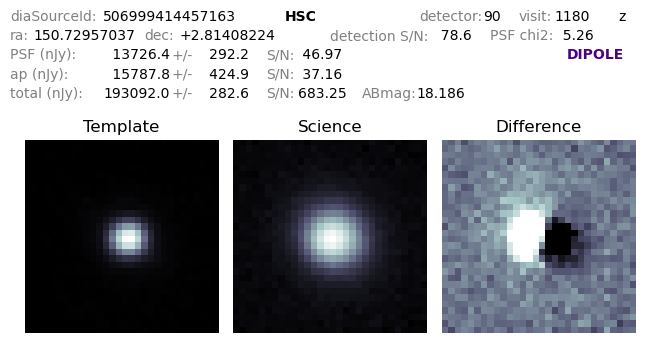

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.7295703657092+2.8140822392058773&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.9726039027868879


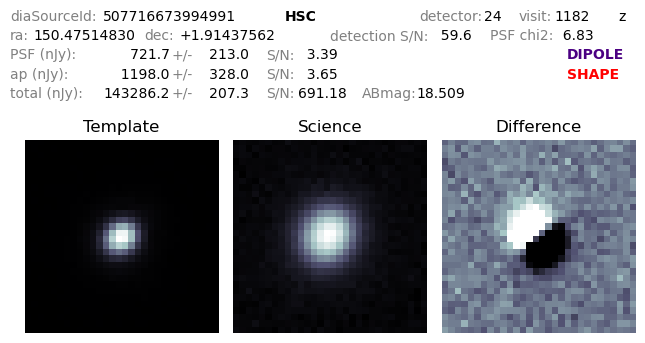

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.47514829756292+1.9143756159003715&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


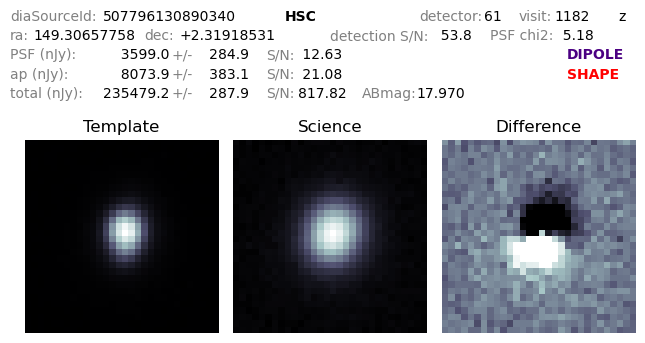

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.3065775781917+2.319185314639633&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.7823919893761166


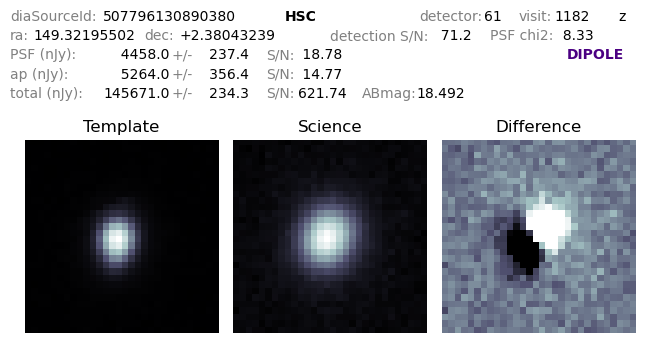

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.3219550203478+2.3804323892140107&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5380286798956456


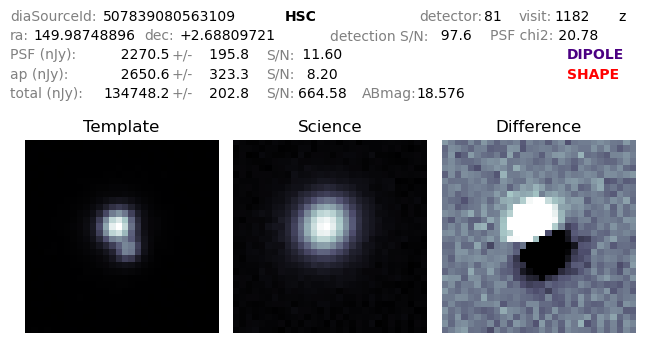

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98748895535888+2.68809721150431&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.3426087318700248


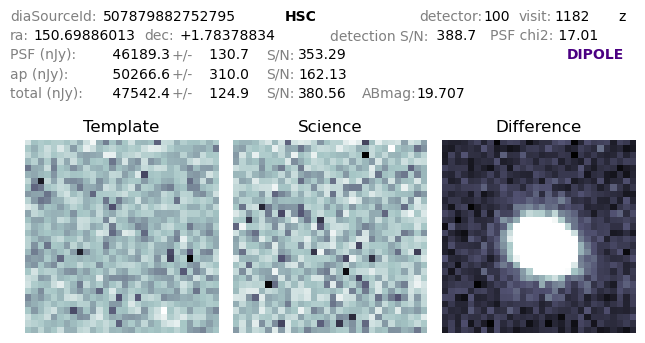

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69886013374372+1.7837883390760023&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.9793187030211304


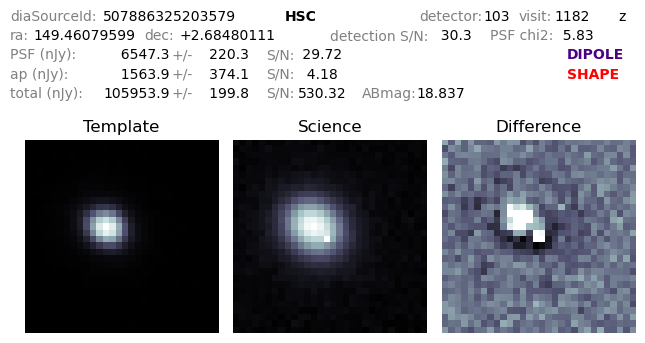

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.46079598542786+2.6848011134378966&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.047243335731877


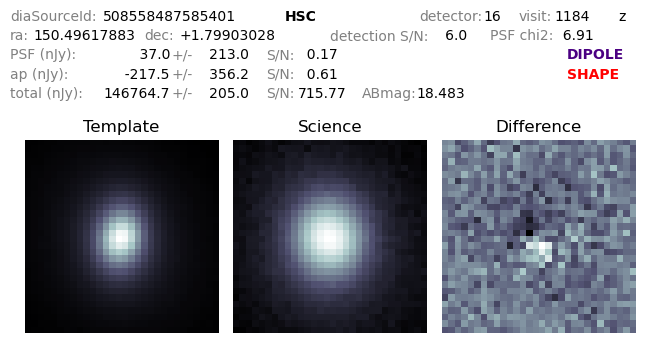

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4961788347106+1.799030276587372&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


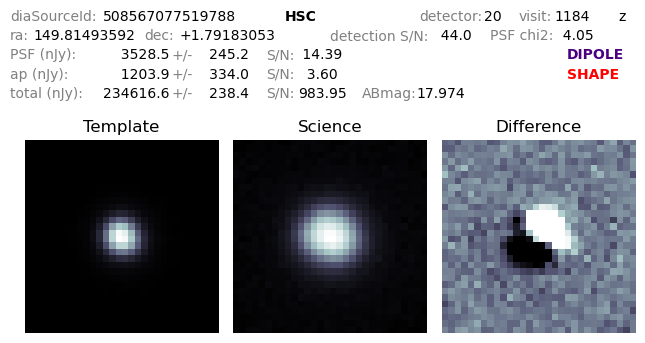

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.81493592130917+1.7918305250031543&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.0330042303176616


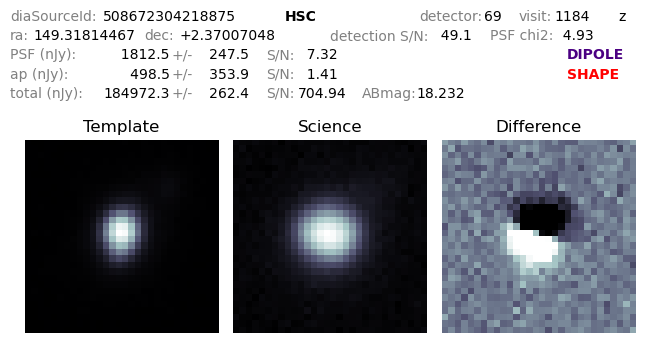

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.31814467465995+2.370070484560067&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


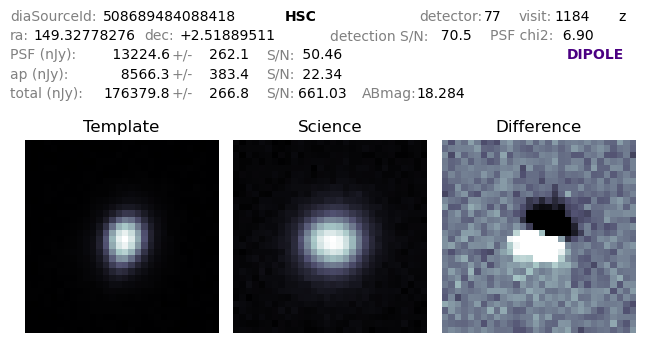

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.32778276061651+2.518895107487818&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.7705405311702032


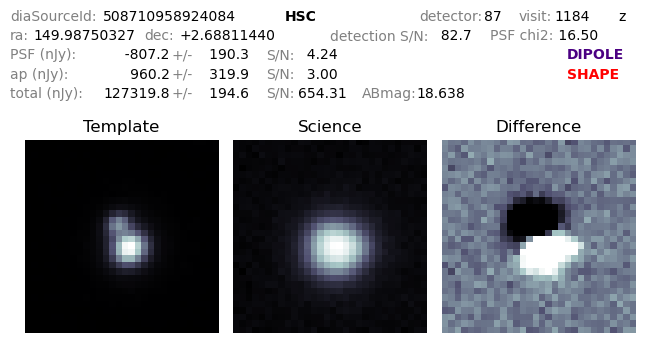

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98750327269005+2.688114396378038&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


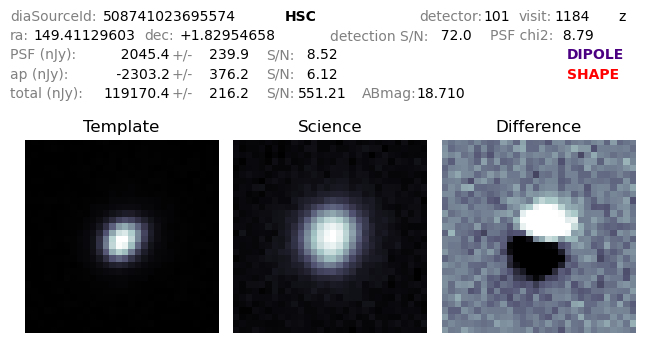

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.41129602984822+1.829546581368121&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


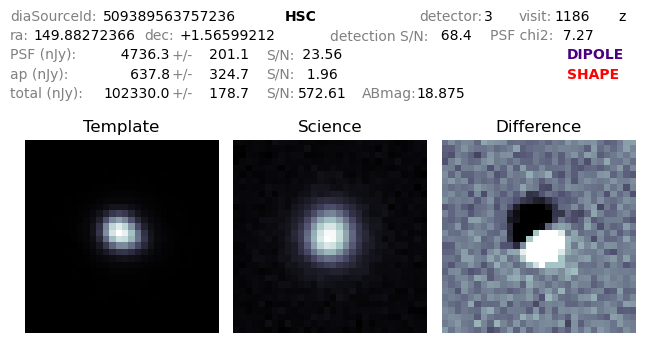

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.88272366218743+1.5659921176926668&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.7732617666771777


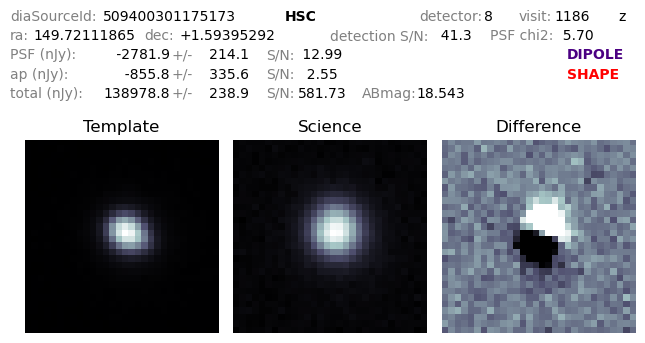

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7211186450383+1.5939529210639216&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


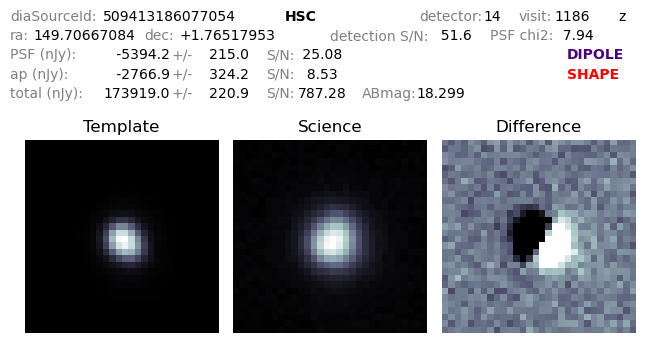

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.70667083706897+1.765179534894416&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


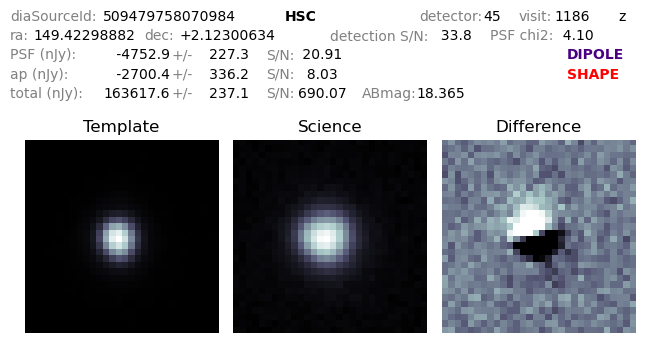

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.42298882486216+2.1230063372088277&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


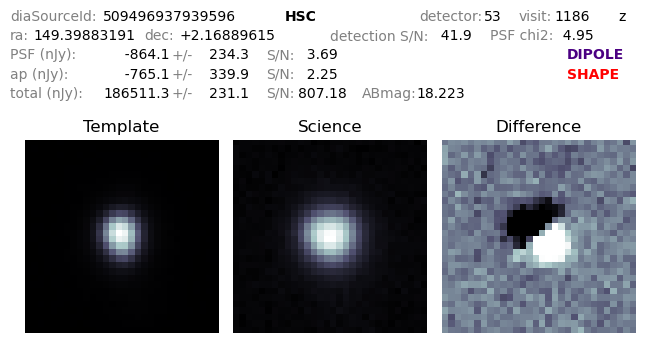

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.3988319098233+2.1688961457083433&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


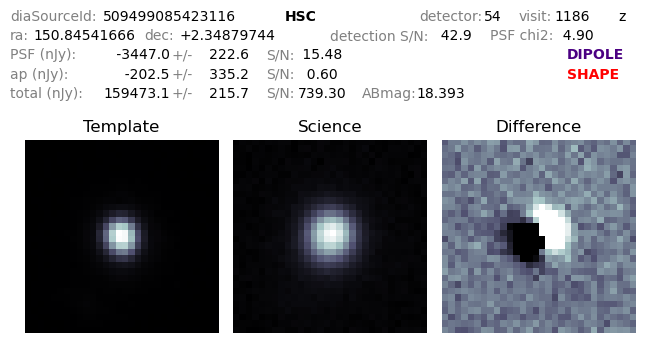

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.84541666495147+2.3487974408723327&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


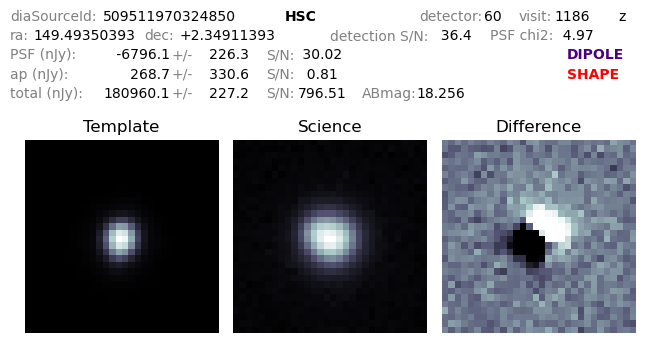

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4935039251374+2.349113931383073&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


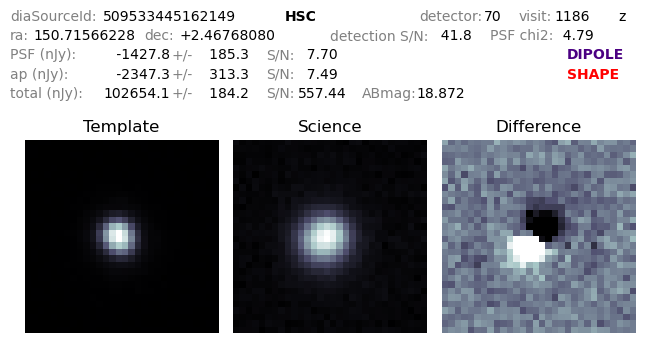

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.71566228374294+2.467680797713788&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


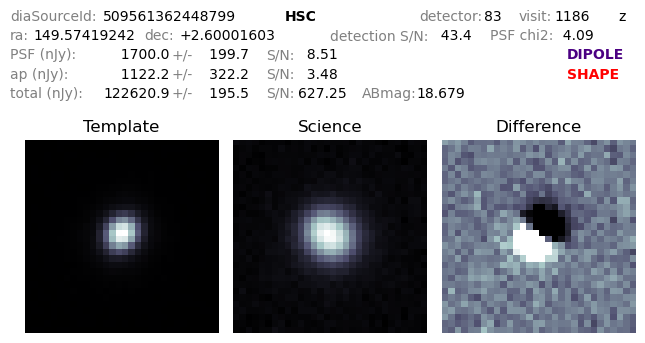

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.5741924152673+2.6000160319523253&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.0531586123863044


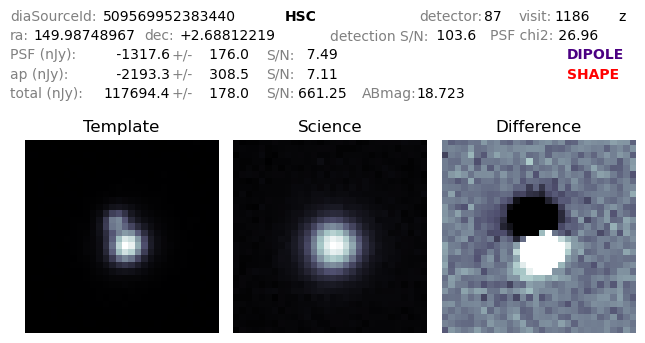

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98748967071933+2.688122185112242&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


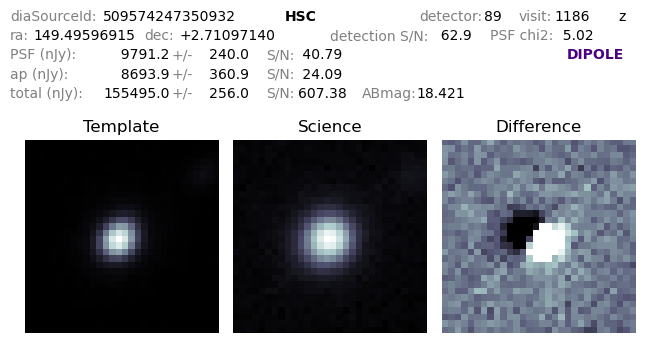

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4959691478242+2.7109714040411217&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.3978773611543151


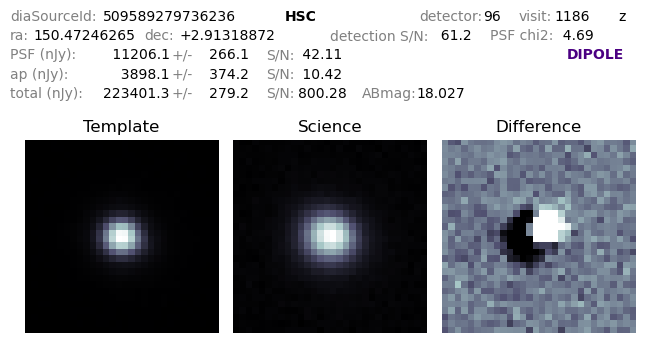

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4724626488305+2.913188721227805&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.2177396835937956


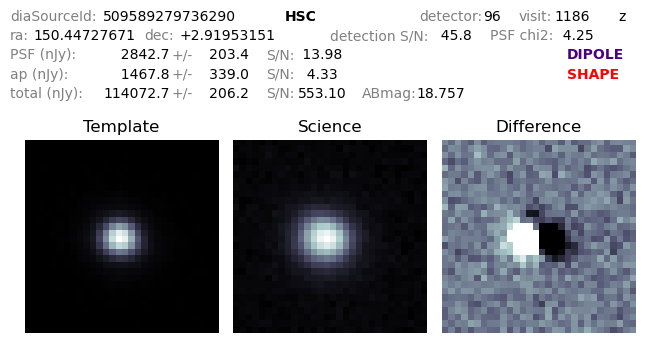

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4472767096261+2.9195315056903235&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.45785210093571416


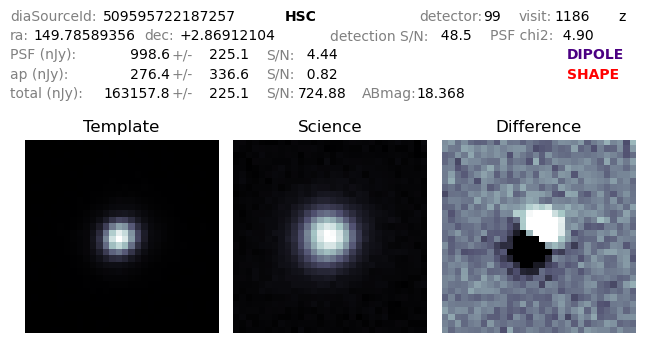

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.78589355511826+2.869121035613766&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


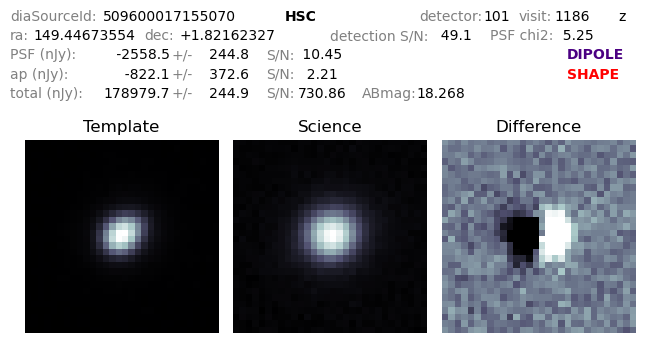

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.44673554250332+1.8216232716295746&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


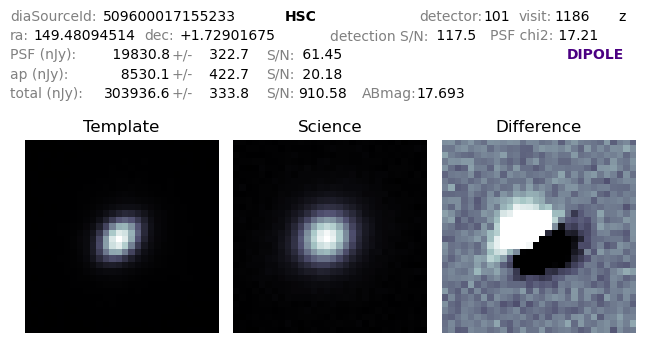

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.48094514014483+1.7290167478148886&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6194544236212862


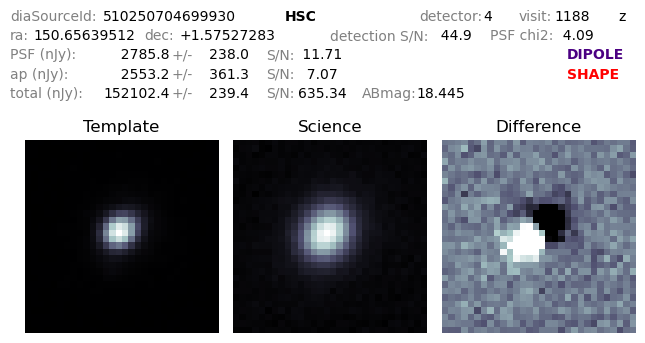

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.656395119933+1.5752728339955961&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.529785286316846


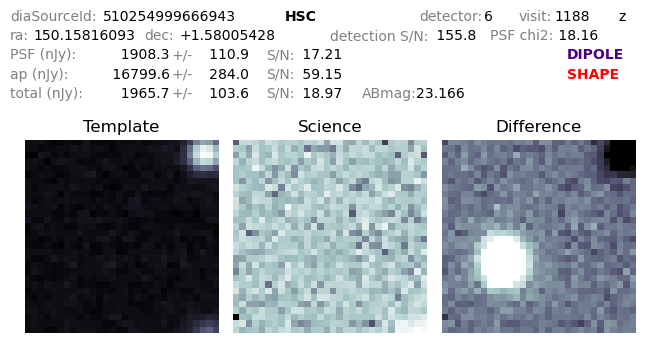

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15816092900923+1.5800542849197632&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.820805875154841


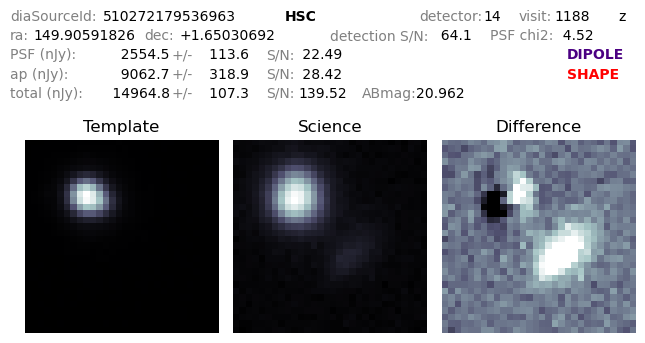

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.90591826384383+1.6503069180864&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.7574068972986209


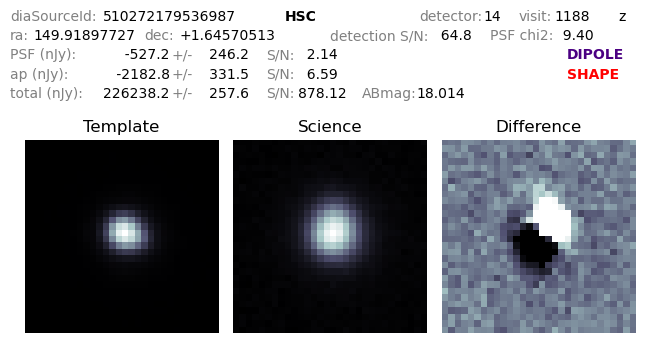

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9189772744245+1.645705131358446&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


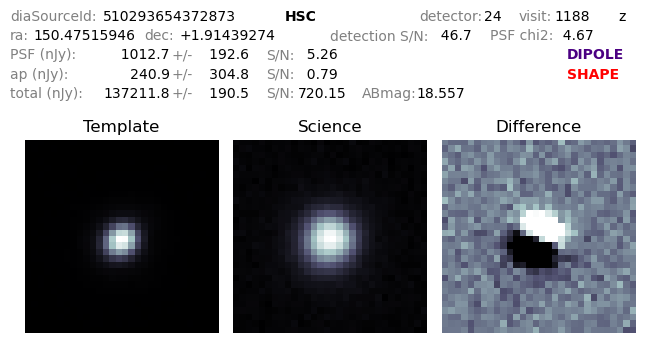

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.47515946134368+1.9143927415366626&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


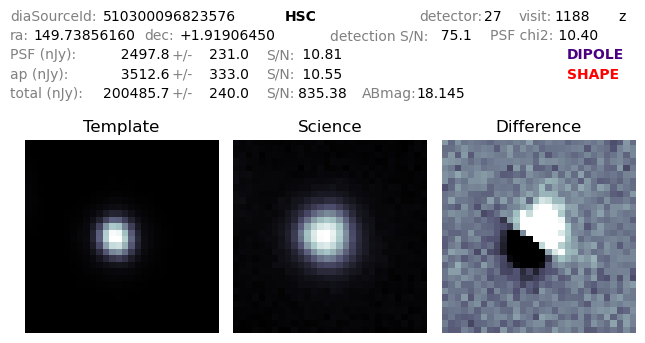

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.73856160388388+1.9190644956714387&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


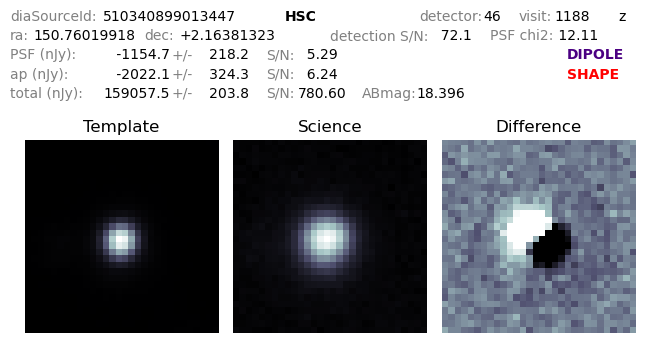

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.7601991804557+2.163813225418094&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


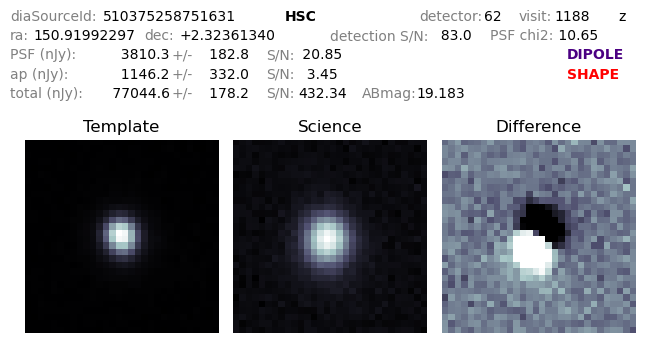

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.9199229673872+2.3236133999313764&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.18509294315130181


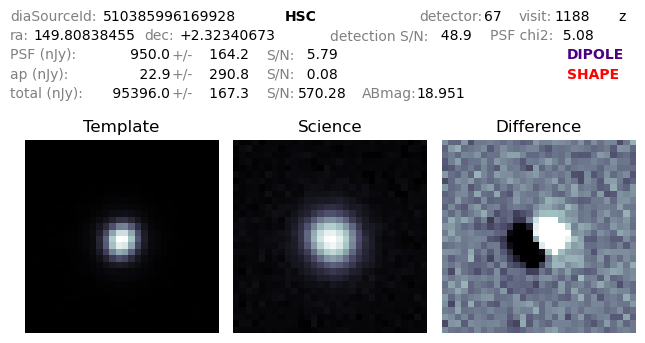

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8083845545277+2.323406728923863&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


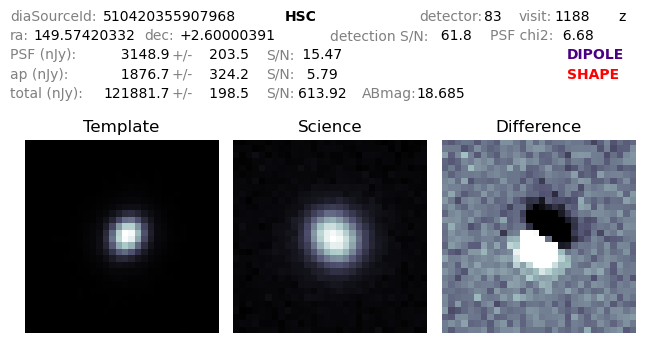

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.57420332169093+2.6000039136583553&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.7338993866826712


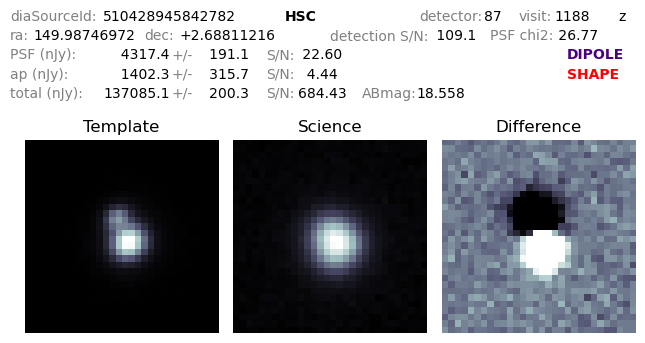

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98746971821024+2.688112160049272&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.7947095851002387


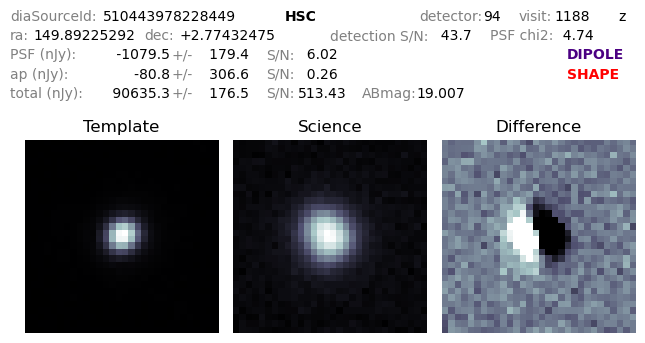

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8922529172009+2.7743247526903607&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


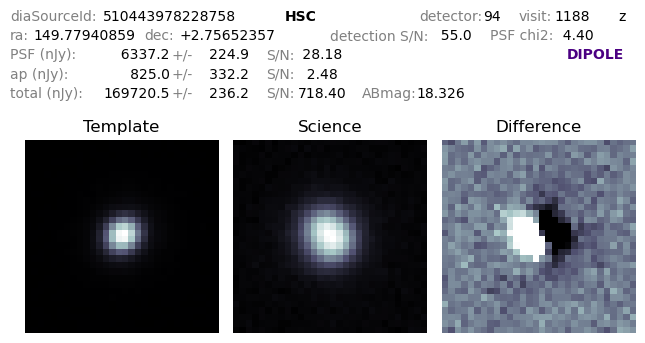

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7794085900638+2.7565235710457014&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.7687319575906729


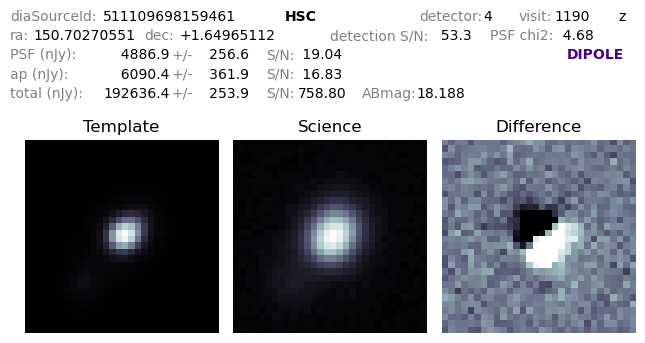

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.70270550954035+1.6496511164718066&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5170592327610752


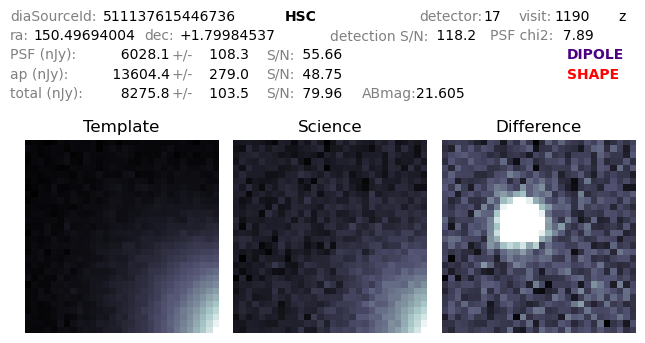

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4969400417712+1.7998453681124789&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.888918783705913


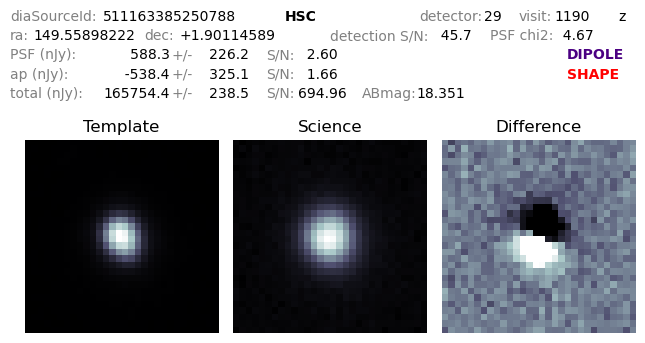

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.55898221655085+1.9011458897846132&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


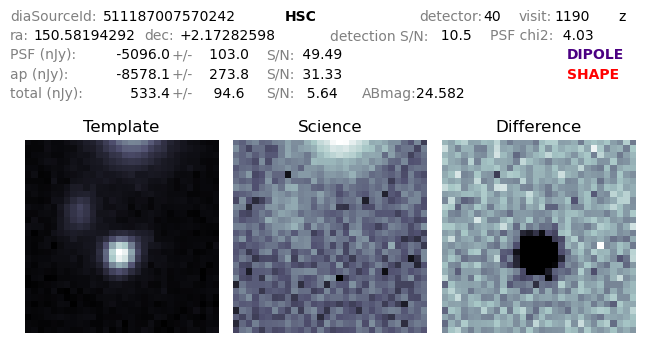

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.58194292495511+2.1728259832602297&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


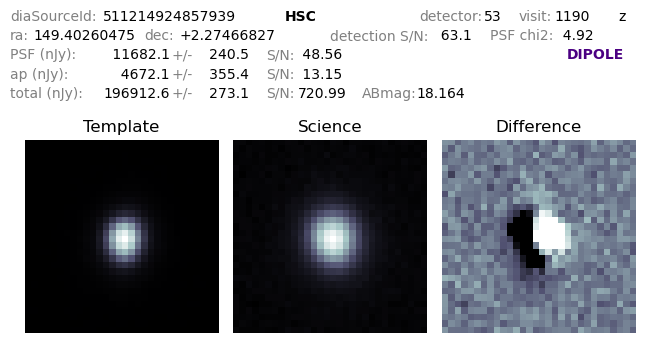

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.40260475471794+2.274668266438696&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.28370641596986074


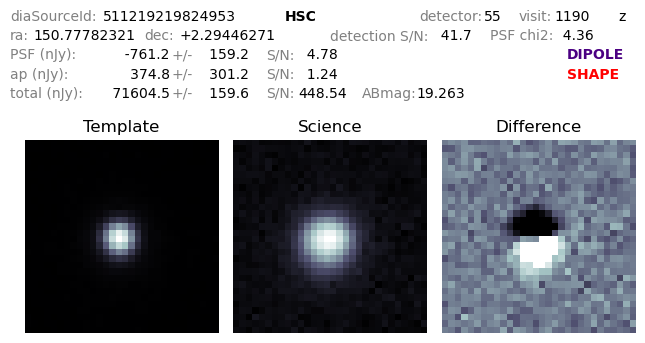

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.77782321102922+2.294462711349102&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


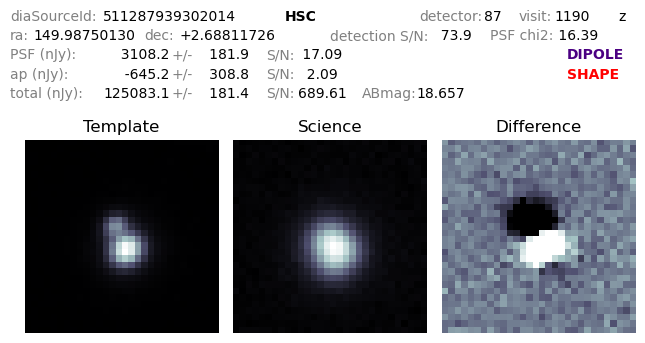

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9875012965661+2.68811726265237&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


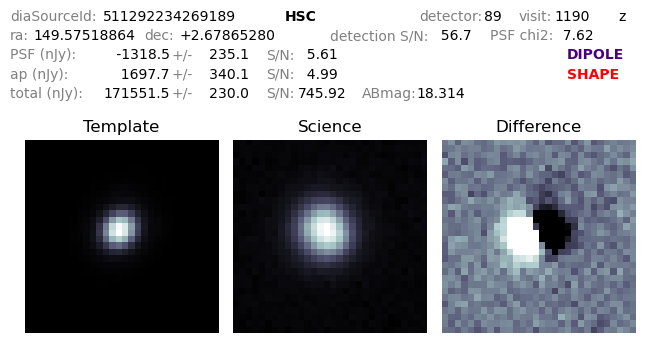

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.57518863565633+2.678652798885028&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


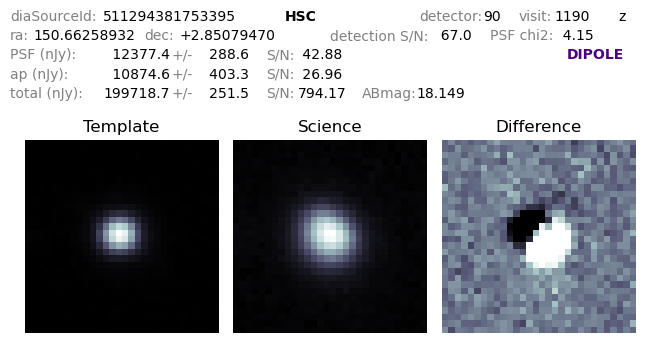

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6625893241484+2.850794704190679&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5523804412962382


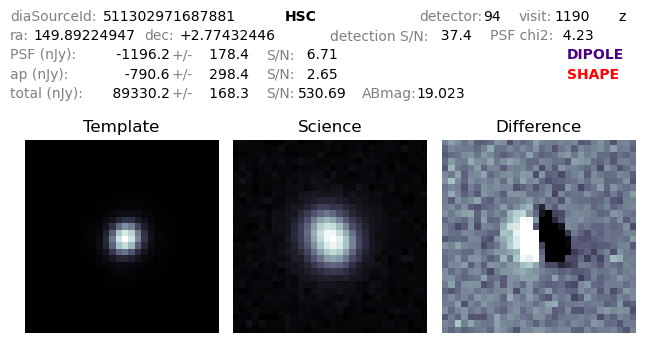

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.89224947160542+2.7743244642454976&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


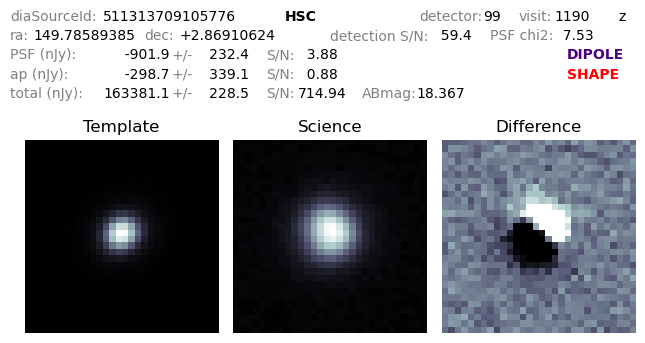

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7858938475874+2.8691062363882676&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


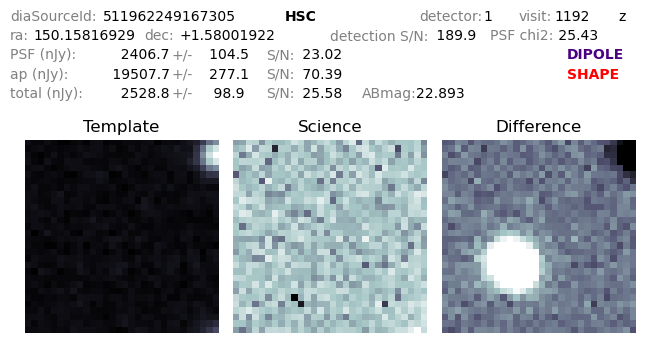

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.1581692876331+1.5800192151603372&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.766585869836426


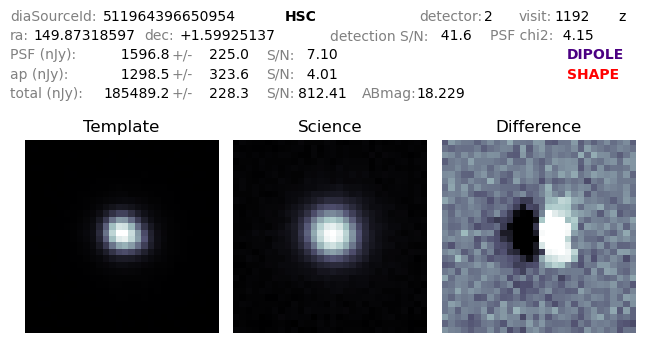

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.87318596756353+1.5992513689878676&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


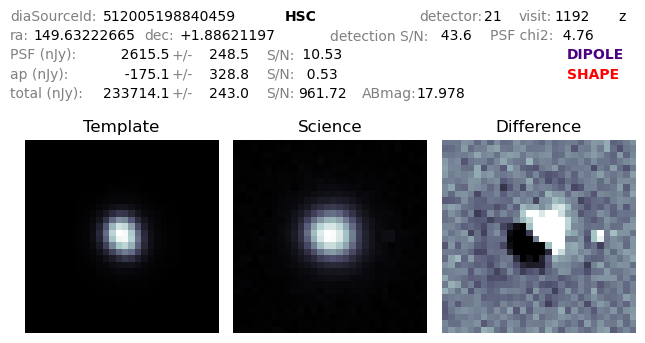

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.63222664562898+1.886211967329634&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.7934484777631734


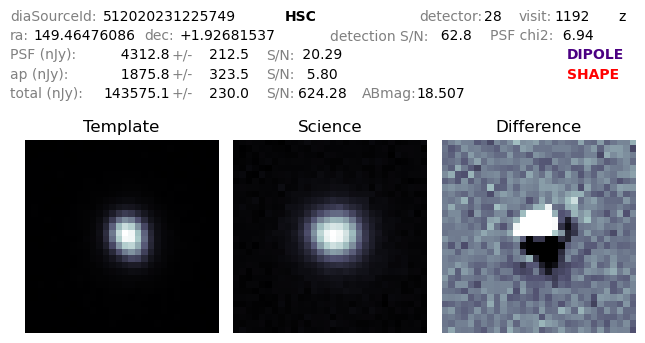

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.46476085594807+1.9268153677345232&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6265412257112336


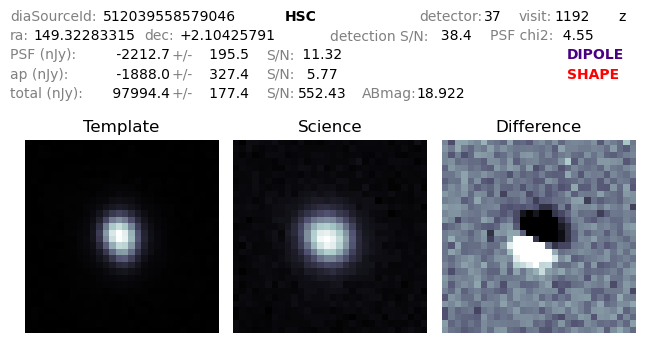

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.32283314826878+2.104257907763192&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


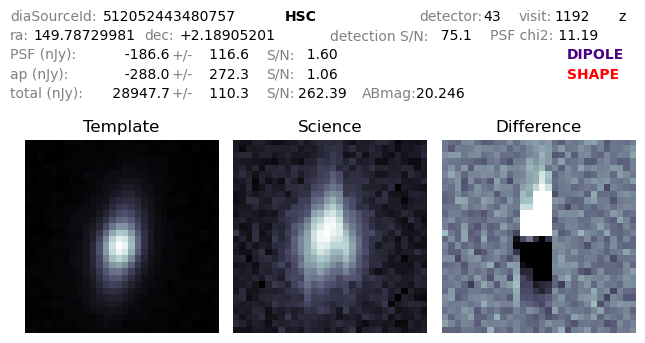

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7872998127353+2.189052007642025&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


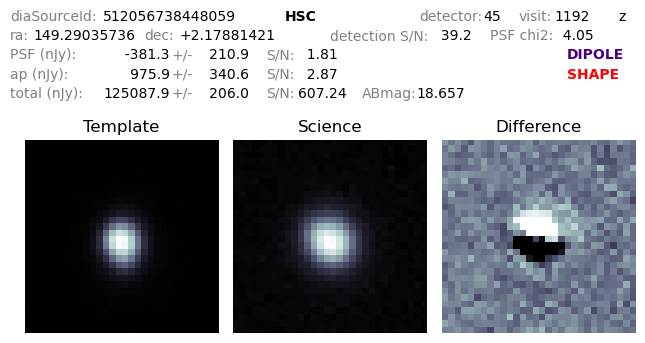

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.2903573625677+2.178814211935883&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


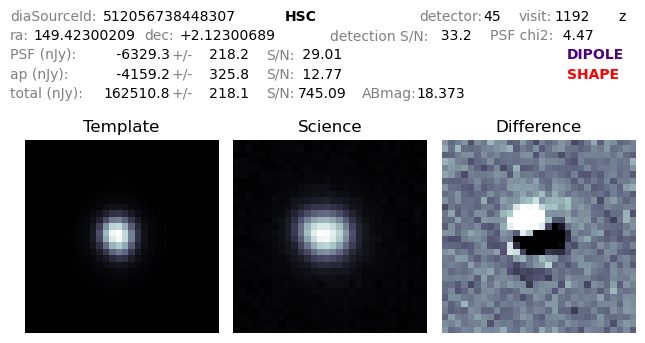

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.42300209335707+2.1230068900778276&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


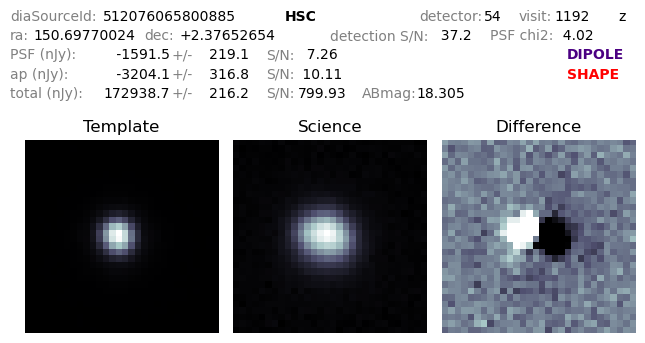

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69770024288454+2.3765265429574627&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


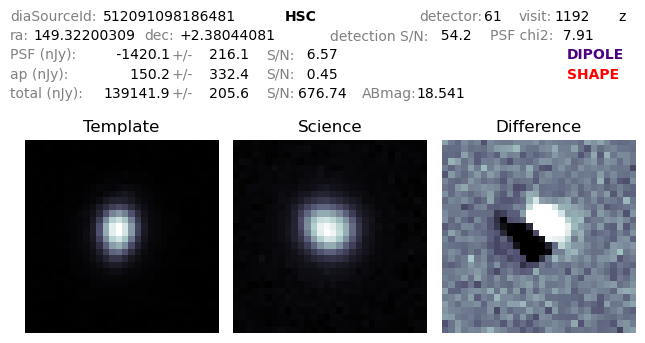

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.3220030948414+2.3804408086230615&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


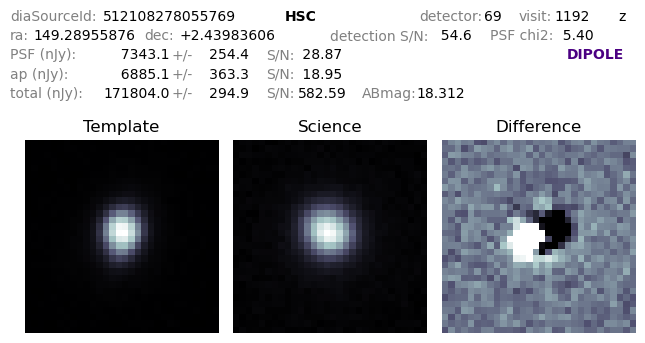

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.28955875544995+2.439836056981218&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.443098173061625


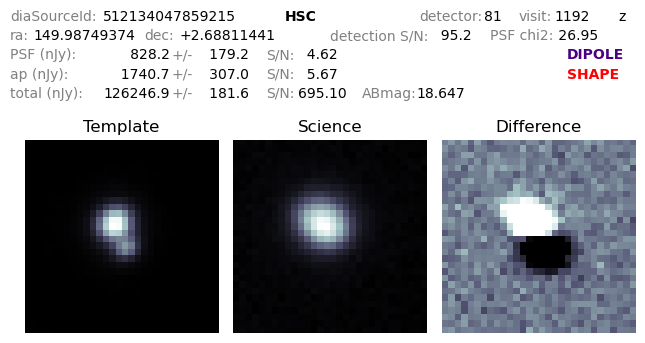

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98749374438924+2.6881144110498223&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


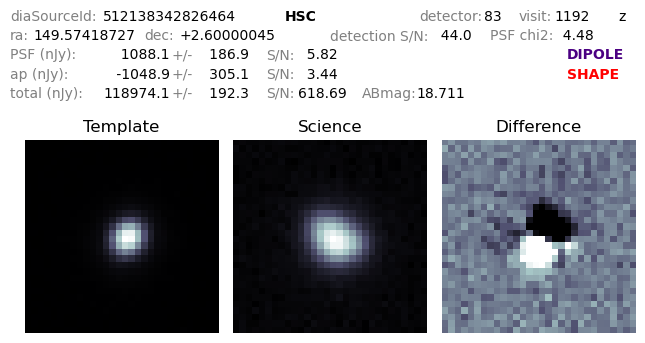

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.57418727408378+2.600000446564098&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


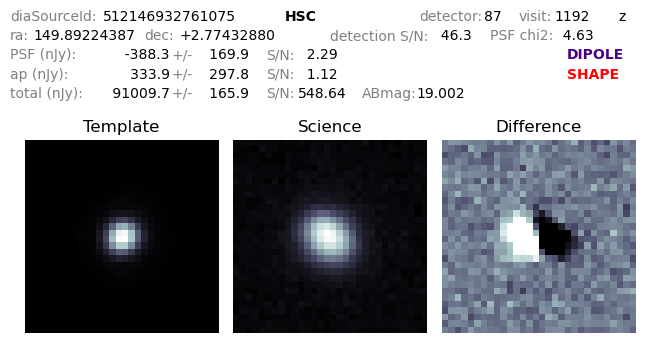

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8922438732234+2.7743287980426987&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


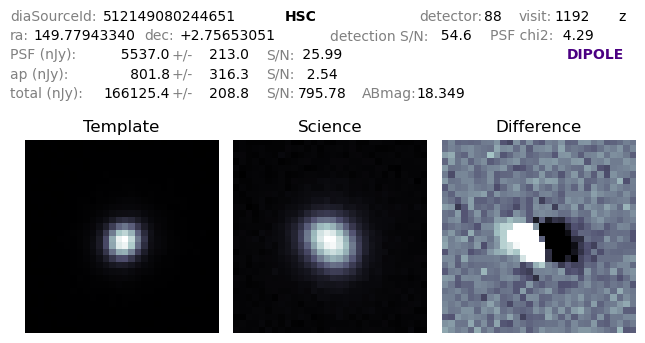

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.77943339653868+2.7565305065128385&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6085066845652967


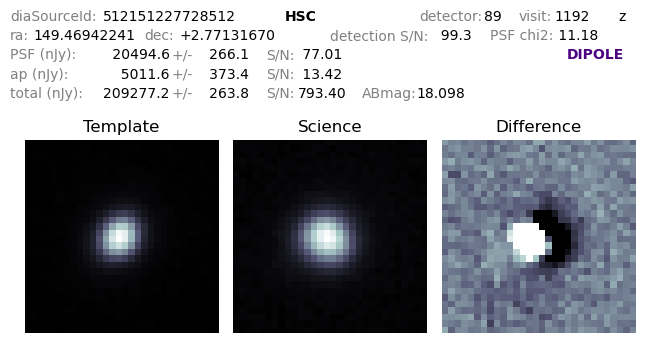

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.46942241376792+2.771316701037044&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.3898191544267039


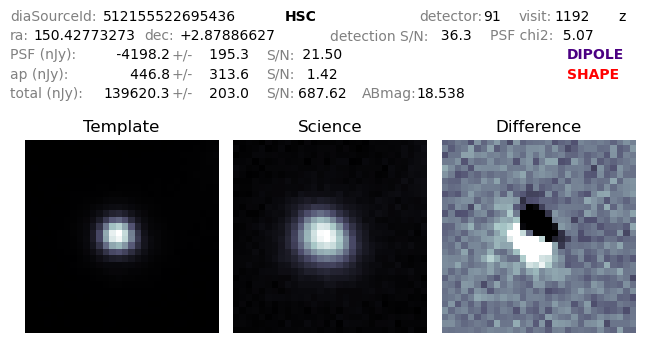

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.42773273302552+2.878866269145088&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


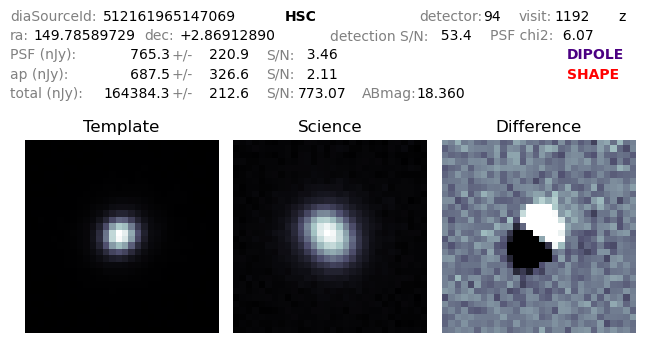

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7858972855547+2.869128897826713&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6833035894295719


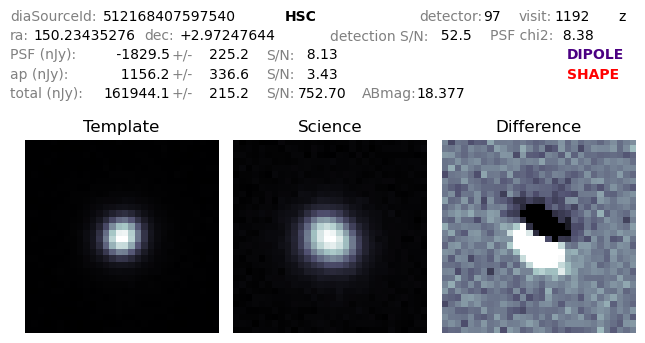

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2343527617529+2.9724764415602016&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


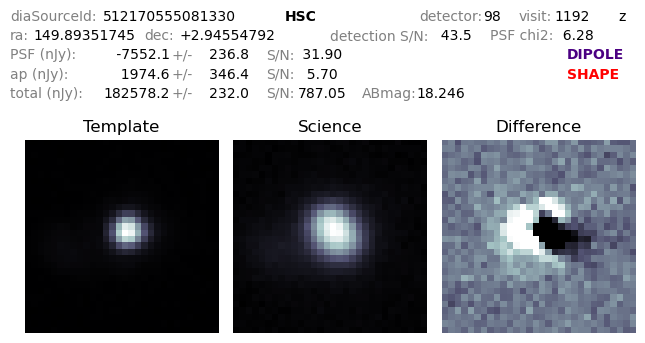

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8935174513677+2.945547919104626&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


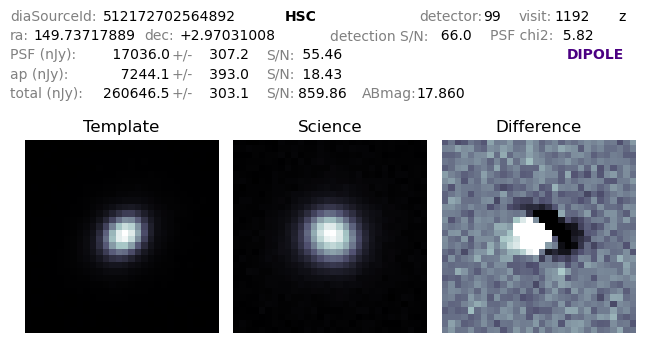

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7371788906965+2.9703100819607666&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5766733543385383


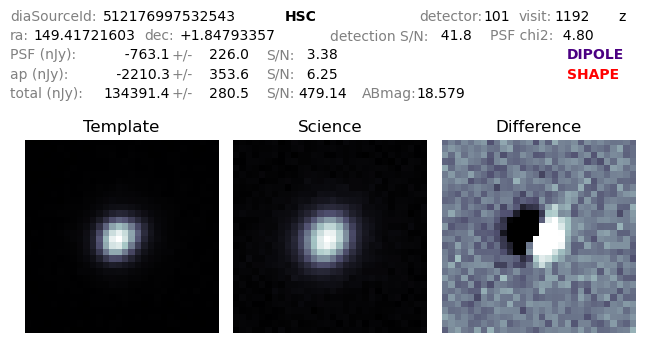

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.41721603407257+1.8479335669041255&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


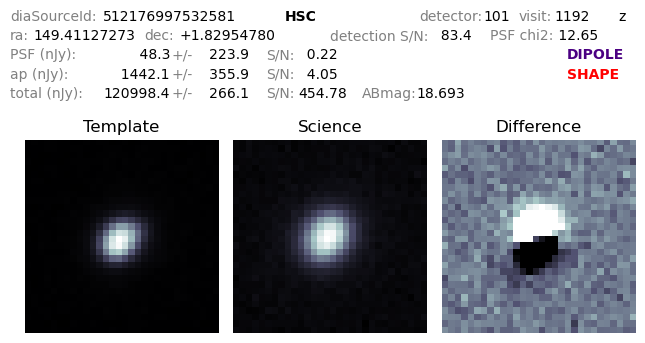

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.41127272612+1.8295477982821233&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


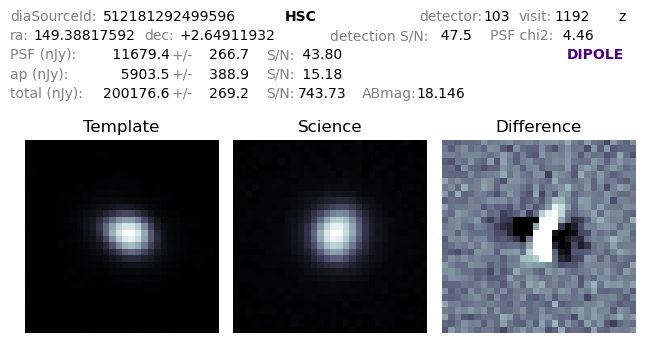

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.38817592216338+2.6491193210971016&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6867537271293119


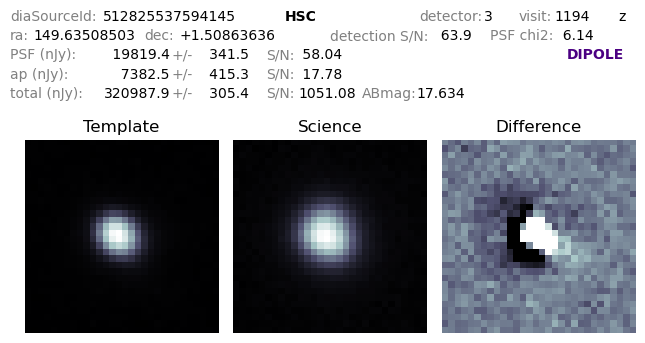

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.63508503216264+1.5086363573557071&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5672227082404218


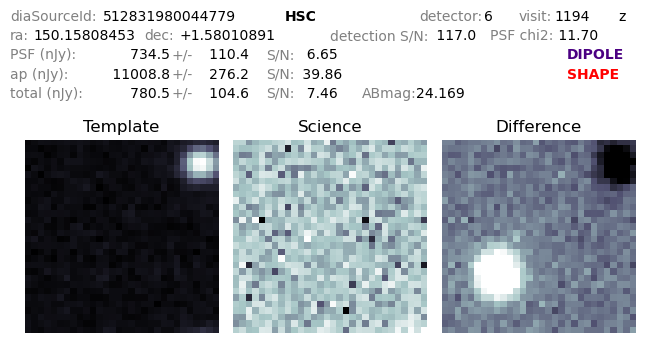

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15808453388516+1.580108910423293&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.5479327451198337


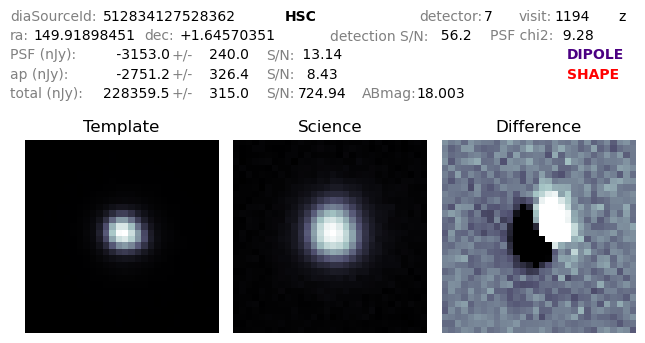

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.91898450893527+1.645703514677151&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


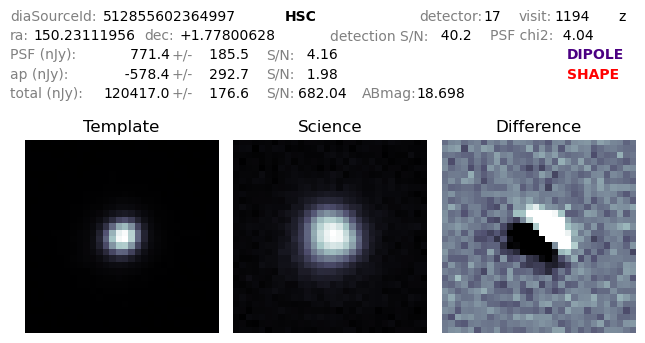

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.23111955939459+1.7780062836904909&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


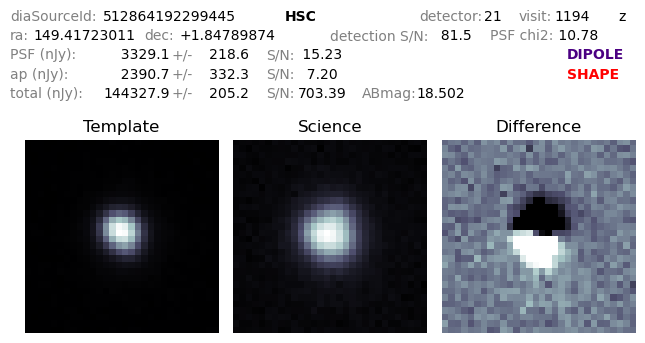

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4172301058+1.8478987401084301&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


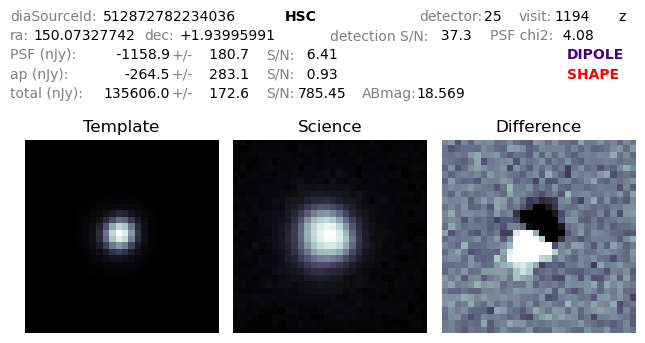

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.07327741896026+1.939959913715237&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


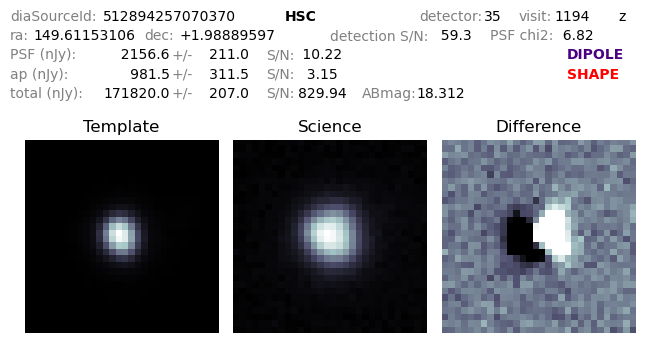

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6115310604578+1.9888959688056511&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.25826762340392534


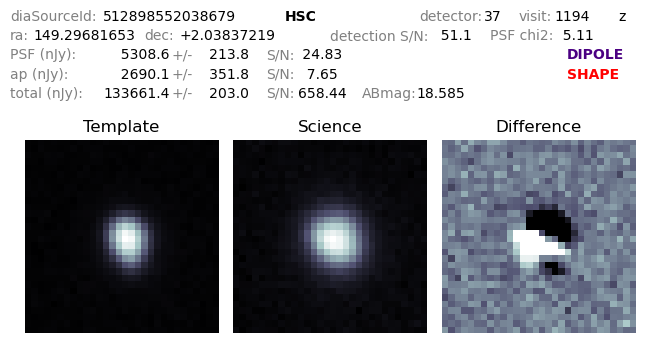

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.29681652542743+2.0383721861169484&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6841512115735646


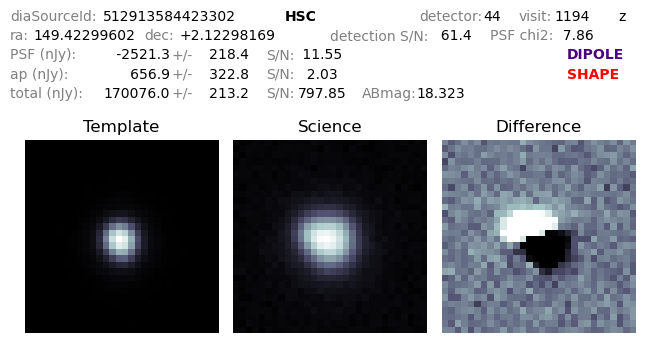

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4229960224715+2.1229816856578805&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


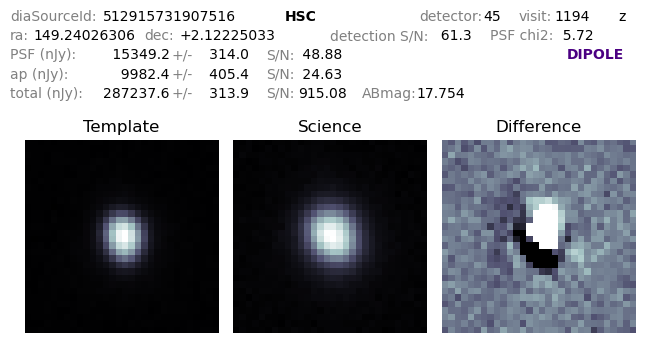

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.24026305675804+2.1222503332179063&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.4010282268600607


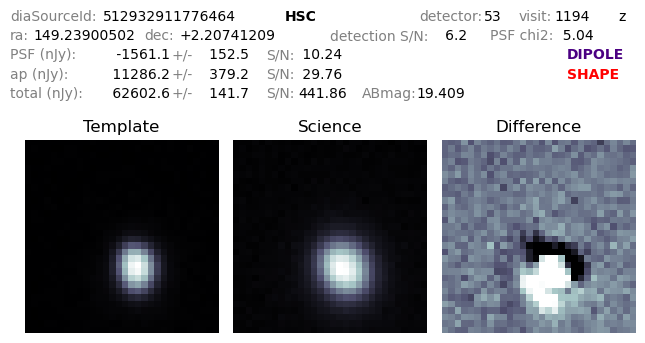

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.2390050202014+2.207412086647673&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


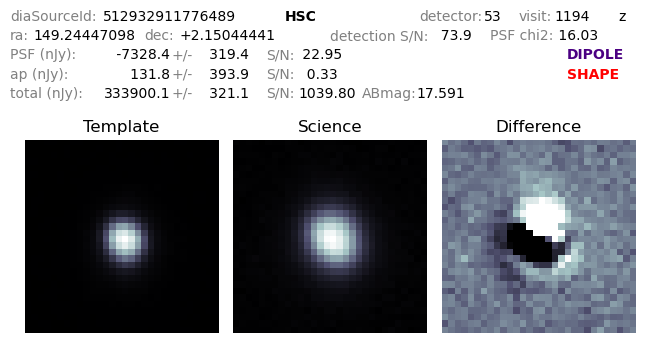

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.2444709762832+2.150444406053559&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


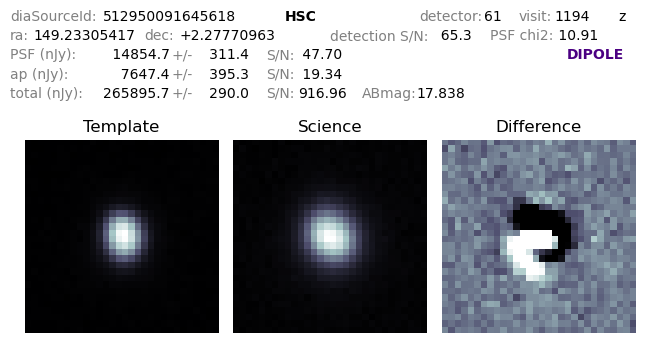

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.23305416874808+2.2777096256664526&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.429755775049271


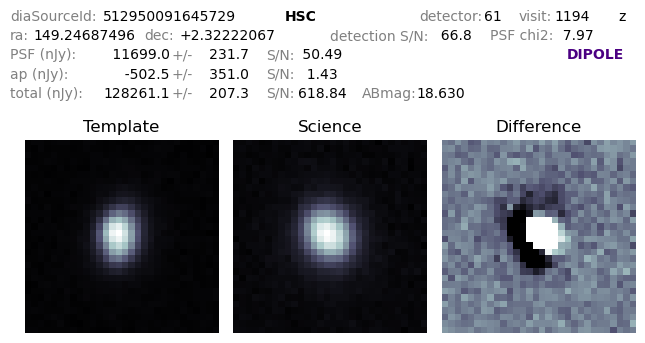

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.24687495542997+2.322220669501701&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.4711647716984962


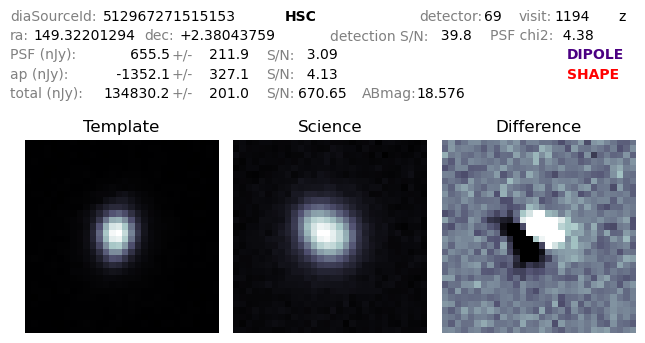

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.32201293957772+2.380437588041499&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


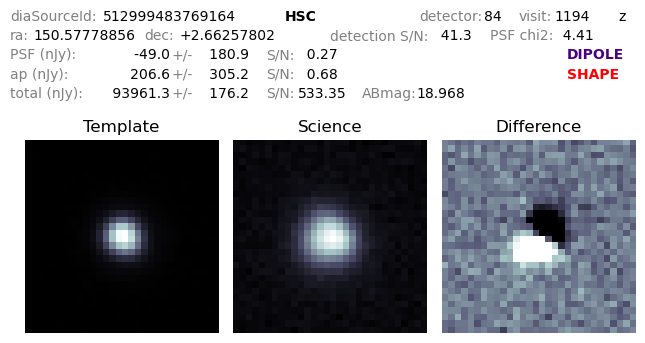

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.5777885604712+2.6625780231318674&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


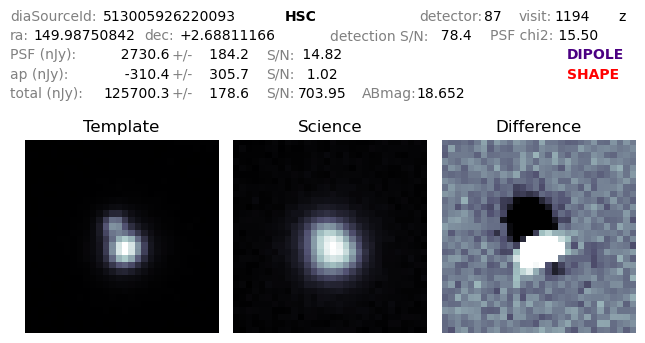

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9875084210383+2.6881116624961017&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


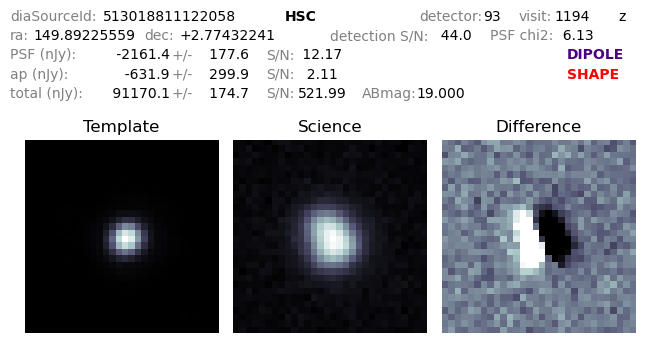

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.89225558632893+2.7743224148712136&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


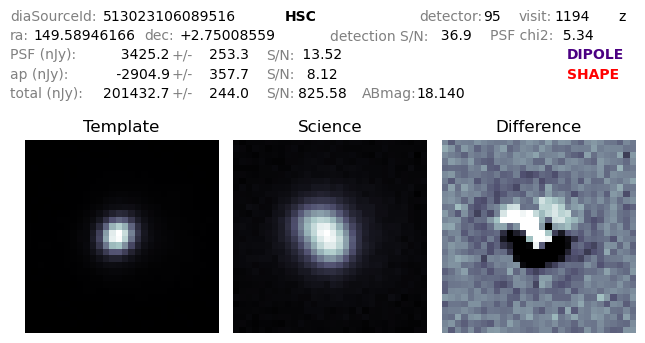

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.58946165881994+2.7500855943932634&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


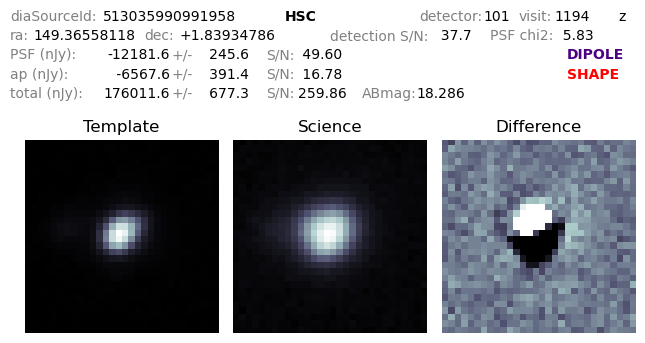

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.365581184678+1.8393478582465341&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


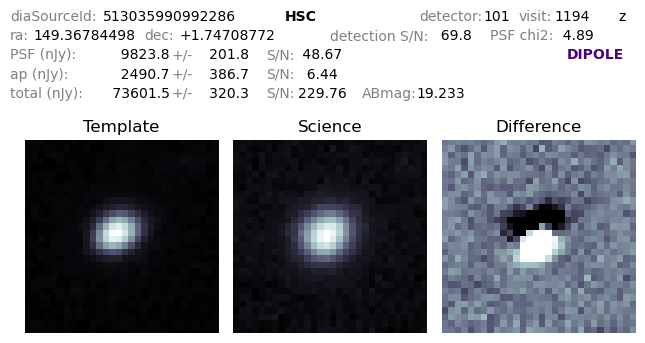

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.36784498130027+1.7470877198208714&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.4949205807533289


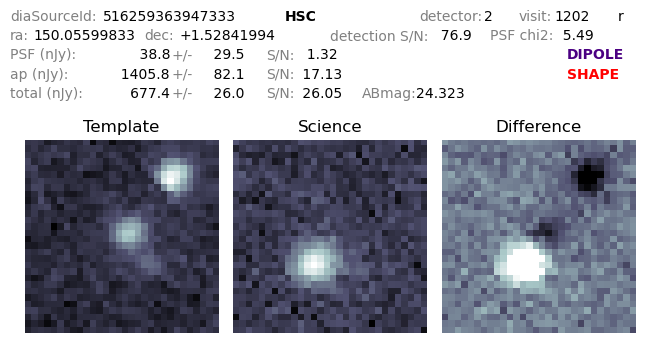

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.05599832550052+1.5284199429795704&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


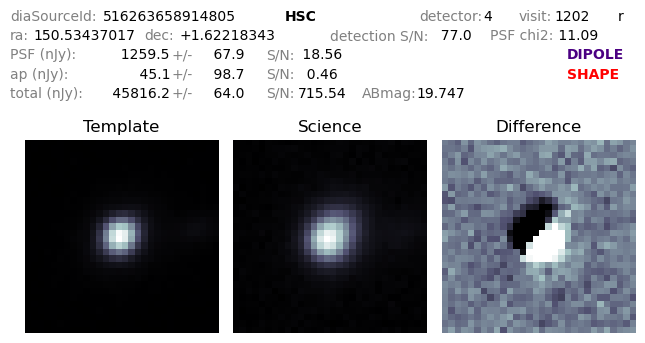

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.53437016579528+1.6221834250798008&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


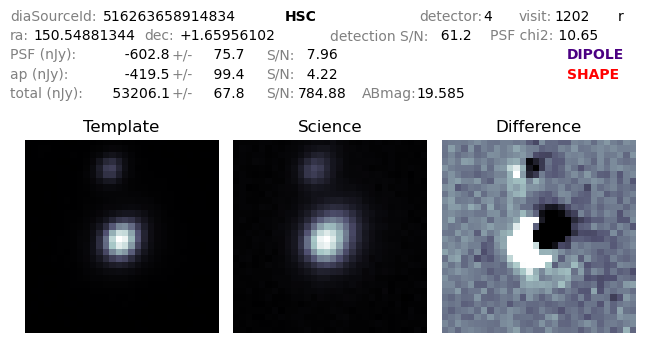

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.54881344284624+1.6595610183848237&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


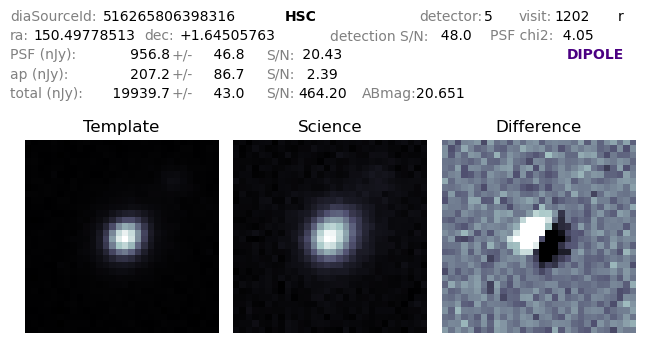

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.49778513374477+1.6450576266795818&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.47573690447823613


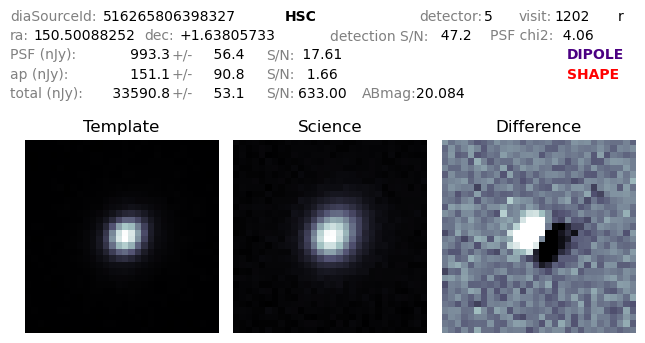

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.50088251591484+1.6380573309001802&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.3294389167237008


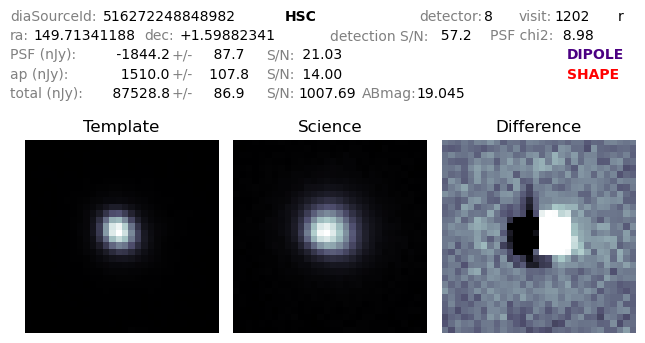

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.71341188197485+1.5988234115460453&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


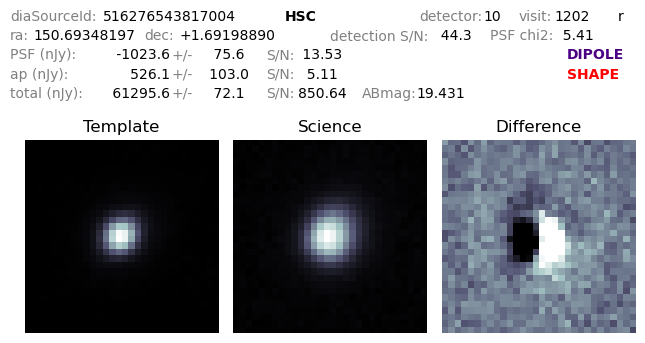

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69348197278669+1.6919889046934757&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


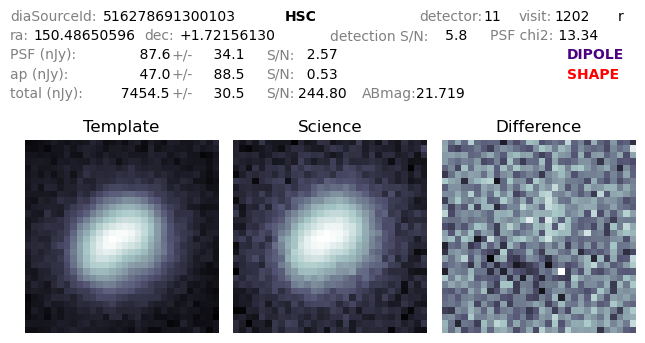

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.48650595775672+1.721561297639789&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


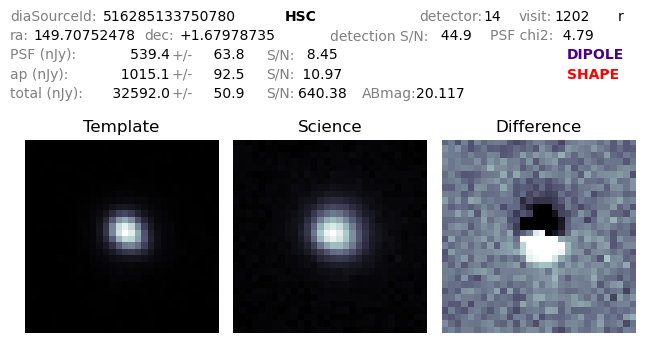

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.70752478053112+1.6797873491358601&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


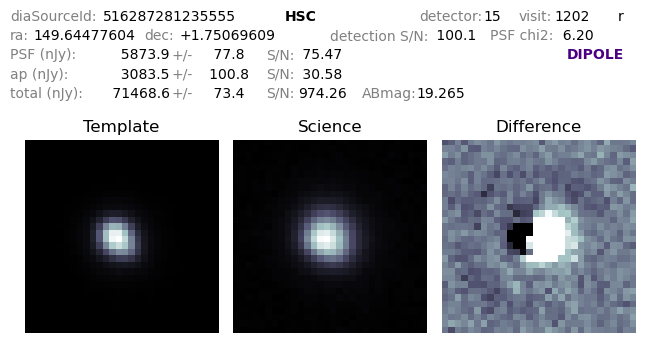

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6447760419518+1.7506960903009565&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6079405202725842


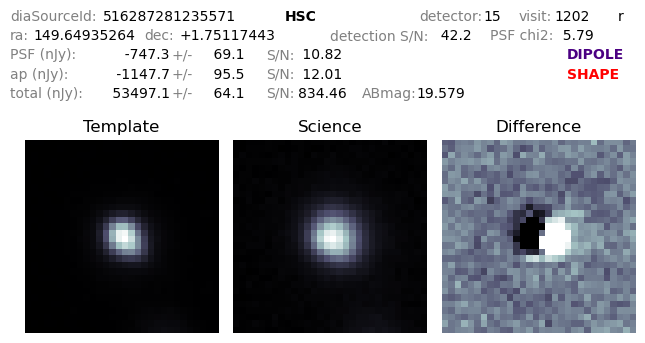

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6493526368212+1.7511744344281952&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


In [64]:
paths=highReducedChiSources['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if source["dipChi2"] <= 30000:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])

Histogram of dipole chi squared, I can't do the reduced chi^2 due to there being no dipNdata.

(array([136.,   6.,   1.,   4.,   0.,   3.,   2.,   0.,   0.,   1.]),
 array([   451.3925446 ,  41308.16723758,  82164.94193057, 123021.71662355,
        163878.49131654, 204735.26600952, 245592.04070251, 286448.81539549,
        327305.59008847, 368162.36478146, 409019.13947444]),
 <BarContainer object of 10 artists>)

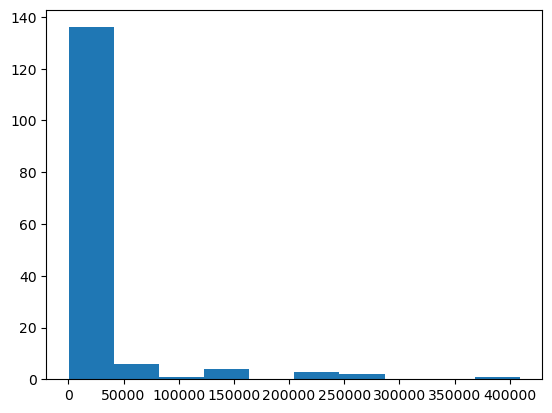

In [44]:
plt.hist(filteredData["dipChi2"])

## Solar System Objects snr > 8.0 psFlux > 0

In 100000 sources from John's snapshot catalog, there are 100 sources without the dipole criteria, a postive Ap flux, and a high snr ratio over the 8.0 cuttof. Many appear to be solar system objects. There are too many of them to plot all at once so only the first 21 are displayed. While this isn't finding bad sources, it seems to be pretty effective at quickly sorting out bright SSOs.

Length of filtered data: 100
100


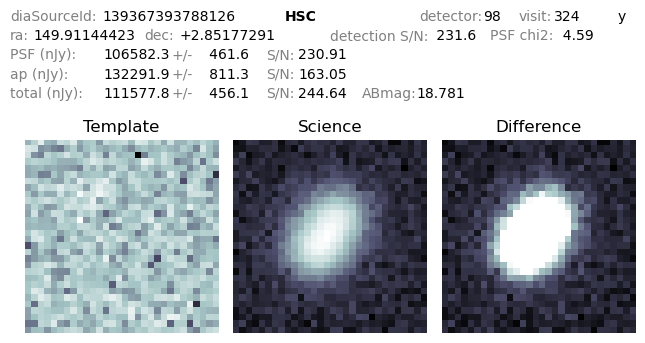

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.91144422548862+2.8517729080774763&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.600304412878315


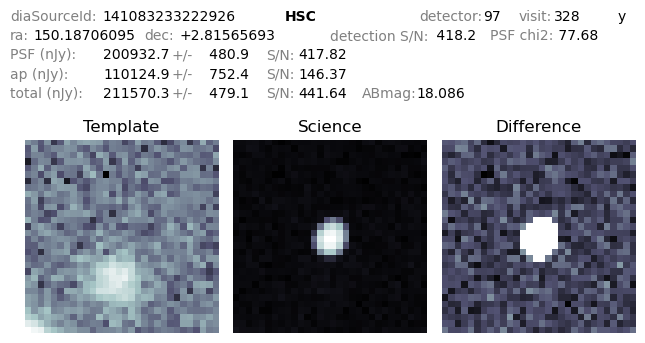

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.1870609488833+2.815656930298782&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.41680216556948174


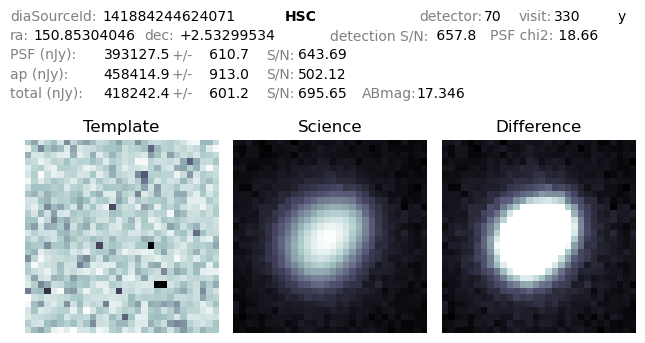

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.85304046385718+2.5329953413975725&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.306421638311347


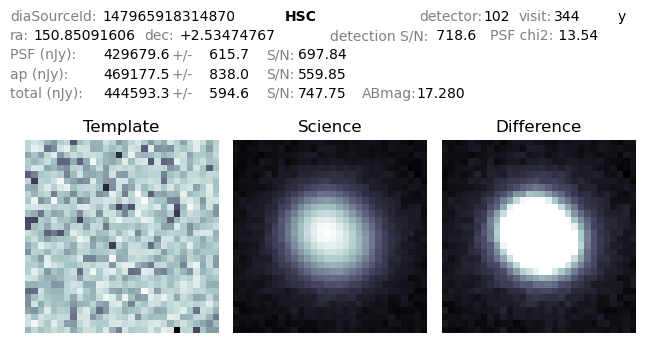

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.85091606053876+2.5347476702151206&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0195090709773558


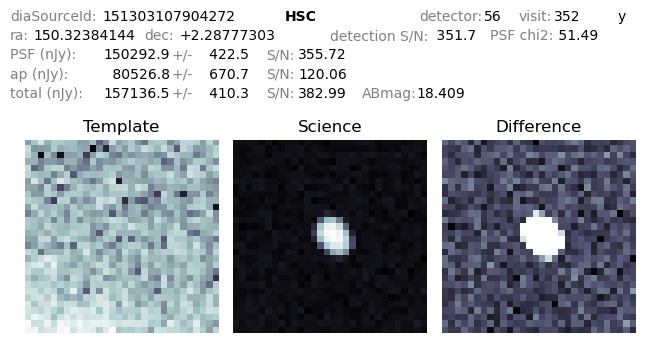

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3238414389082+2.2877730319815623&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6403042020760754


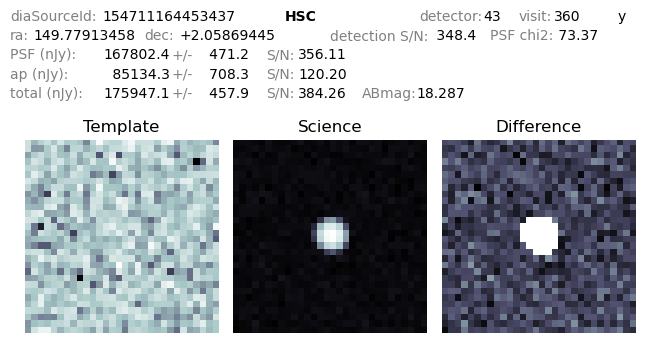

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7791345832556+2.058694452677477&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.1469629564735447


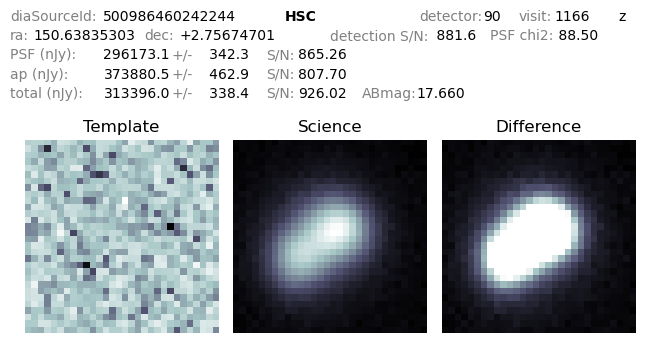

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63835303418523+2.7567470135966023&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8169425499079666


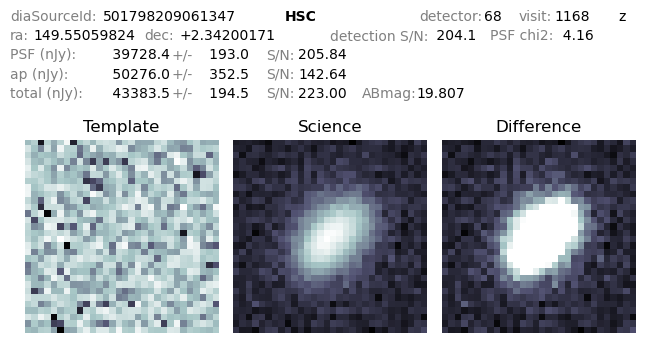

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.55059824224537+2.3420017065112213&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6008942953183578


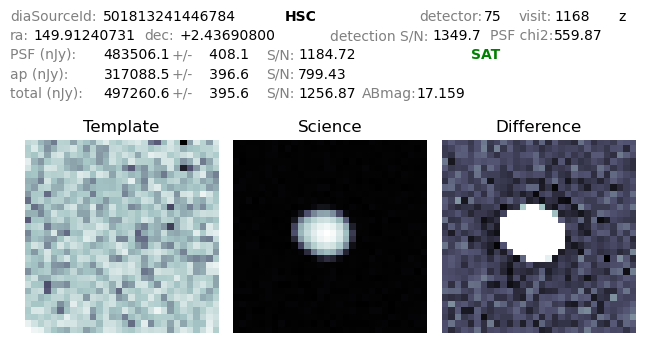

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.91240730504097+2.4369080012345163&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.696865662354185


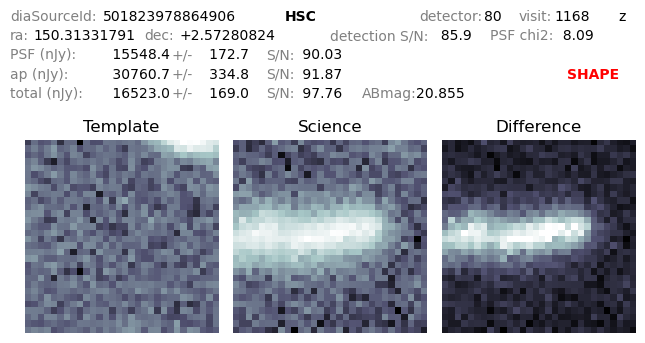

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.31331790598523+2.572808239634167&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


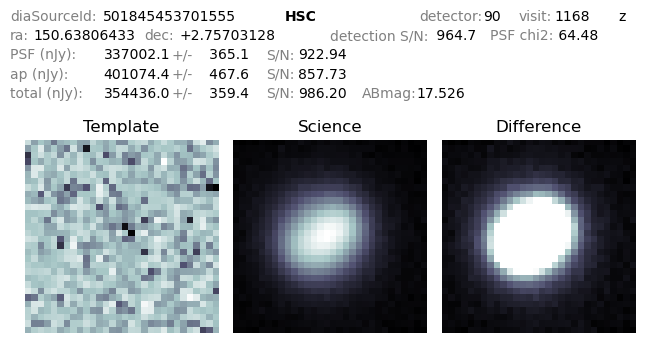

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63806432744184+2.757031278624003&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.2302055328411325


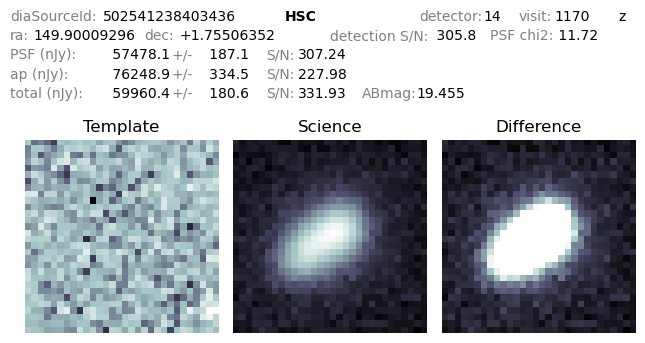

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9000929645128+1.7550635233880552&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.7742125175286272


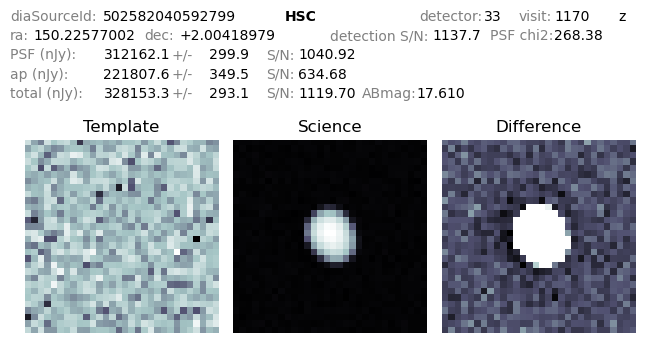

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.22577001904196+2.004189787528097&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6862705493484629


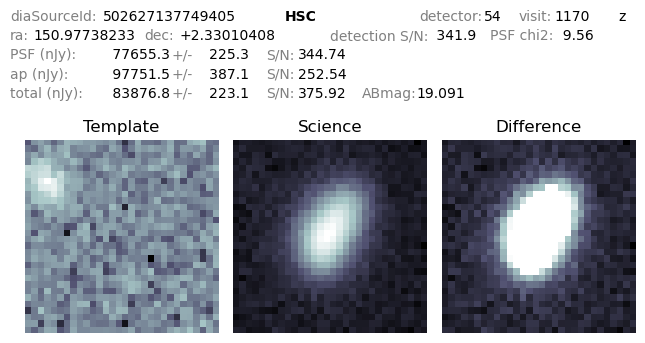

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.97738233055424+2.330104079746681&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.5537834939453916


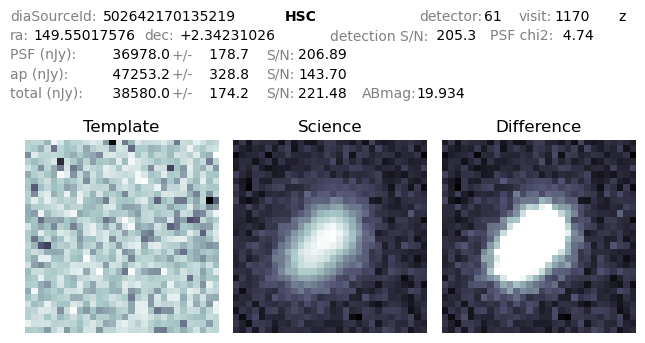

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.5501757641753+2.3423102635080153&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.684668648893542


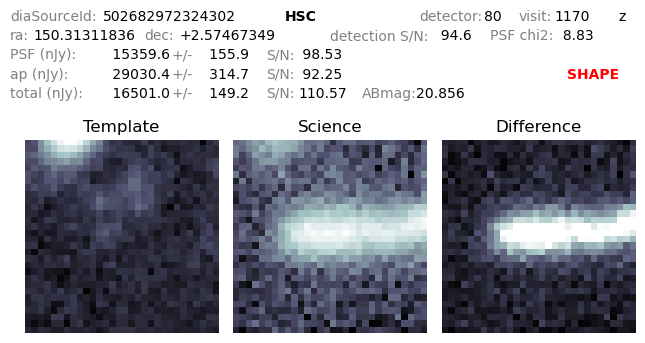

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.31311836129018+2.5746734890097196&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

4.943182484551458


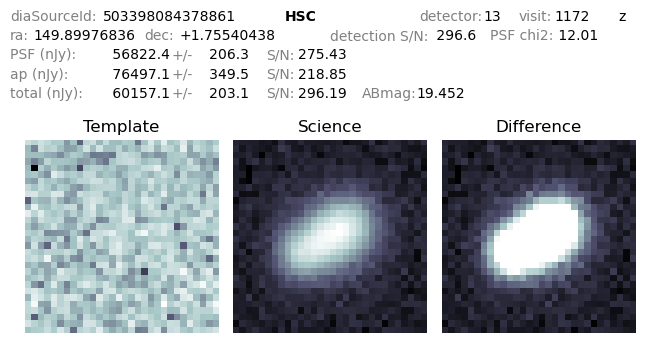

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.89976836015012+1.7554043846322303&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.9135951460751393


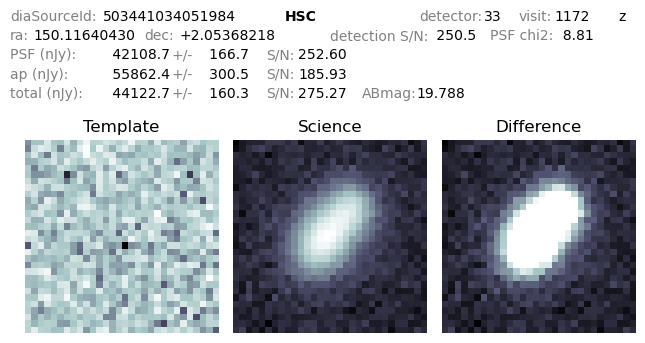

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.11640430271586+2.0536821782048125&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.9892659073685695


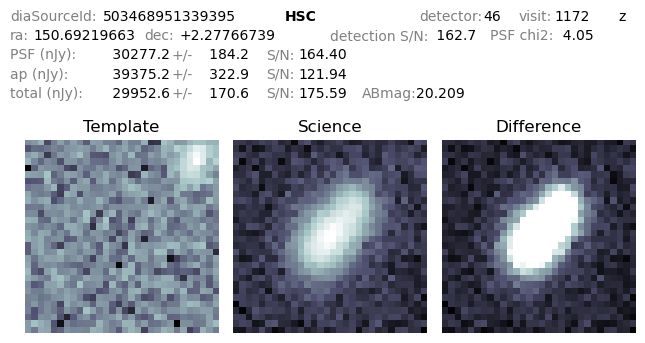

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69219663375088+2.277667390577445&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

2.044542862833172


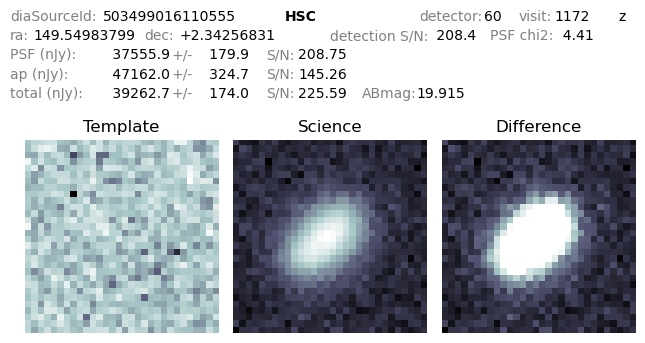

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.54983799479675+2.3425683062705698&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.658991261008138


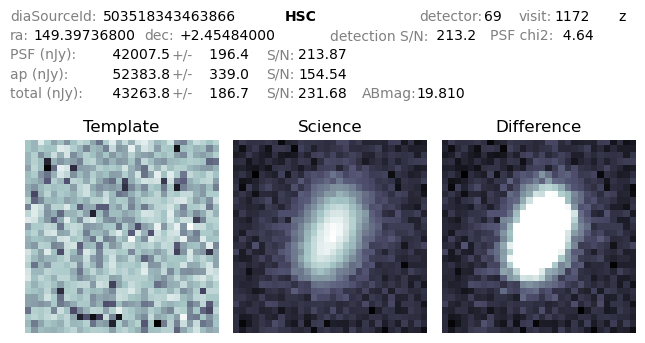

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.39736800308938+2.4548400003049444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.7684362586887832


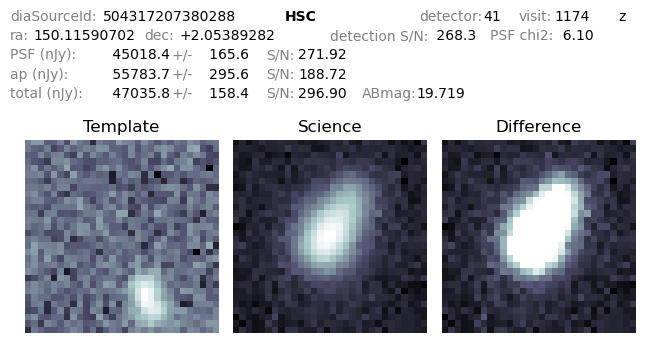

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.11590701939846+2.0538928199090853&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.7465859823004888


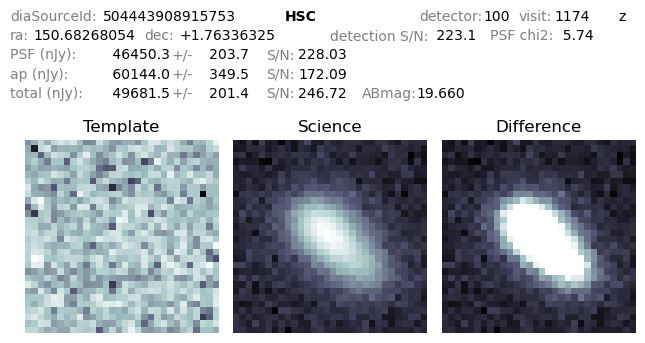

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6826805415315+1.7633632521490574&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.997227501335194


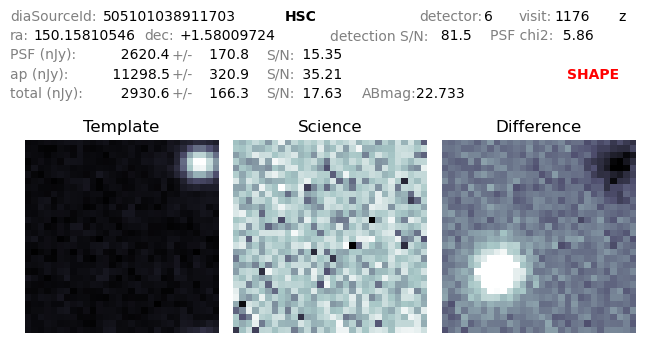

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15810546377566+1.5800972363628587&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


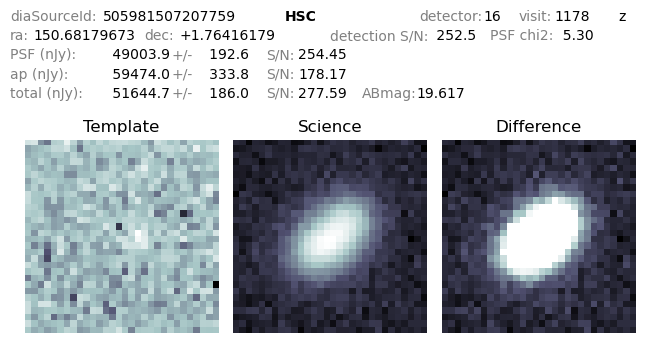

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6817967262876+1.7641617875202342&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6302035155166947


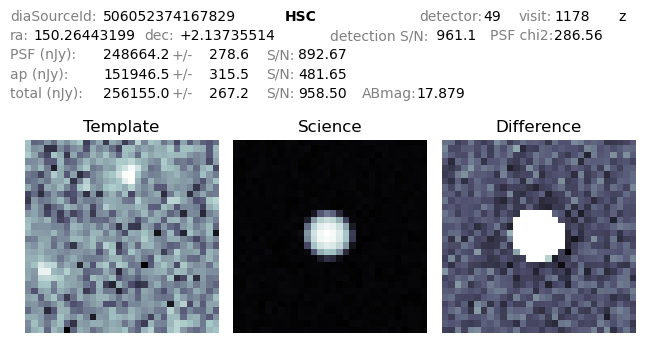

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2644319934536+2.137355137687791&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.31340223641576304


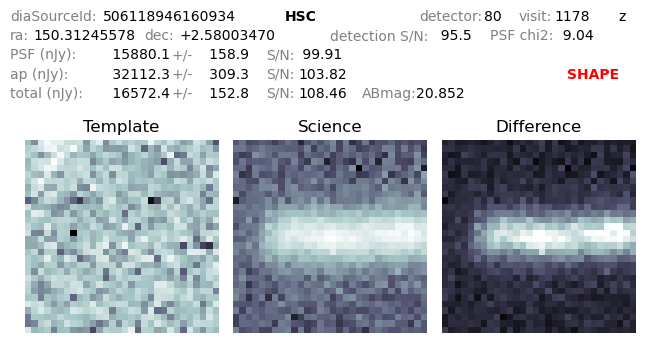

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3124557756205+2.5800346994254086&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
4.550951962585753


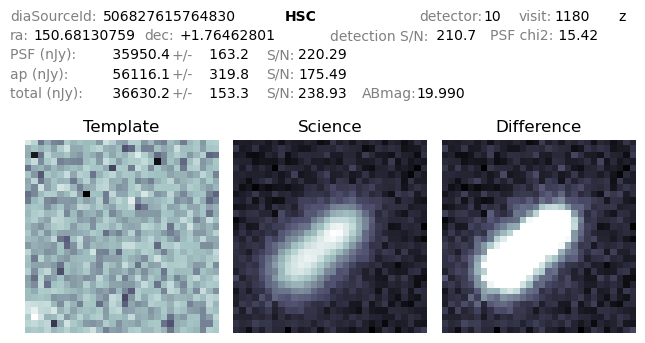

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6813075892321+1.7646280064899114&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.4374878344255815


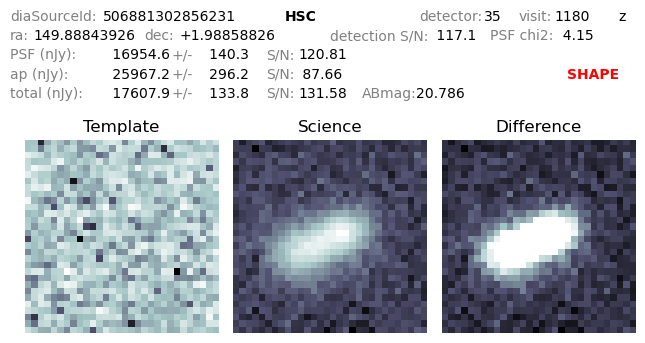

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.88843925736327+1.988588255680055&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.38794667901697594


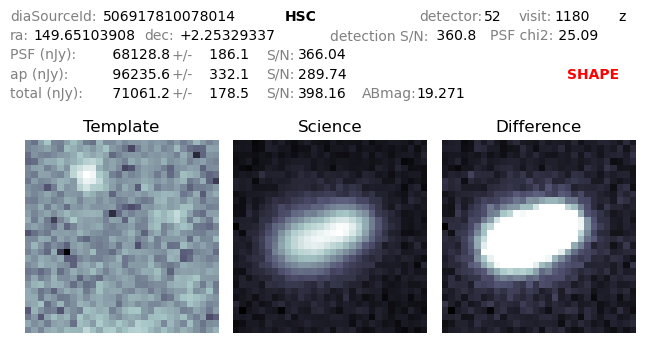

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.65103908447702+2.253293367900873&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


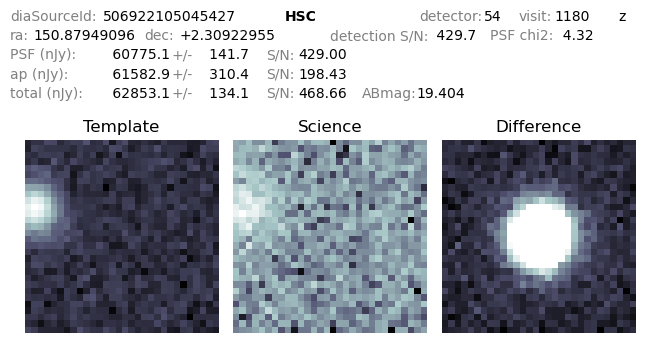

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.87949096318786+2.309229550931973&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5008783601058798


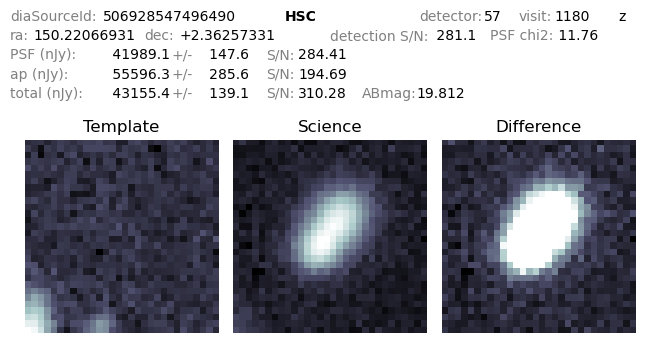

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.22066931303468+2.362573311994802&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.7806289517343117


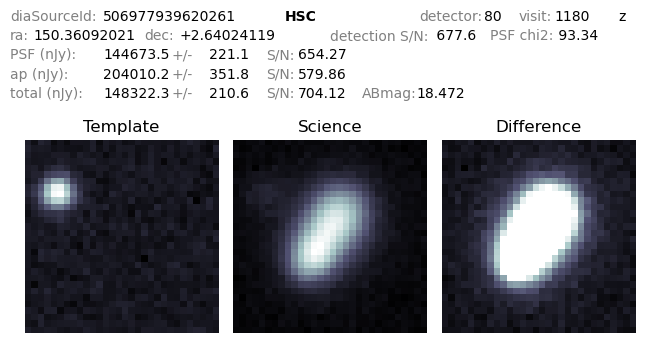

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.36092021024376+2.6402411865772764&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.96025977850351


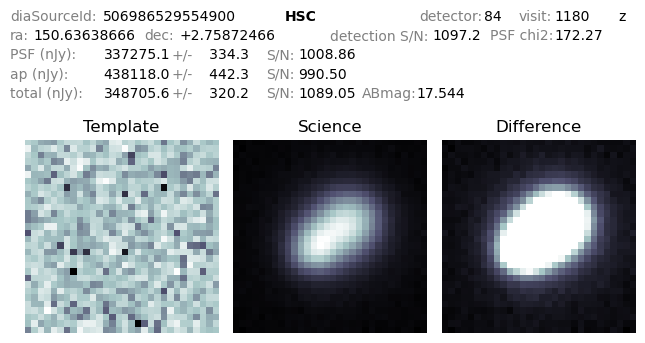

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63638665992167+2.7587246628667894&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6592127922904492


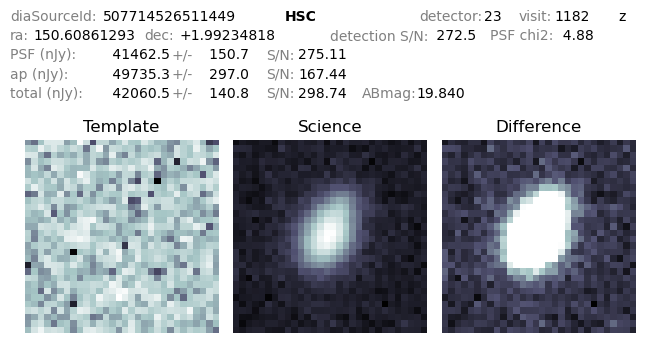

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.60861293253612+1.992348177819758&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.2841974965779557


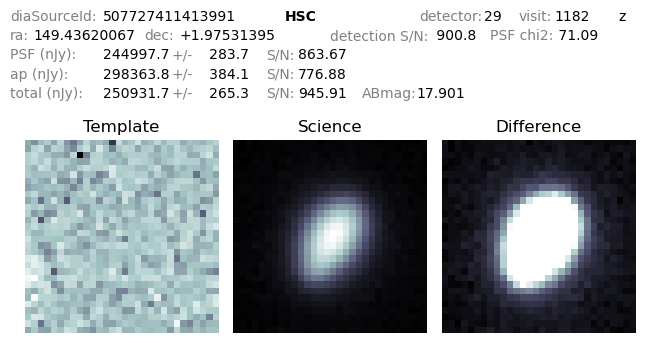

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.43620066530528+1.9753139508390922&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.3874160227851386


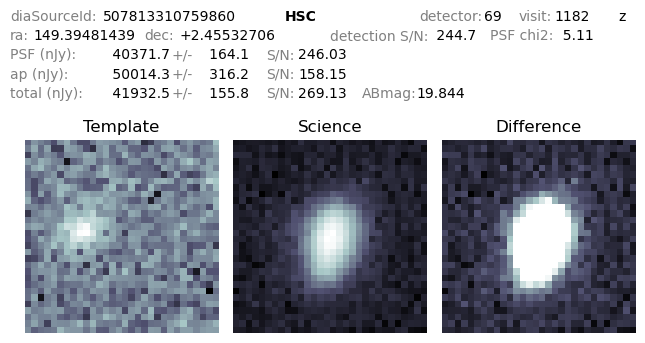

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.39481438757457+2.4553270559177065&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.3996816522953595


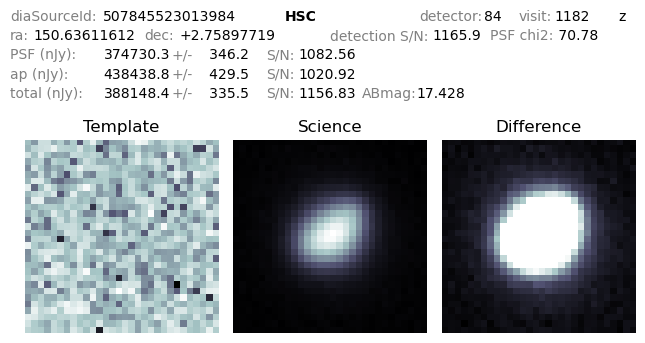

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63611612208348+2.758977188876583&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0880224638224658


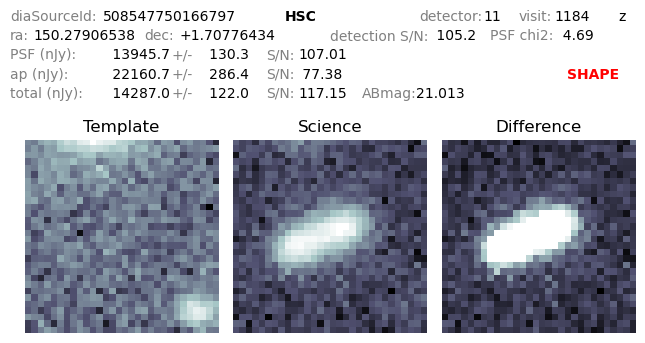

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.27906537585307+1.7077643412138694&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5981092778426498


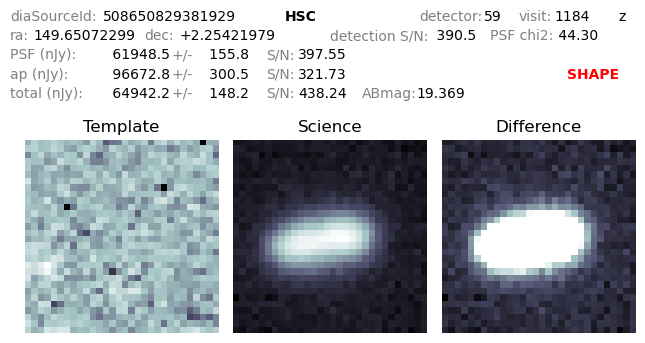

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.65072298737903+2.2542197859636395&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.3399930227226051


In [47]:
filter_key=["isDipole", "snr", "psFlux"]
action_key=["bool", "ge", "ge"]
value_key=[False, 8.0, 0.0]

filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)
print(len(filteredData))

for index, source in filteredData[0:40].iterrows():
    single_path = path_manager(source['diaSourceId'])
    display(Image(single_path))
    make_simbad_link(source['ra'], source['decl'])
    print(source['trailLength'])

(array([84.,  9.,  2.,  2.,  1.,  1.,  0.,  0.,  0.,  1.]),
 array([  4.01532291,  59.60074407, 115.18616523, 170.77158639,
        226.35700755, 281.94242871, 337.52784987, 393.11327103,
        448.69869218, 504.28411334, 559.8695345 ]),
 <BarContainer object of 10 artists>)

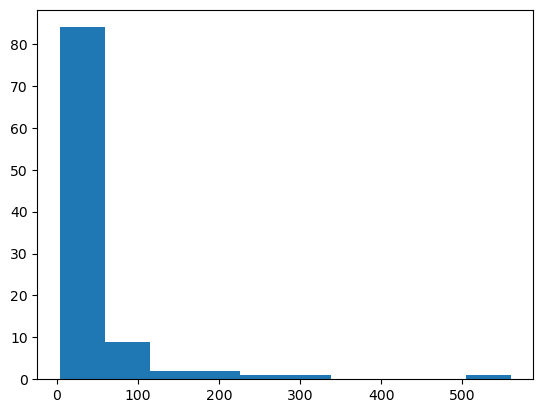

In [48]:
plt.hist(filteredData['psChi2']/filteredData["psNdata"])

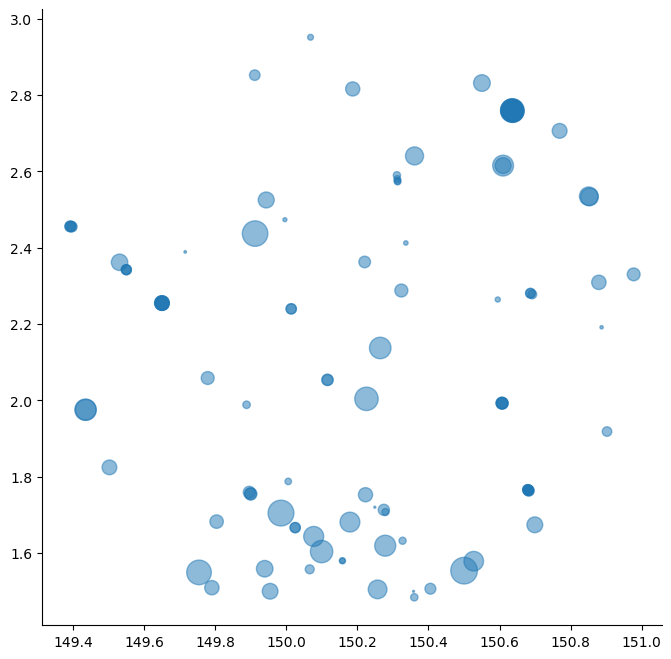

In [49]:
fig = plt.figure(figsize=(8,8))

cutoff = 0  # only plot DIA Objects composed more than cutoff DIA Sources

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.scatter(filteredData.loc[filteredData['snr'] > cutoff, 'ra'], filteredData.loc[filteredData['snr'] > cutoff, 'decl'], 
           c='C0', s=filteredData.loc[filteredData['snr'] > cutoff, 'snr'], marker='.', alpha=0.5)

# Sources w/ apflux/psflux >= 1.5

Sources with a reduced chi^2 over 4.0 and positive flux. I tried to see if I could do any adjustments to pick out only the few bad sources, such as the cosmic rays aligning with the source and the random bad pixels, but didn't come across a combination that JUST picked out the bad sources.

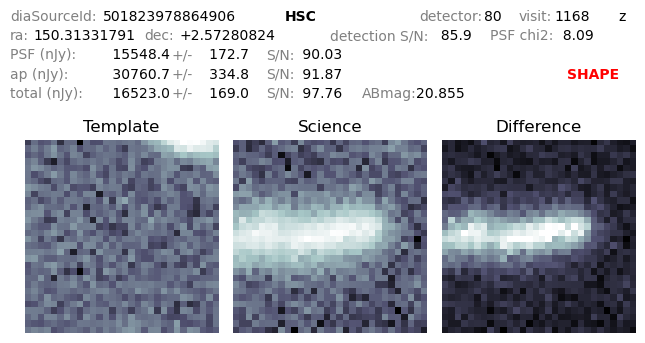

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.31331790598523+2.572808239634167&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


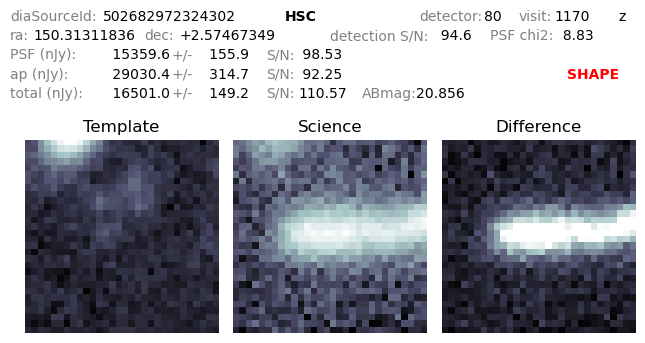

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.31311836129018+2.5746734890097196&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

4.943182484551458


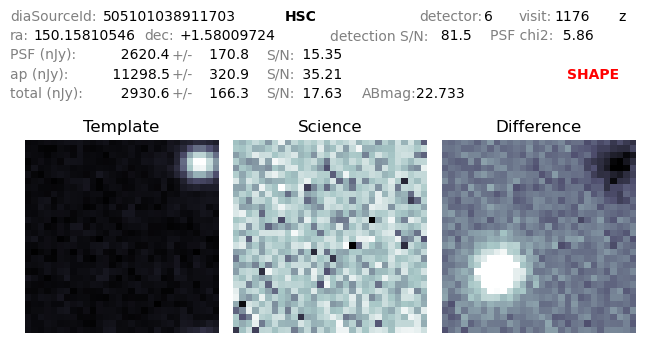

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15810546377566+1.5800972363628587&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


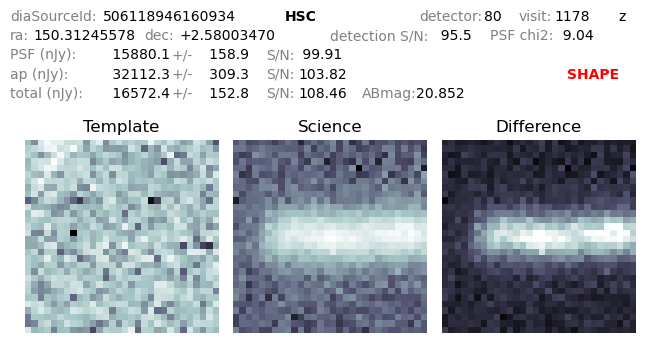

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3124557756205+2.5800346994254086&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
4.550951962585753


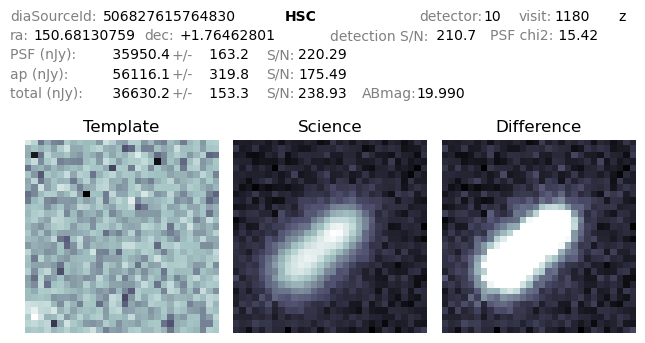

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6813075892321+1.7646280064899114&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.4374878344255815


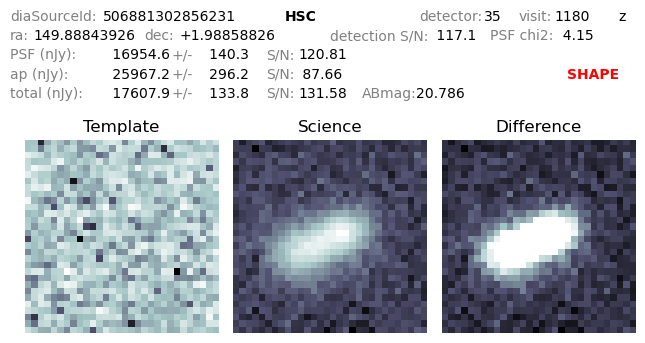

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.88843925736327+1.988588255680055&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.38794667901697594


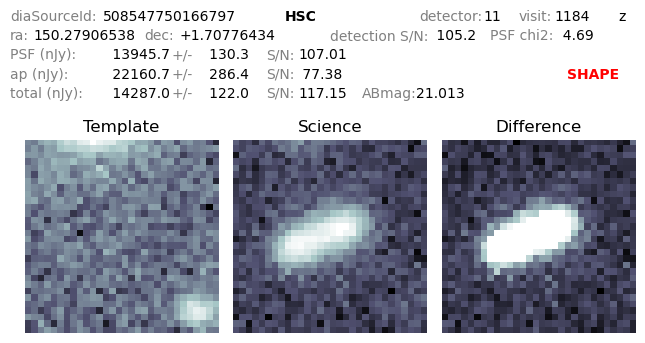

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.27906537585307+1.7077643412138694&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5981092778426498


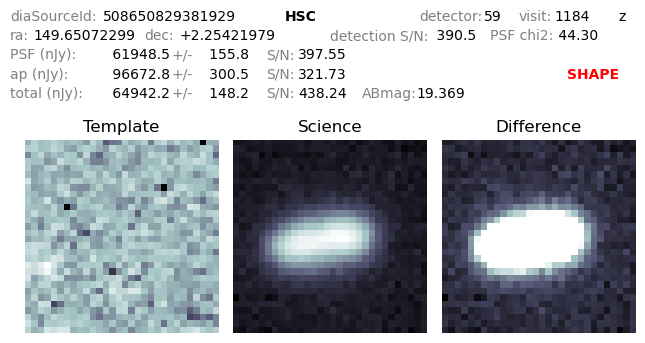

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.65072298737903+2.2542197859636395&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.3399930227226051


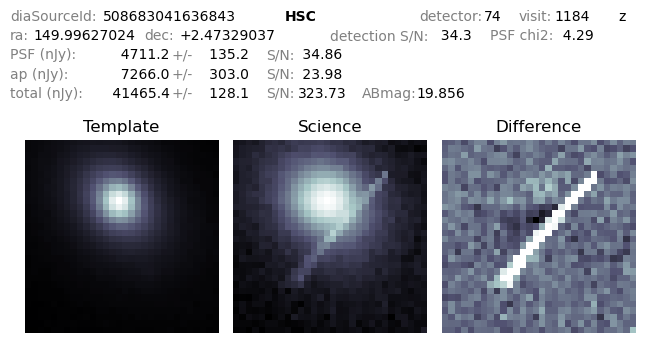

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.99627024354413+2.4732903652522786&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

3.3950236104861102


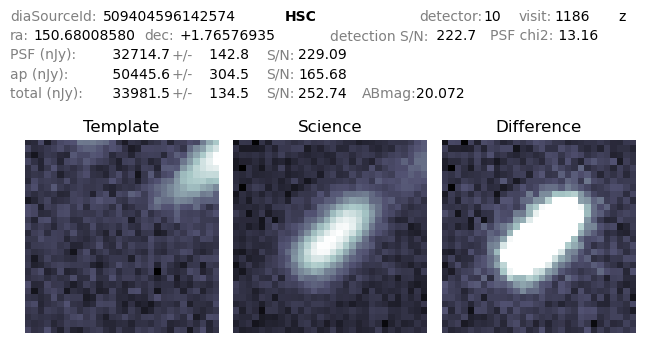

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.68008580039412+1.7657693496656142&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.8754440268542112


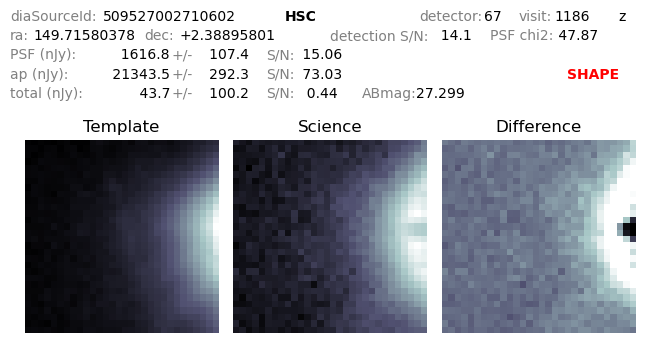

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.71580378375612+2.3889580130467976&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


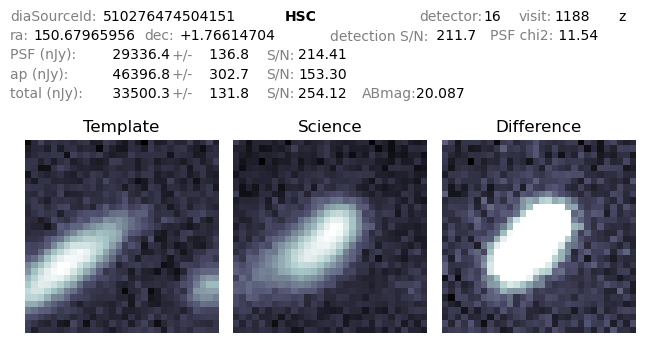

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.67965955595432+1.7661470389998237&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.8052348143853718


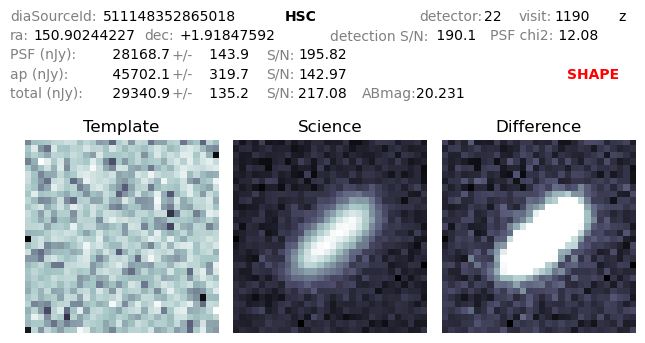

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.9024422749995+1.9184759224324448&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.8041123739684066


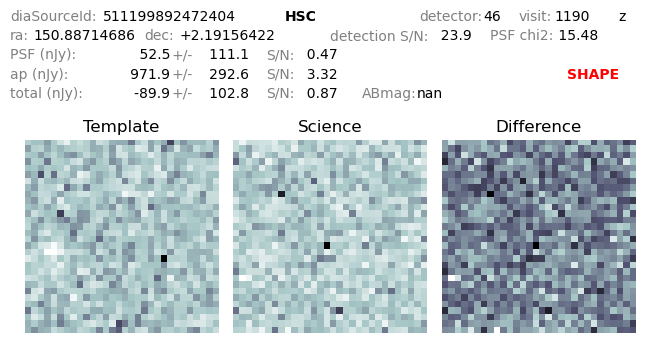

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.8871468605309+2.19156422087997&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


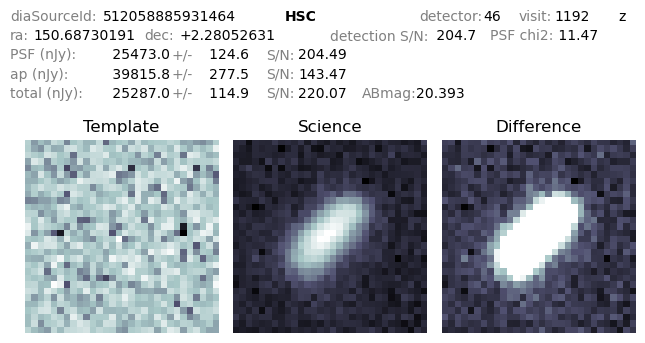

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.68730190975677+2.2805263080810847&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8412375009109194


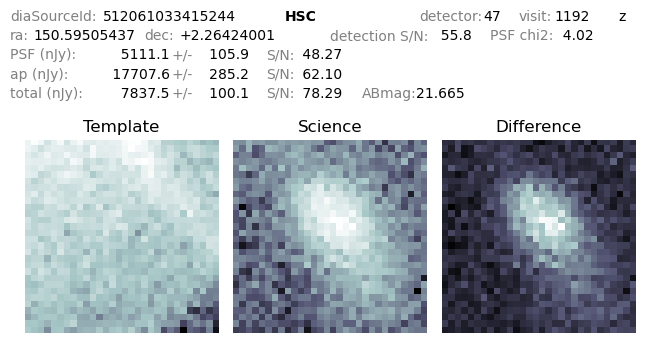

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.59505437364436+2.264240013430634&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.885765524543561


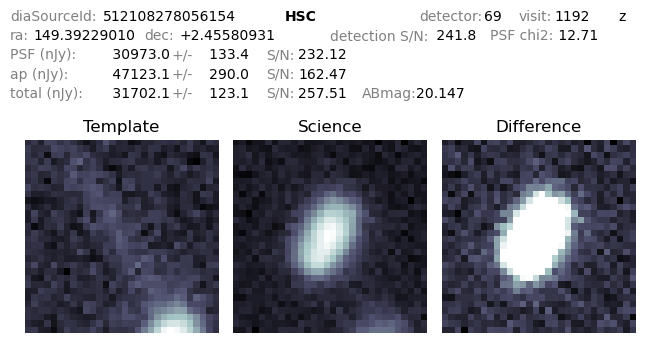

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.3922901047158+2.4558093074257594&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.5018665827327606


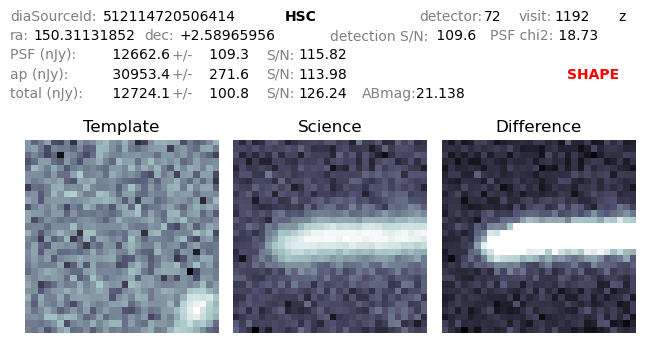

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3113185152699+2.589659557876936&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

5.134678071603191


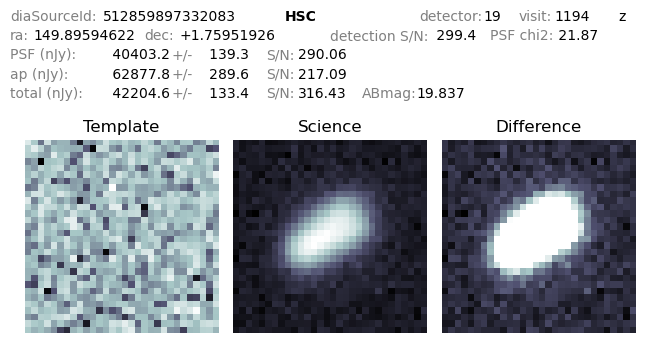

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8959462238568+1.7595192575532683&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8323839668147288


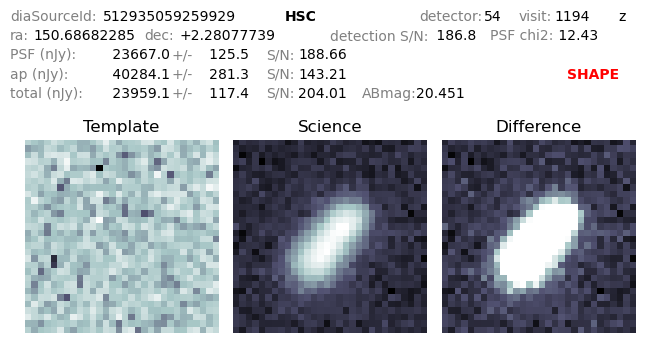

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.68682284756073+2.280777392080334&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.7383446458715739


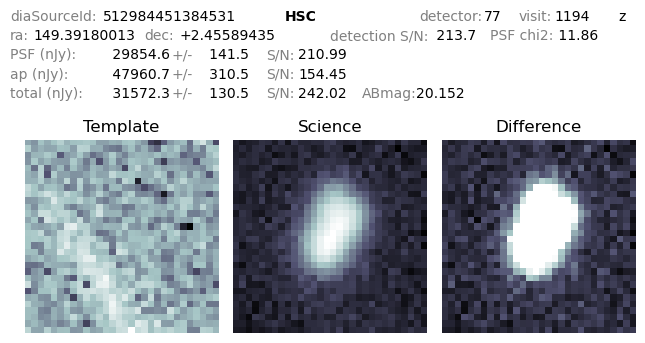

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.39180013156252+2.455894348087198&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6393940298691194


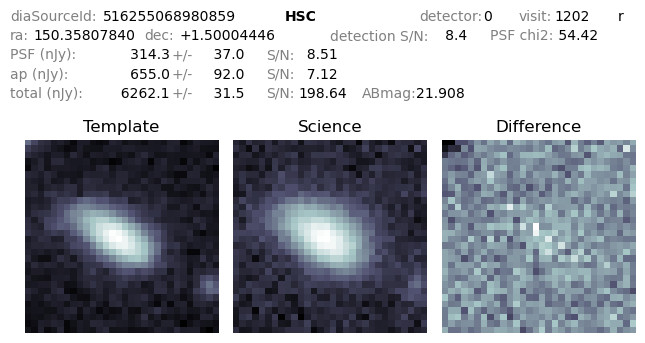

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.35807840383512+1.5000444600925118&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.9196156966863083


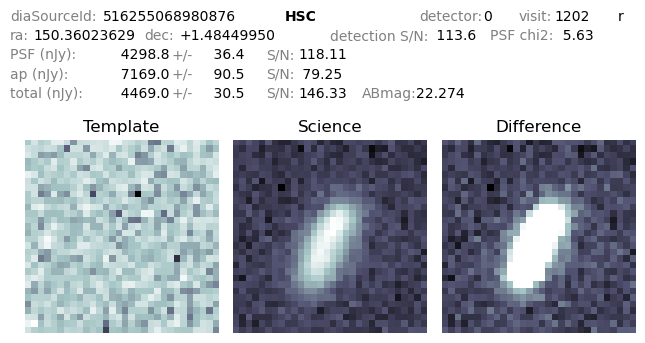

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.36023629083311+1.4844995016000433&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8949873267027373


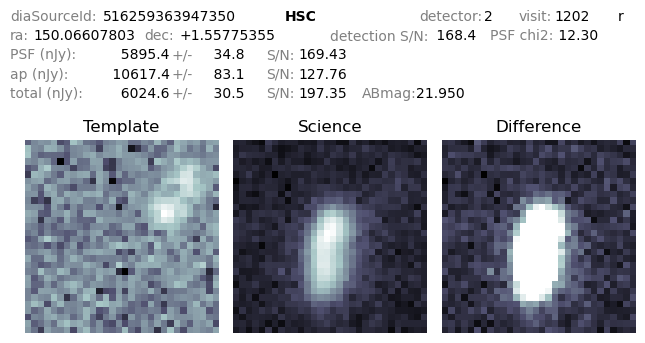

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.06607802712094+1.5577535545774785&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.9436807548133466


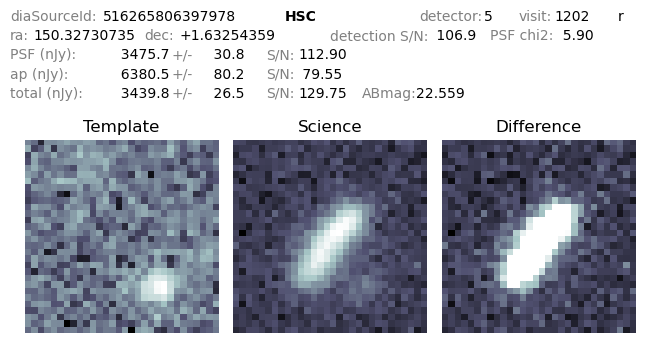

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.32730735231502+1.632543592675361&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

2.1265996539530025


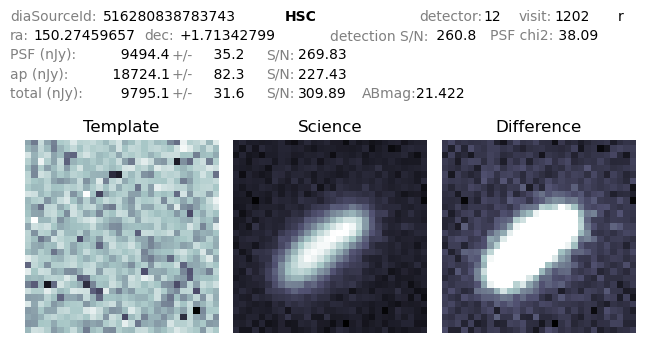

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2745965698133+1.713427988213258&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.2596348555439314


In [51]:
paths=filteredData['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if source["apFlux"]/source["psFlux"] >= 1.5:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])

(array([84.,  9.,  2.,  2.,  1.,  1.,  0.,  0.,  0.,  1.]),
 array([  4.01532291,  59.60074407, 115.18616523, 170.77158639,
        226.35700755, 281.94242871, 337.52784987, 393.11327103,
        448.69869218, 504.28411334, 559.8695345 ]),
 <BarContainer object of 10 artists>)

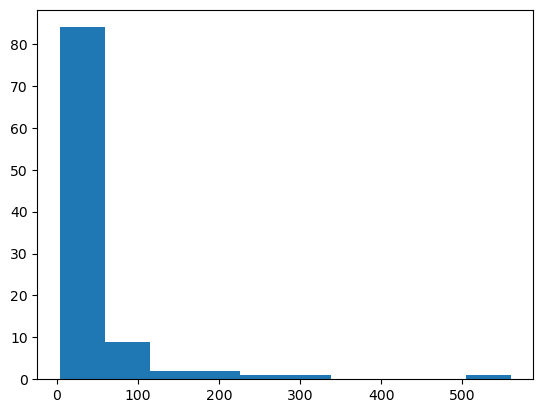

In [52]:
plt.hist(filteredData['psChi2']/filteredData["psNdata"])

## apFlux/psFlux ratio < 1.5 and totFlux/psFlux > 1.1

I wanted to see if flux ratios in addition to the reduced chi^2 could find bad sources. After experimenting with the ratios, I did find that you could find bad sources looking at ap/psf fluxes with a ratio less than 1.5 but total fluxes greater than 1.1. However, it's not entirely consistent as some solar system objects appeared as well. It is possible, if looking at a larger subset, doing a SNR cut could filter out the solar system objects. To really see if this consistently identified bad sources I'd likely have to look at more than 10000 sources, but with only  6 appearing out of 10000 I'm not sure this is a worthwhile and consistent way of finding poor

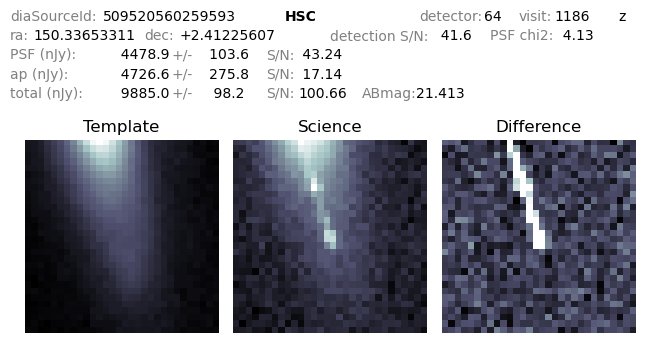

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.33653311299705+2.412256066301369&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6242779127225182


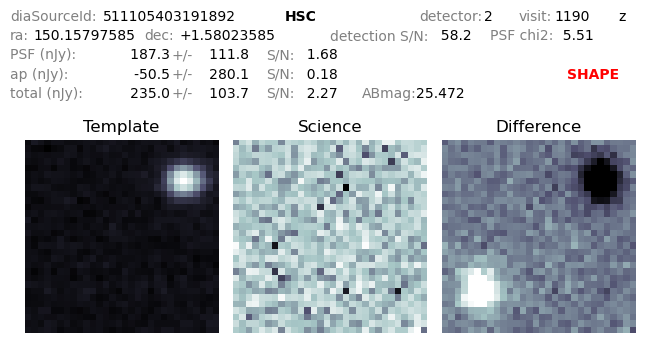

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15797585383777+1.5802358481942684&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4549044201069525


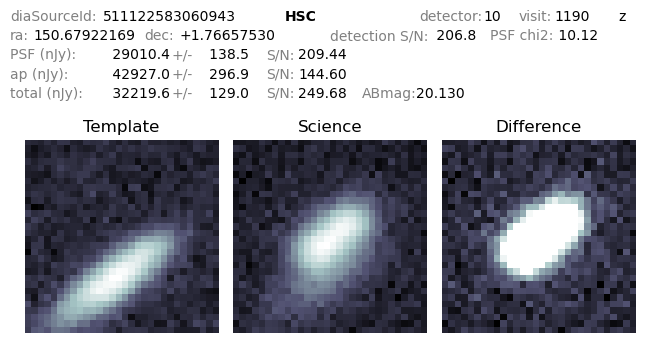

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.67922168983694+1.7665752964260177&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.7414334993858713


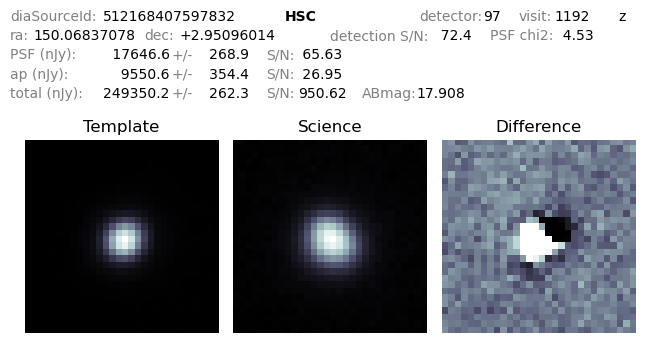

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.06837078305009+2.9509601356546167&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5425776784895258


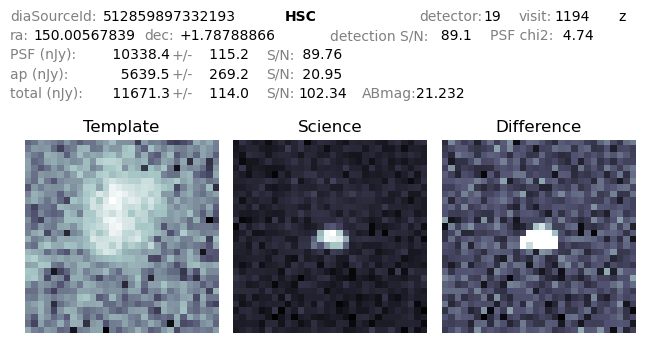

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.00567838749404+1.7878886610806708&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5159657346968225


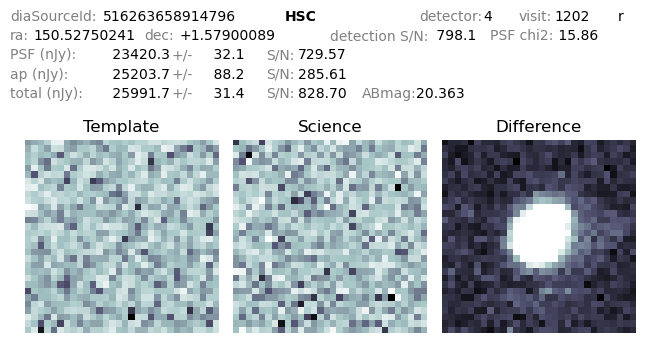

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.52750241278028+1.5790008928646817&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5021784380182416


In [53]:
paths=filteredData['diaSourceId']

for index, source in filteredData[0:10000].iterrows():
    if source["apFlux"]/source["psFlux"] <= 1.5 and source["totFlux"]/source["psFlux"] >= 1.1:
        single_path = path_manager(source['diaSourceId'])
        display(Image(single_path))
        make_simbad_link(source['ra'], source['decl'])
        print(source['trailLength'])

(array([84.,  9.,  2.,  2.,  1.,  1.,  0.,  0.,  0.,  1.]),
 array([  4.01532291,  59.60074407, 115.18616523, 170.77158639,
        226.35700755, 281.94242871, 337.52784987, 393.11327103,
        448.69869218, 504.28411334, 559.8695345 ]),
 <BarContainer object of 10 artists>)

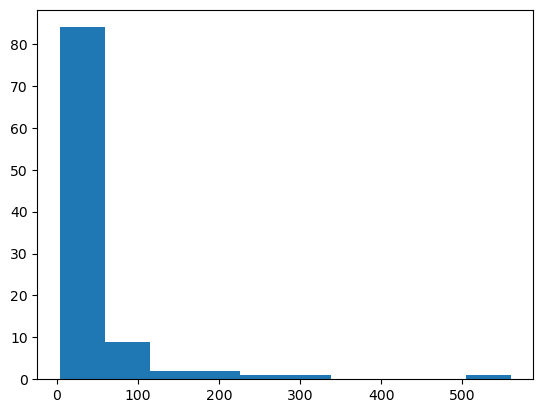

In [54]:
plt.hist(filteredData['psChi2']/filteredData["psNdata"])

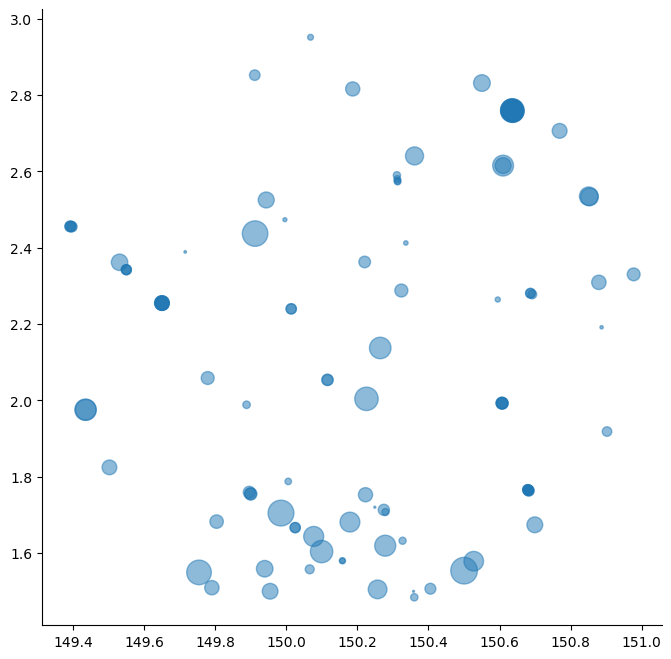

In [29]:
fig = plt.figure(figsize=(8,8))

cutoff = 0  # only plot DIA Objects composed more than cutoff DIA Sources

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.scatter(filteredData.loc[filteredData['snr'] > cutoff, 'ra'], filteredData.loc[filteredData['snr'] > cutoff, 'decl'], 
           c='C0', s=filteredData.loc[filteredData['snr'] > cutoff, 'snr'], marker='.', alpha=0.5)

# Non-Dipole Source w/ snr above 8.0 and negative aperture flux

This seems to find some bad sources but does not guarentee a source is bad. However, lookin at the negative flux with high snr does seem to find a larger number of "bad" sources.

Length of filtered data: 31


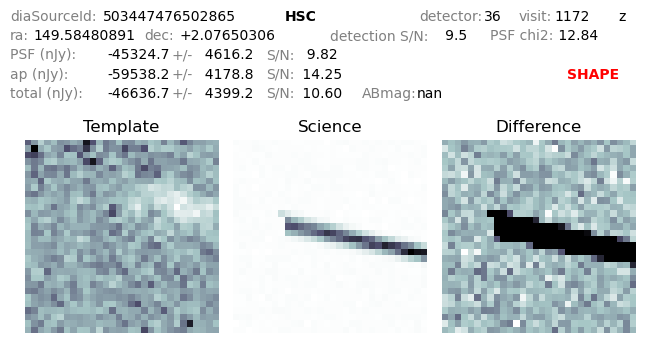

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.58480890993823+2.076503063672765&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


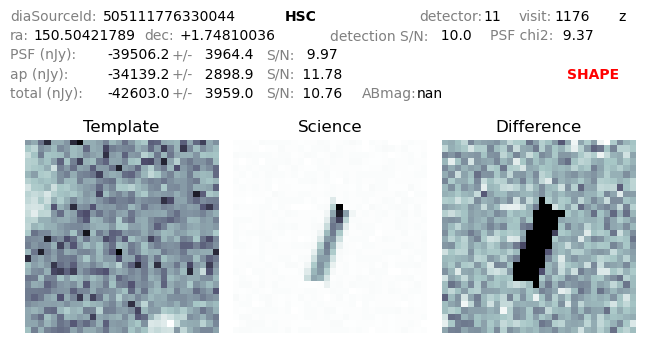

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.50421788712015+1.7481003565352207&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


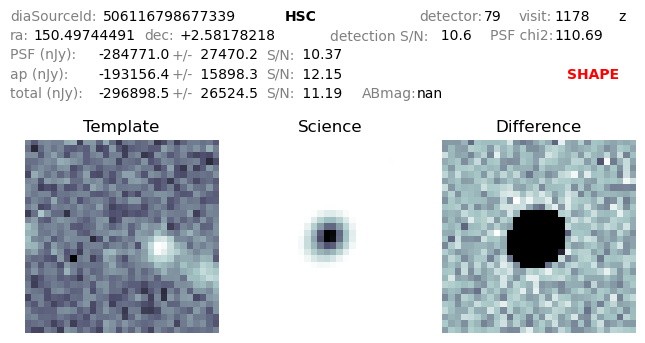

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4974449075851+2.5817821813390656&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


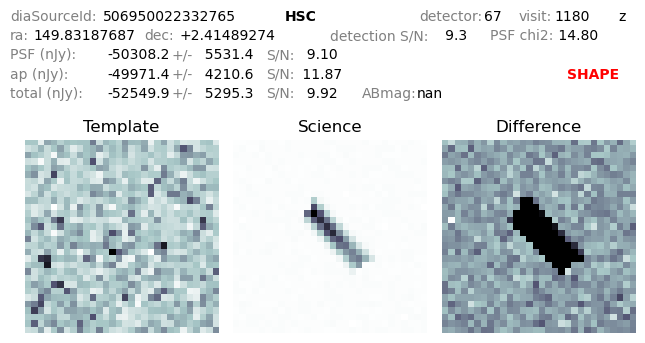

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.83187686589875+2.414892742272615&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


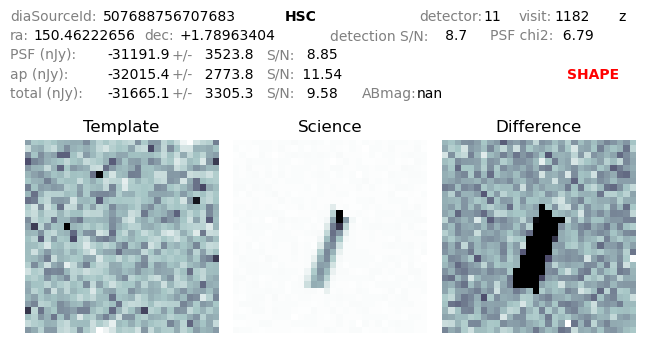

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.46222656439298+1.7896340419027683&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


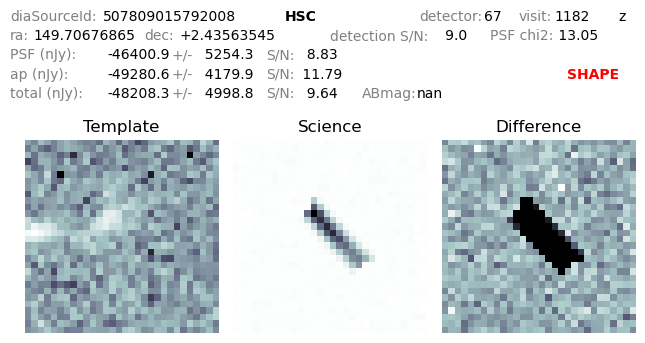

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7067686485846+2.4356354516097936&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


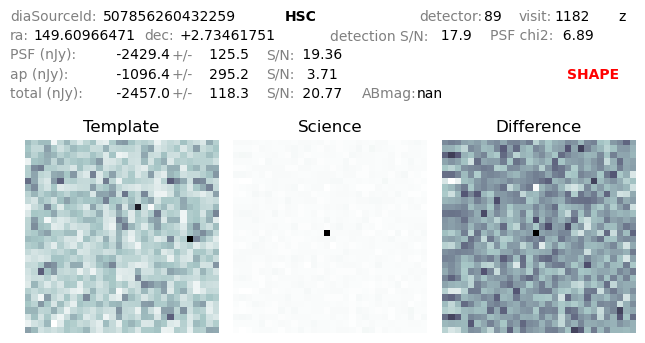

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.60966470837462+2.734617509825219&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


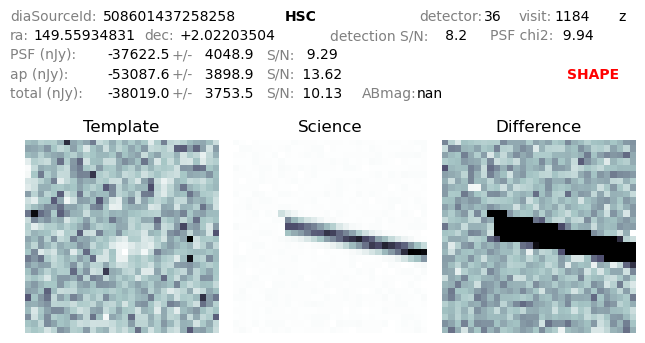

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.5593483056105+2.0220350355892602&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


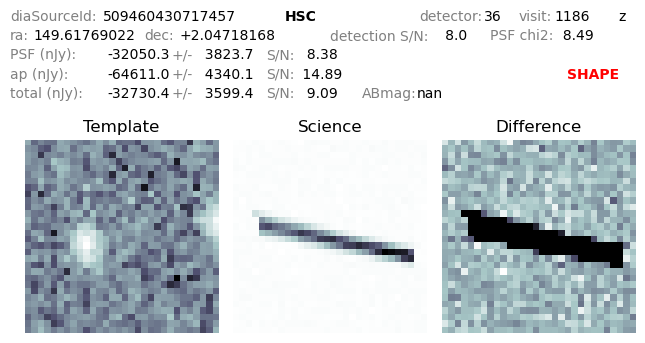

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6176902181534+2.0471816758761636&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


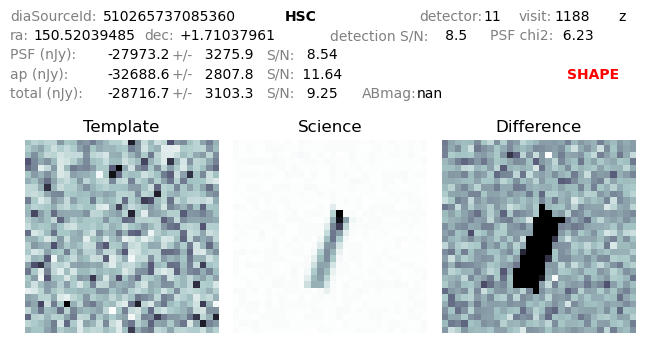

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.52039485000898+1.7103796108095324&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


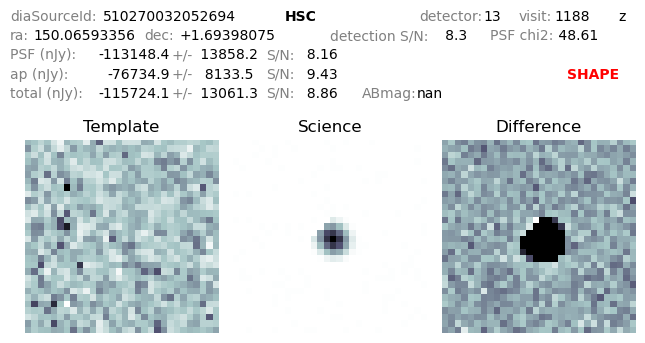

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.06593356484882+1.6939807489867023&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


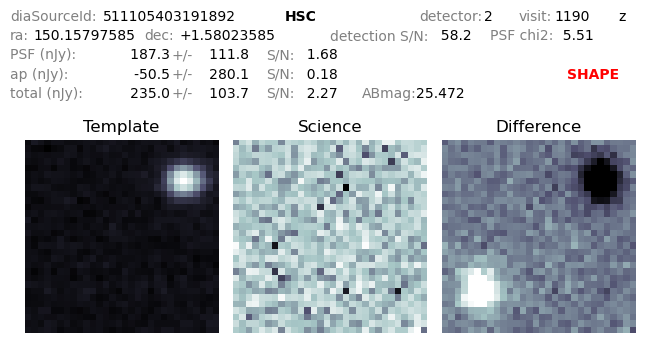

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15797585383777+1.5802358481942684&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4549044201069525


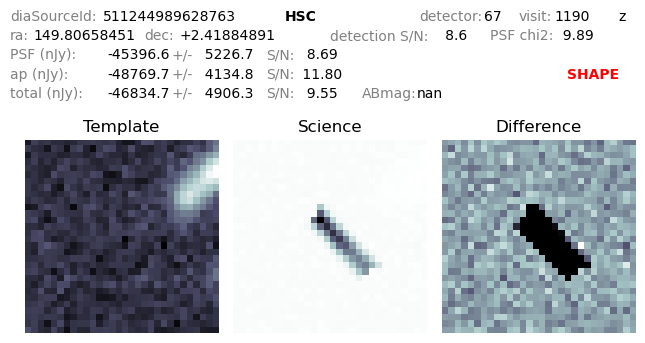

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.80658450562353+2.4188489108483124&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


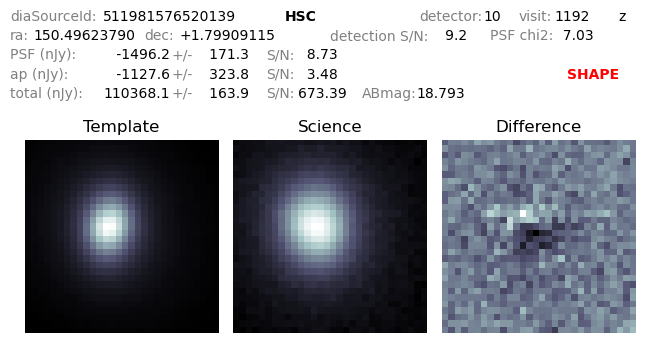

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.49623790326845+1.7990911524645676&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


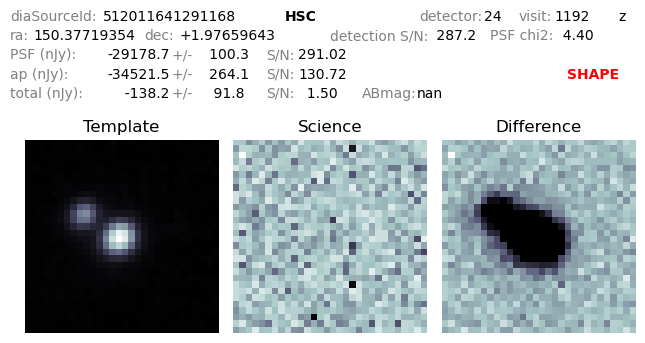

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3771935391013+1.9765964255970727&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


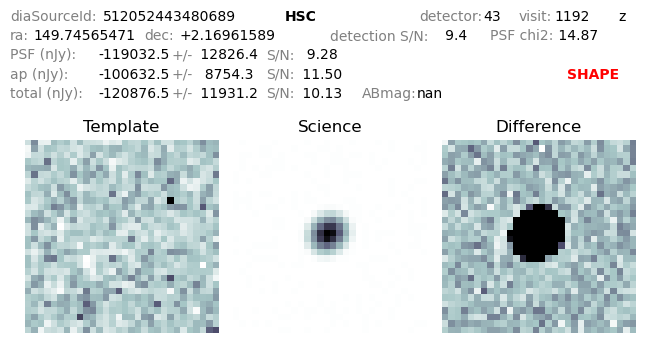

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.74565471191144+2.1696158933665646&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


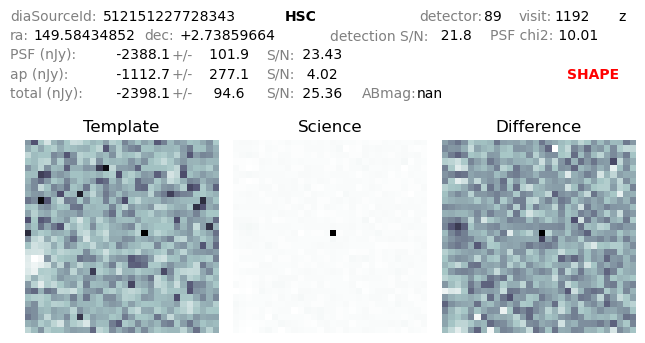

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.5843485199418+2.738596639648832&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


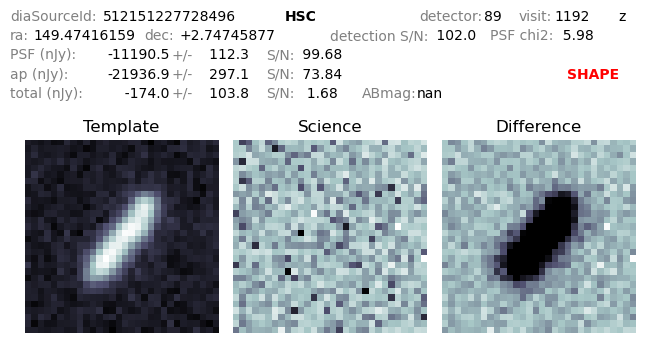

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.47416158701944+2.7474587748947026&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


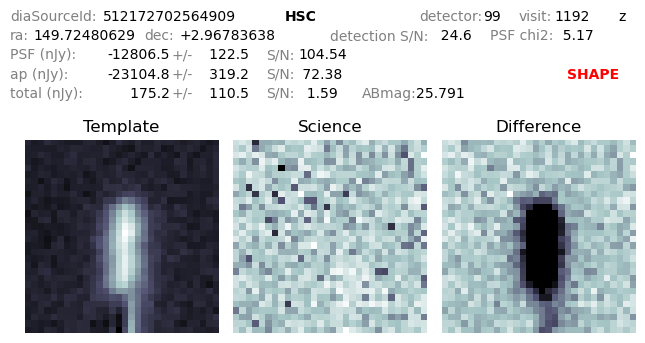

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.72480629228994+2.967836378329485&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


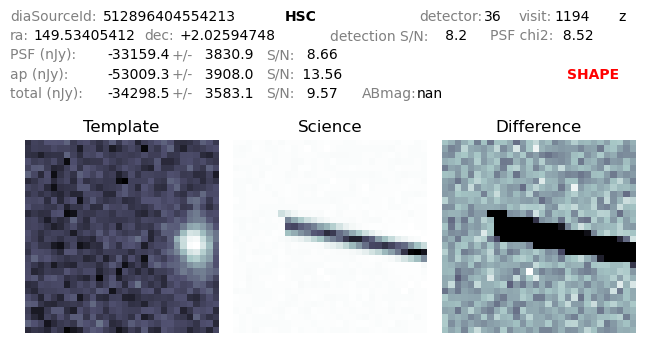

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.53405412211504+2.025947475976837&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


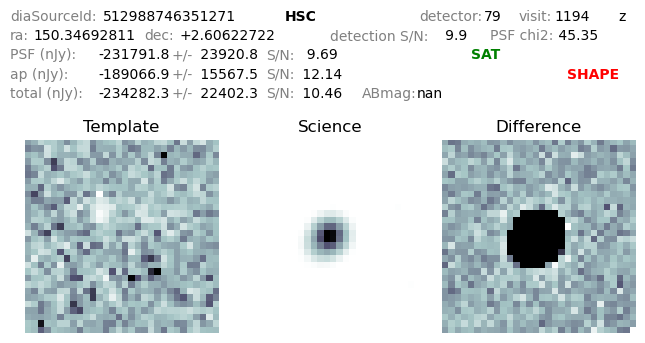

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.34692810736246+2.6062272230177537&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


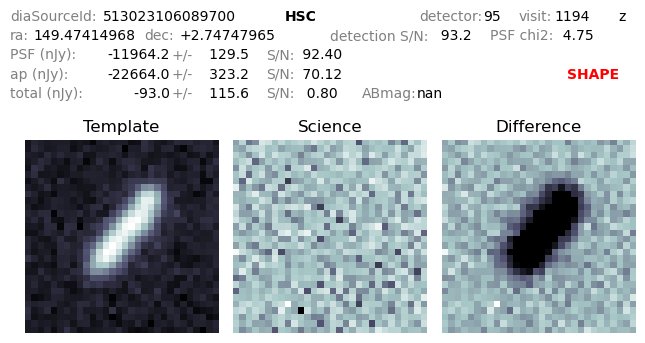

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.47414967905215+2.7474796457652686&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


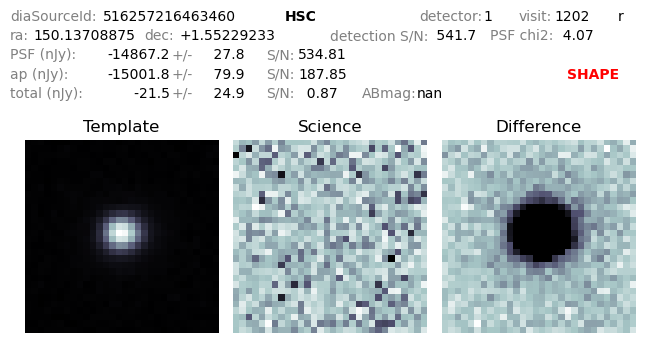

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.13708874540842+1.552292327480804&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


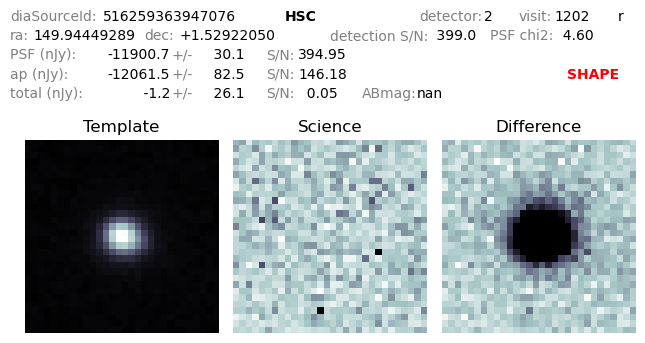

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9444928880133+1.529220497445968&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


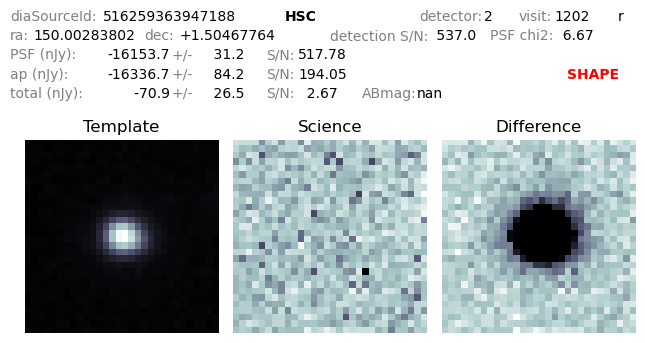

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.0028380232019+1.5046776424946011&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


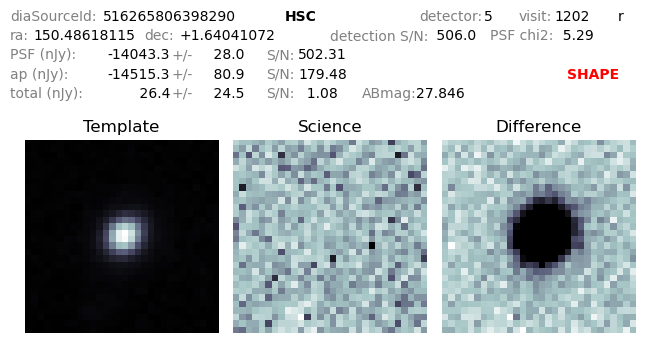

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.48618115289332+1.6404107235686667&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


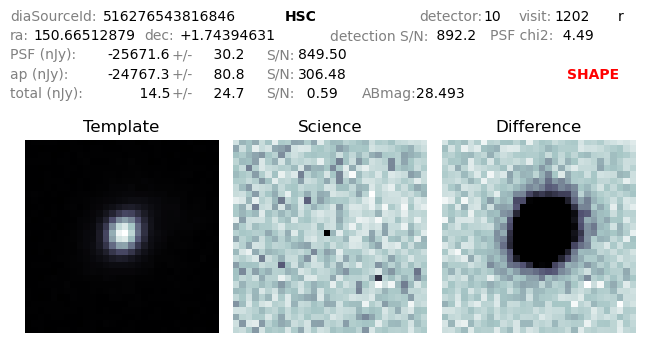

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.66512878973163+1.7439463079211224&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


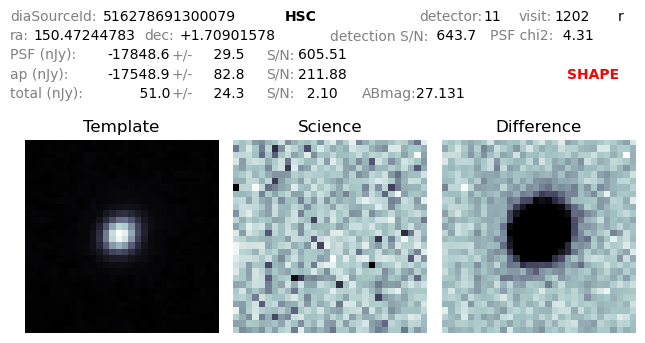

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.4724478339106+1.7090157772019396&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


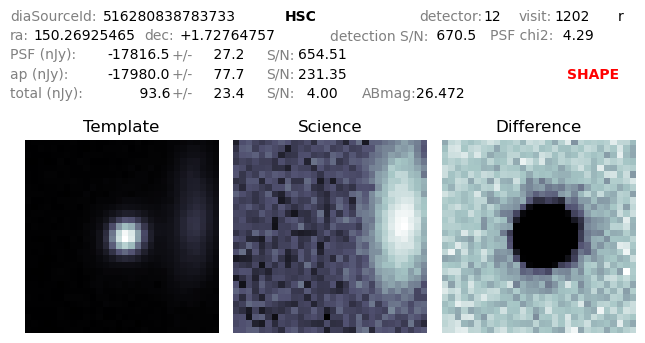

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.269254651494+1.7276475729010519&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


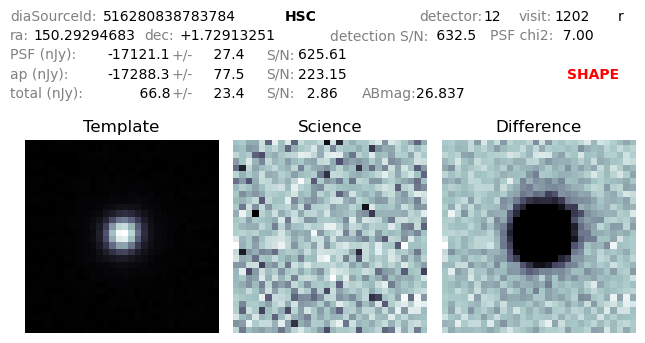

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2929468284317+1.7291325107460267&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


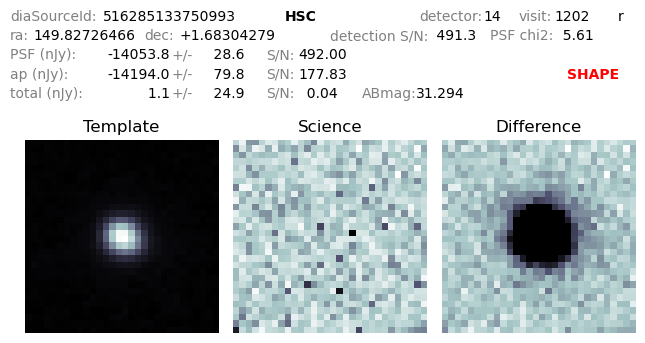

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.82726465787013+1.6830427885412143&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


In [55]:
filter_key=["isDipole", "apFlux", "snr"]
action_key=["bool", "le", "ge"]
value_key=[False, 0.0, 8.0]

filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)

for index, source in filteredData[0:10000].iterrows():
    single_path = path_manager(source['diaSourceId'])
    display(Image(single_path))
    make_simbad_link(source['ra'], source['decl'])
    print(source['trailLength'])


(array([26.,  2.,  0.,  1.,  1.,  0.,  0.,  0.,  0.,  1.]),
 array([  4.06920087,  14.73163682,  25.39407277,  36.05650872,
         46.71894467,  57.38138062,  68.04381658,  78.70625253,
         89.36868848, 100.03112443, 110.69356038]),
 <BarContainer object of 10 artists>)

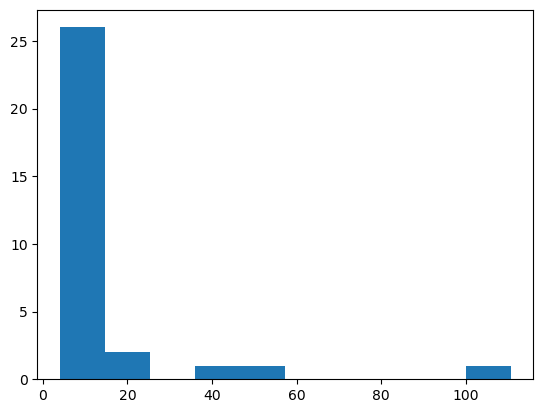

In [56]:
plt.hist(filteredData['psChi2']/filteredData["psNdata"])

# Non-Dipole Source w/ snr above 8.0 and positive aperture flux

Out of 100 sources which meet this criteria, ~6 look as if they are outright bad sources, the others appear to be various solar system sources.

Length of filtered data: 100


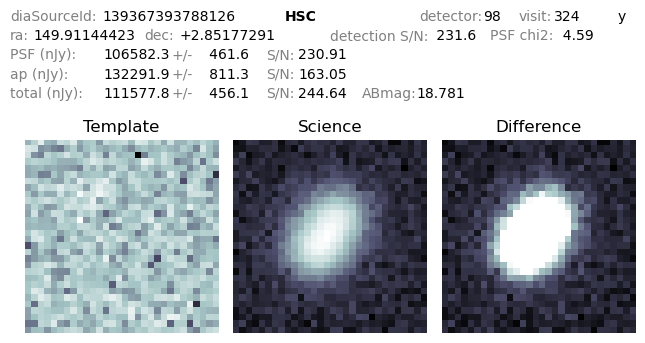

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.91144422548862+2.8517729080774763&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.600304412878315


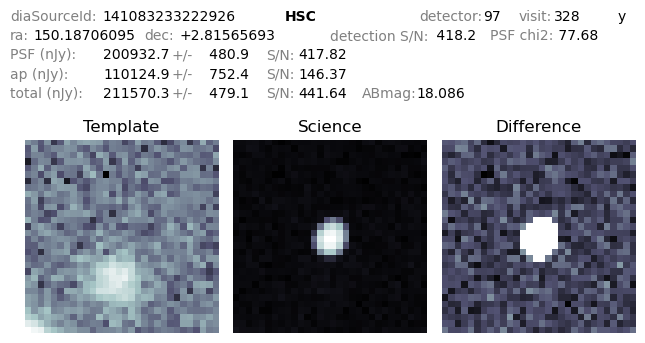

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.1870609488833+2.815656930298782&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.41680216556948174


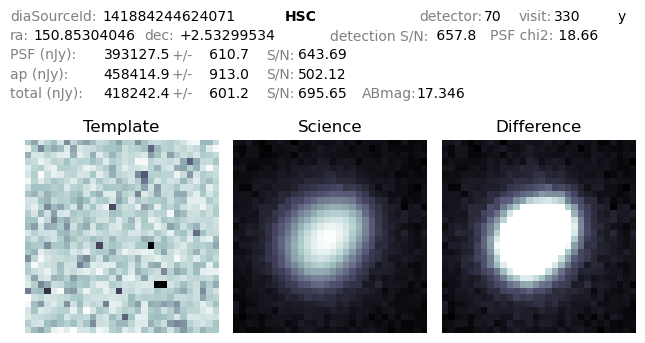

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.85304046385718+2.5329953413975725&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.306421638311347


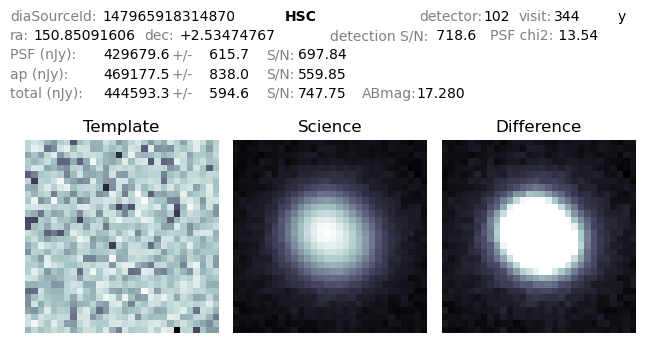

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.85091606053876+2.5347476702151206&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0195090709773558


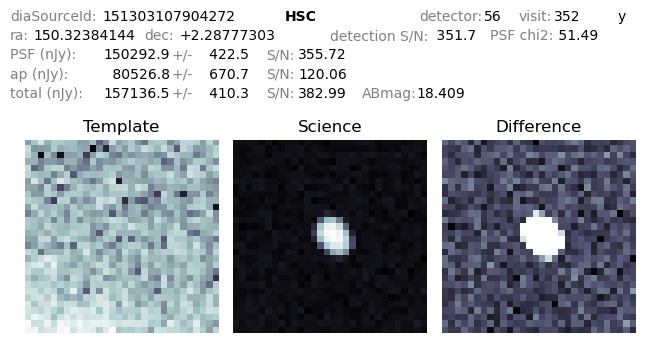

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3238414389082+2.2877730319815623&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6403042020760754


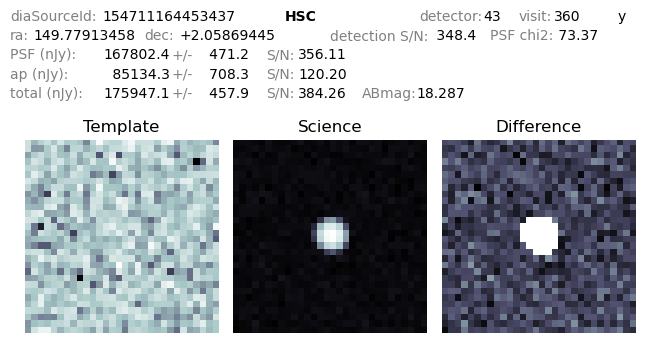

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.7791345832556+2.058694452677477&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.1469629564735447


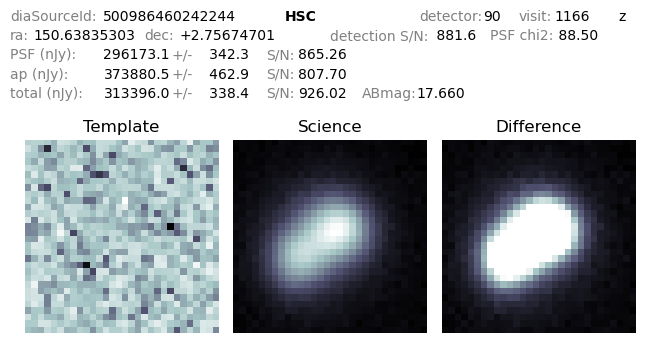

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63835303418523+2.7567470135966023&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8169425499079666


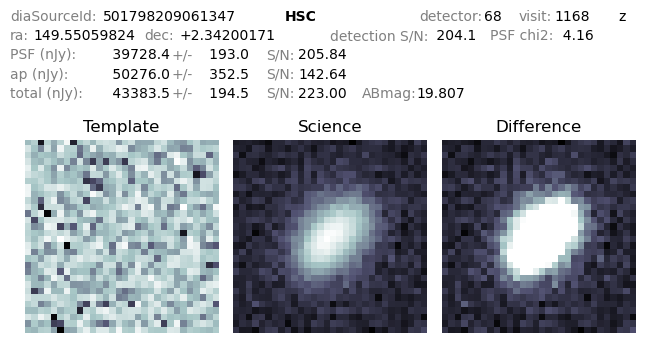

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.55059824224537+2.3420017065112213&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6008942953183578


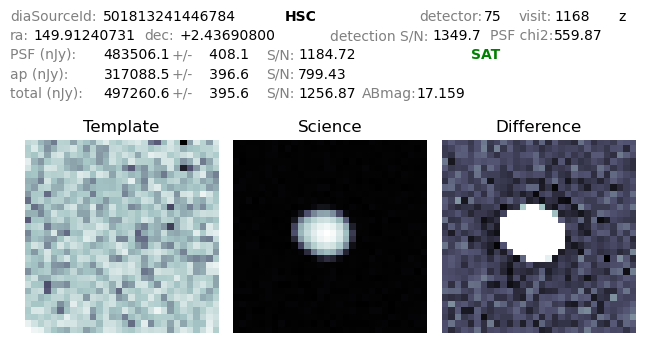

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.91240730504097+2.4369080012345163&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.696865662354185


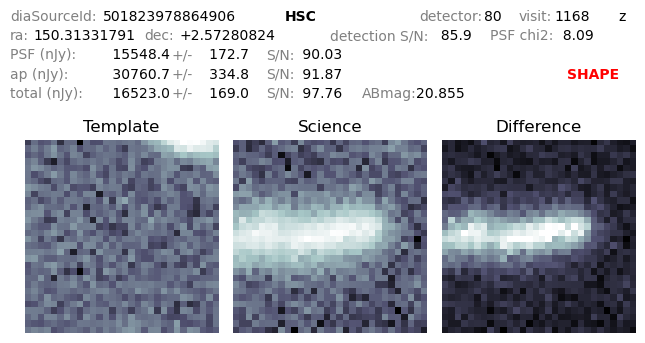

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.31331790598523+2.572808239634167&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


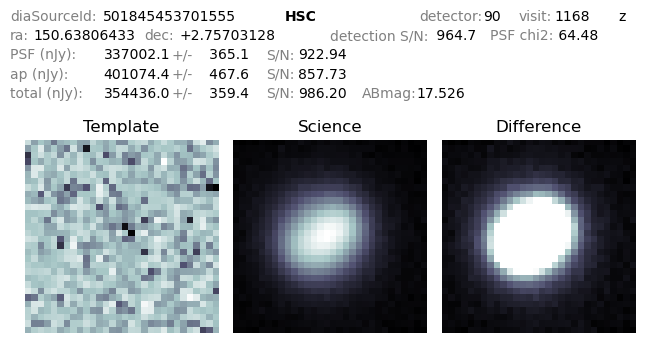

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63806432744184+2.757031278624003&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.2302055328411325


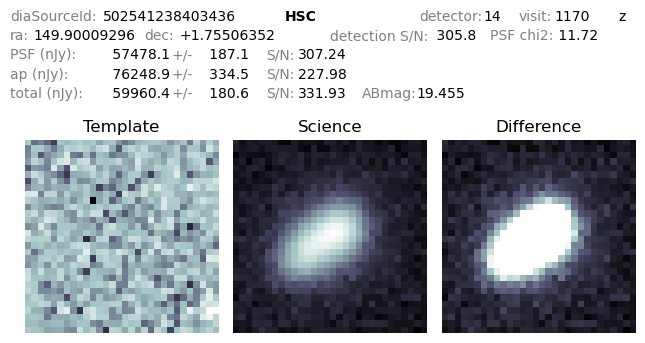

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.9000929645128+1.7550635233880552&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.7742125175286272


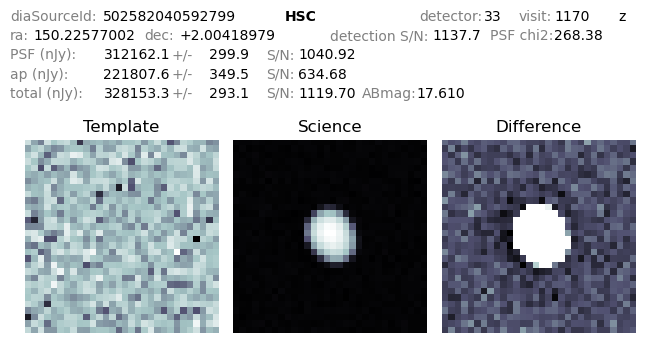

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.22577001904196+2.004189787528097&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6862705493484629


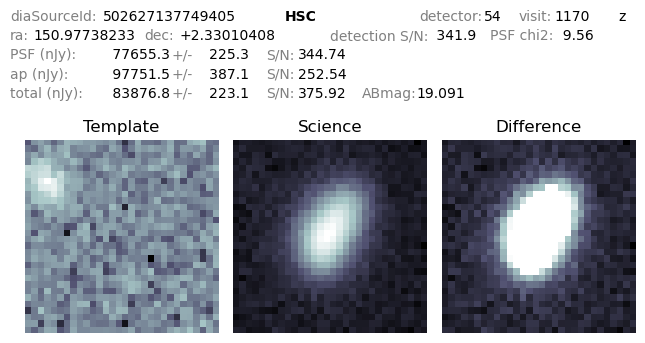

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.97738233055424+2.330104079746681&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.5537834939453916


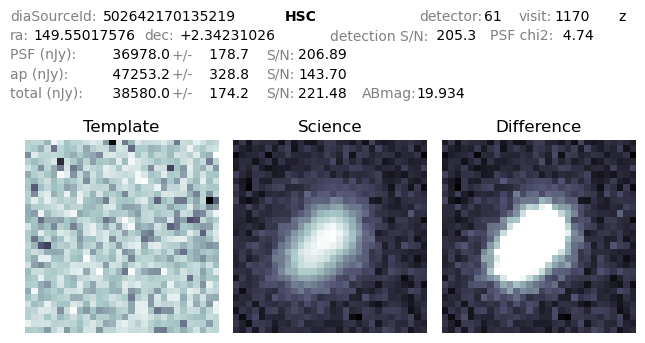

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.5501757641753+2.3423102635080153&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.684668648893542


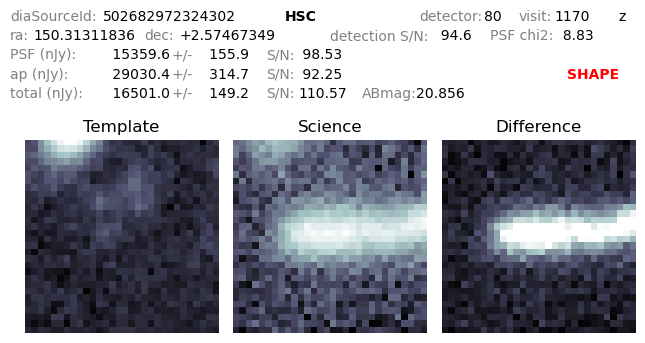

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.31311836129018+2.5746734890097196&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

4.943182484551458


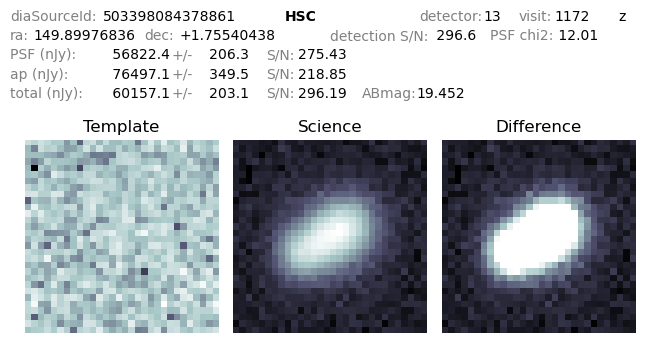

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.89976836015012+1.7554043846322303&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.9135951460751393


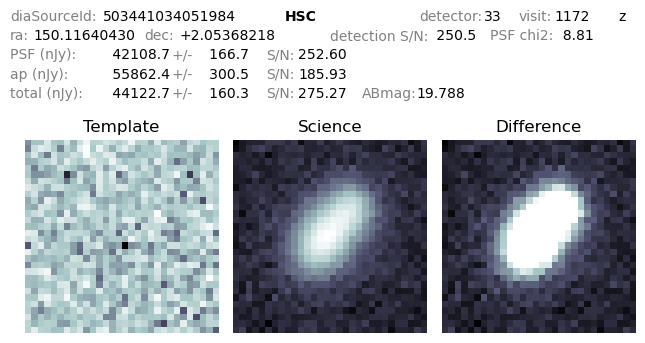

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.11640430271586+2.0536821782048125&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.9892659073685695


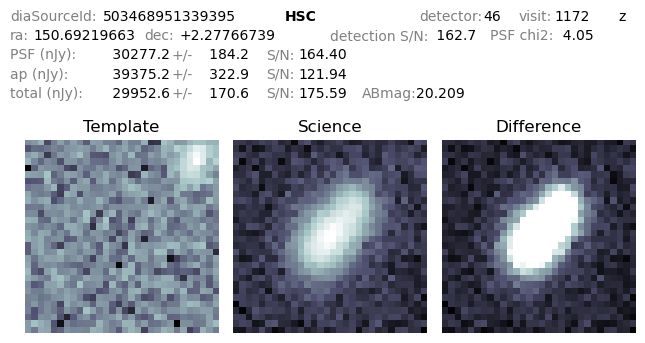

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69219663375088+2.277667390577445&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

2.044542862833172


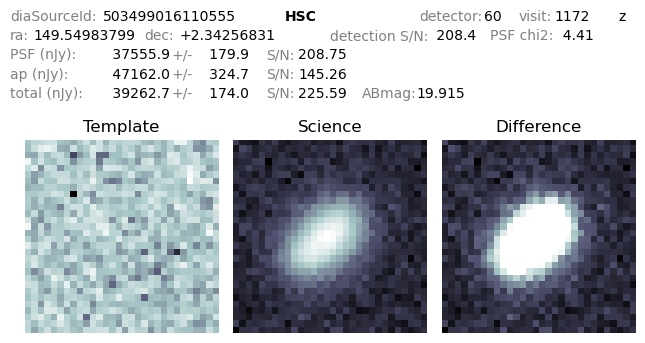

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.54983799479675+2.3425683062705698&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.658991261008138


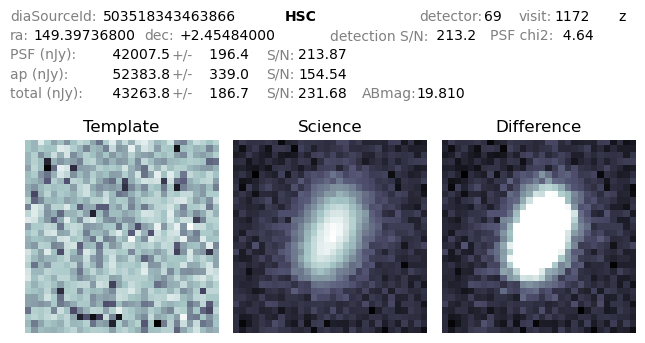

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.39736800308938+2.4548400003049444&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.7684362586887832


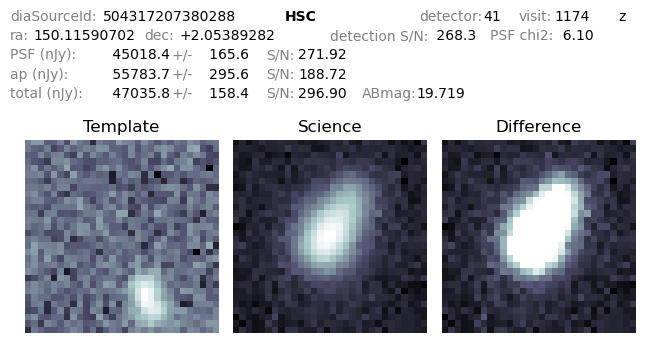

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.11590701939846+2.0538928199090853&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.7465859823004888


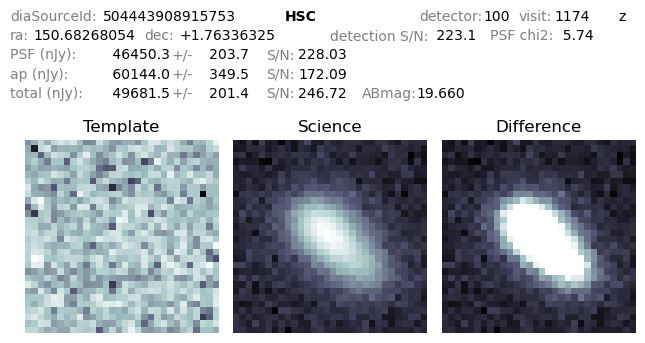

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6826805415315+1.7633632521490574&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.997227501335194


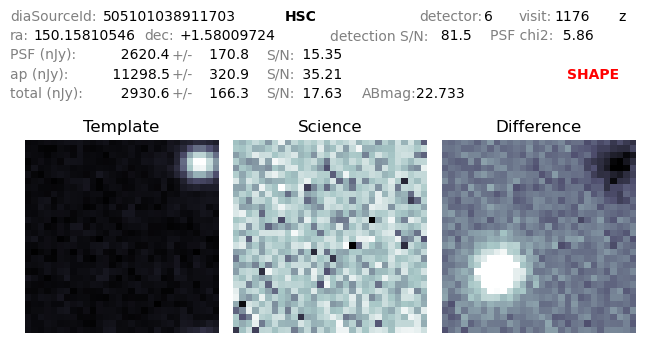

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.15810546377566+1.5800972363628587&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


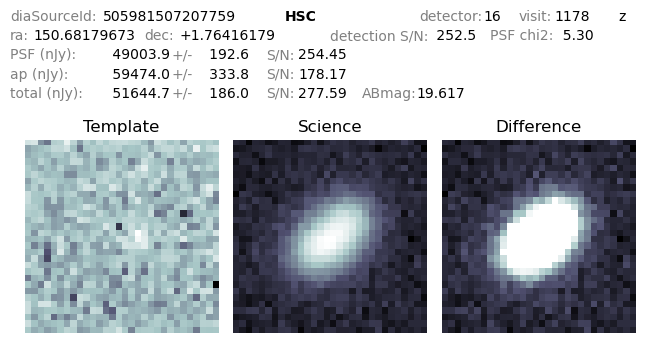

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6817967262876+1.7641617875202342&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6302035155166947


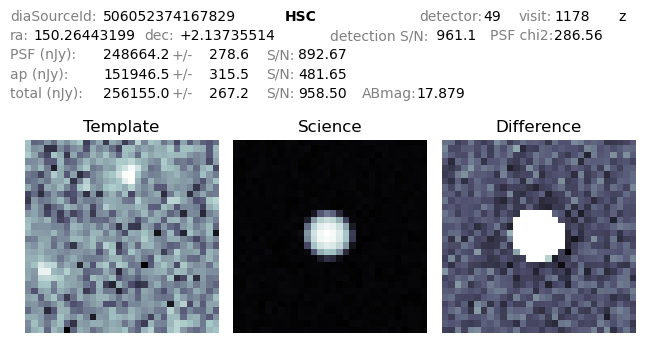

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2644319934536+2.137355137687791&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.31340223641576304


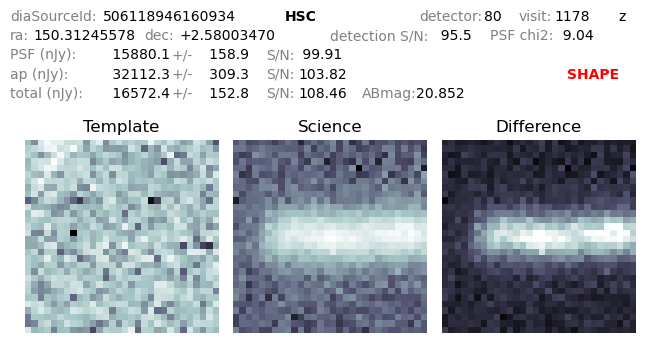

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3124557756205+2.5800346994254086&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
4.550951962585753


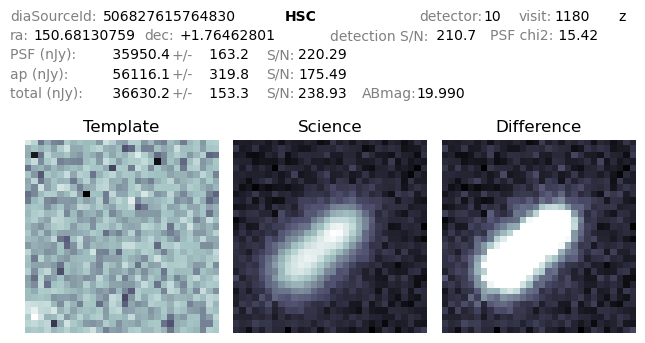

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6813075892321+1.7646280064899114&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.4374878344255815


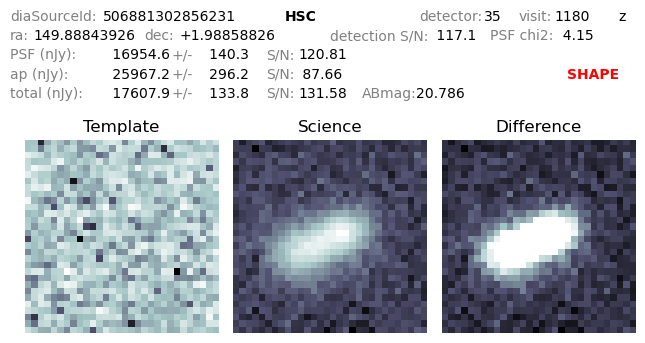

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.88843925736327+1.988588255680055&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.38794667901697594


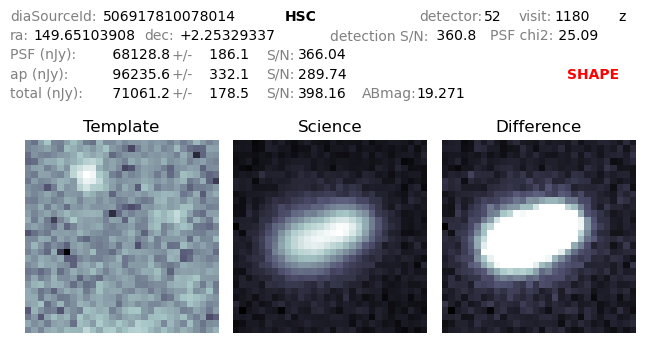

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.65103908447702+2.253293367900873&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


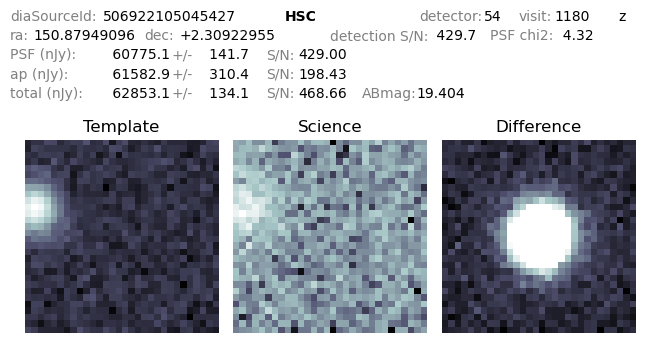

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.87949096318786+2.309229550931973&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5008783601058798


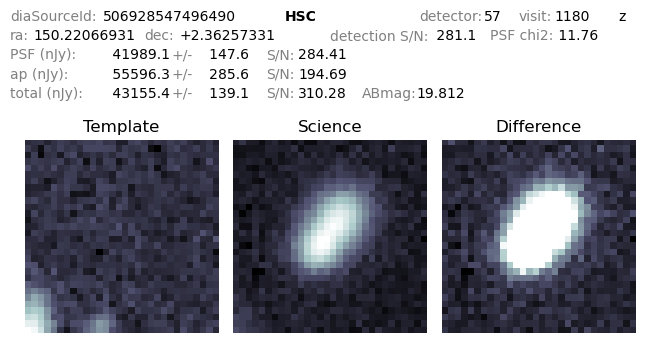

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.22066931303468+2.362573311994802&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.7806289517343117


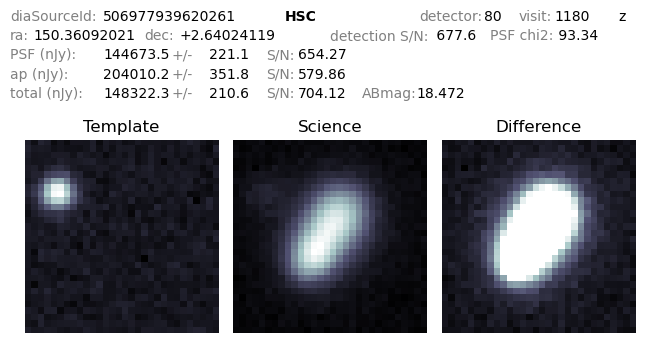

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.36092021024376+2.6402411865772764&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.96025977850351


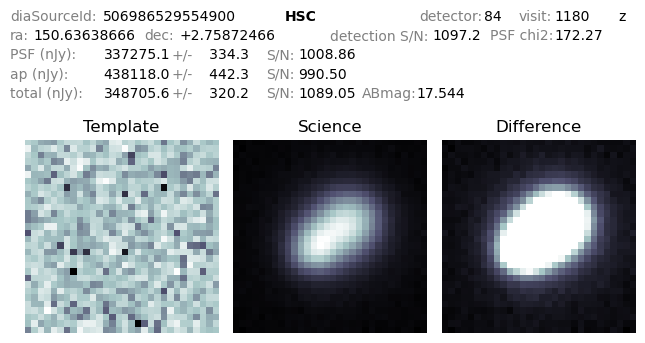

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63638665992167+2.7587246628667894&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6592127922904492


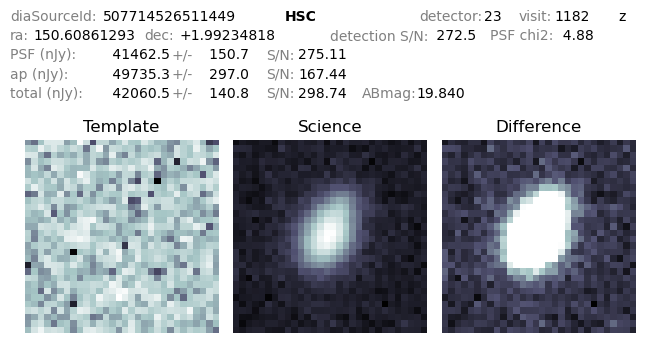

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.60861293253612+1.992348177819758&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.2841974965779557


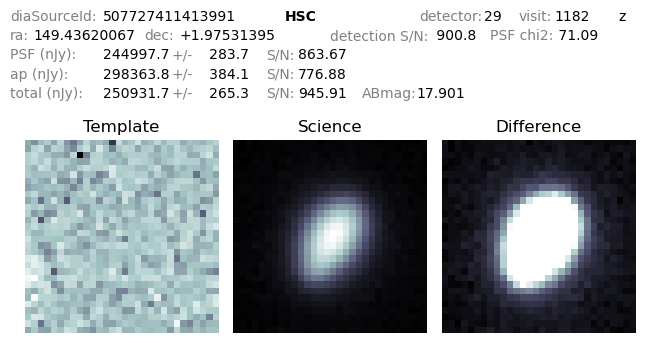

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.43620066530528+1.9753139508390922&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.3874160227851386


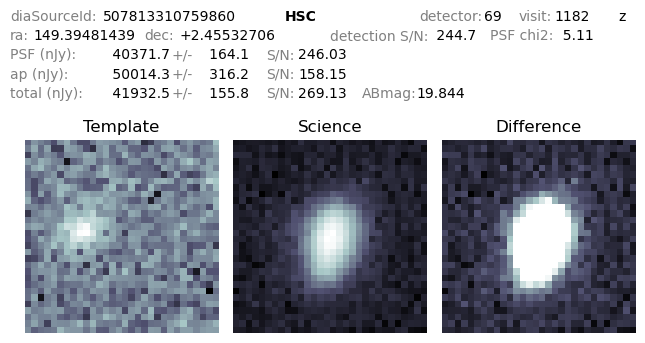

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.39481438757457+2.4553270559177065&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.3996816522953595


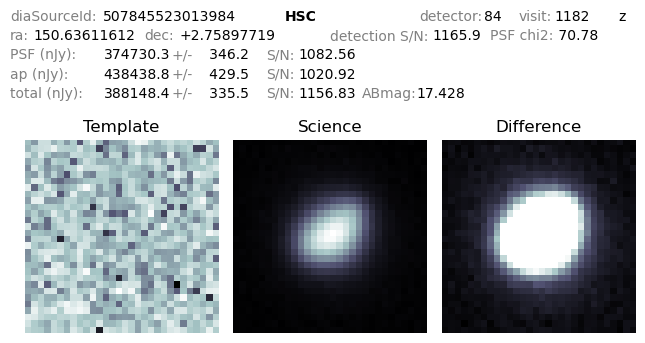

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63611612208348+2.758977188876583&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0880224638224658


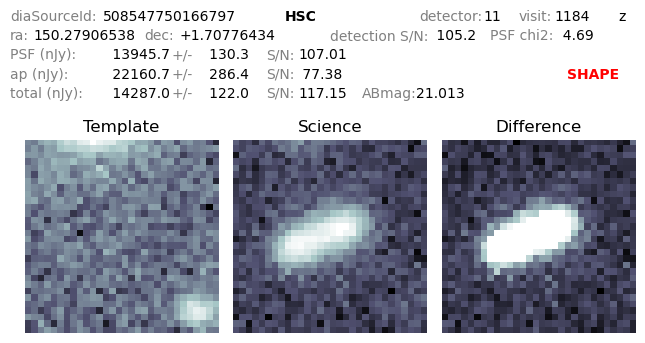

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.27906537585307+1.7077643412138694&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5981092778426498


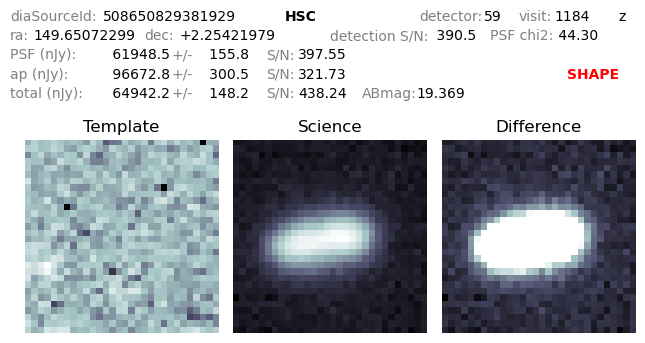

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.65072298737903+2.2542197859636395&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.3399930227226051


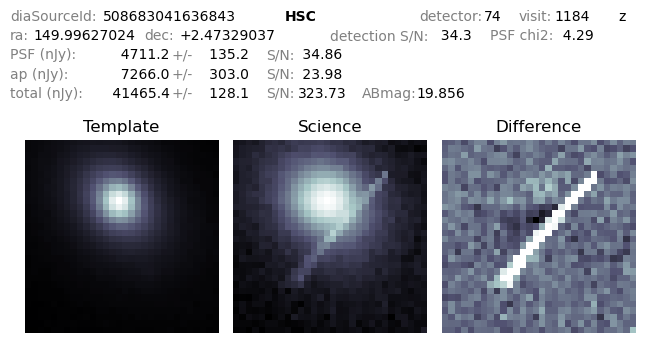

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.99627024354413+2.4732903652522786&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

3.3950236104861102


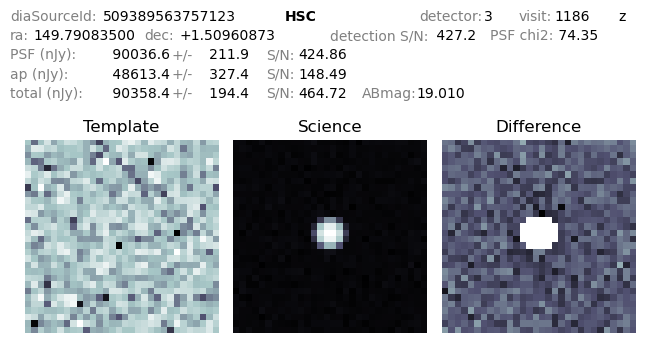

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.79083499591596+1.5096087263502012&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.17572490809194996


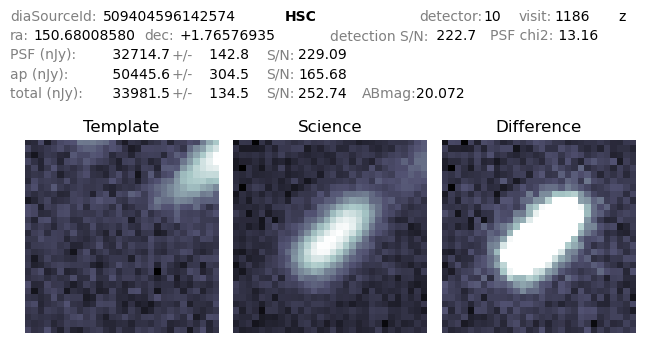

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.68008580039412+1.7657693496656142&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.8754440268542112


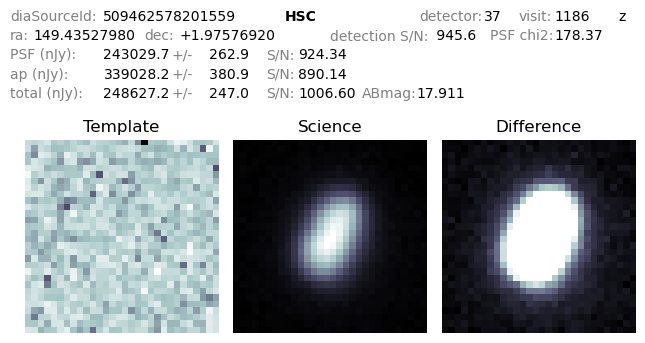

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.43527980497367+1.9757692003297476&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4725460639395662


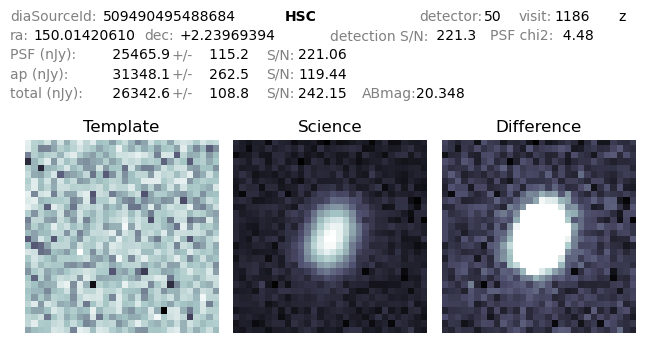

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.014206101002+2.239693944393016&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.1483154177833044


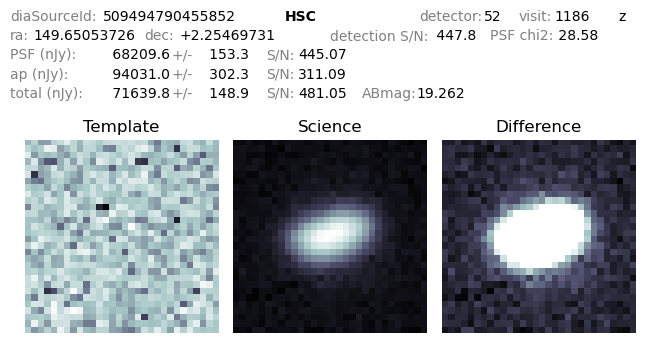

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6505372630069+2.2546973112379183&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4821639267169429


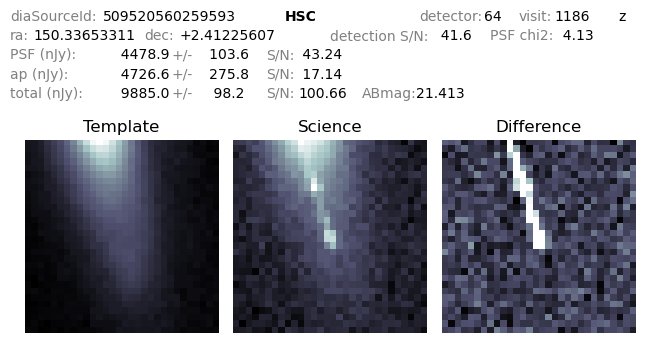

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.33653311299705+2.412256066301369&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6242779127225182


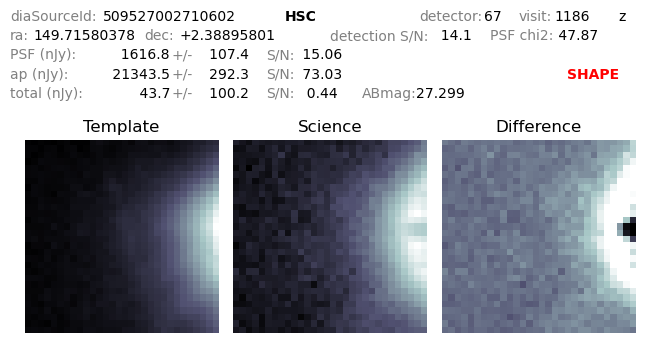

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.71580378375612+2.3889580130467976&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


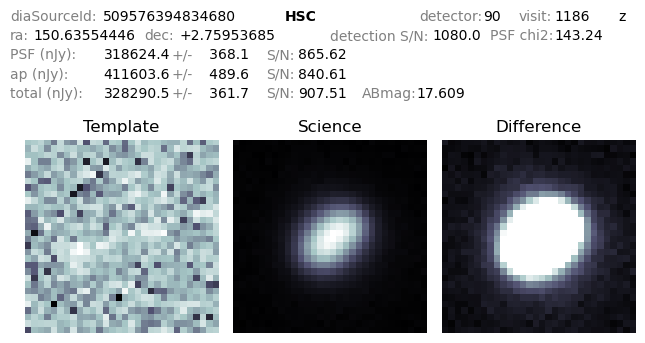

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.63554446284084+2.759536852841302&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.1119516833160974


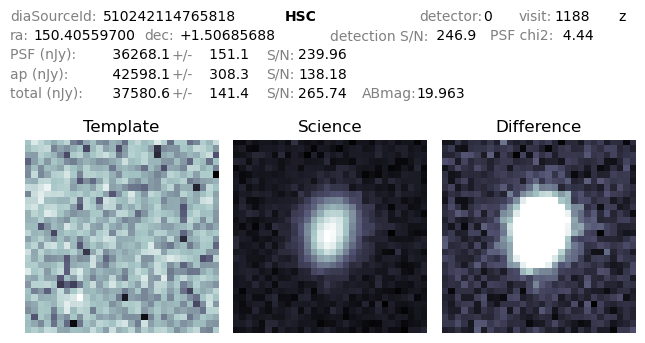

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.40559699796955+1.5068568841456018&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0269123885734113


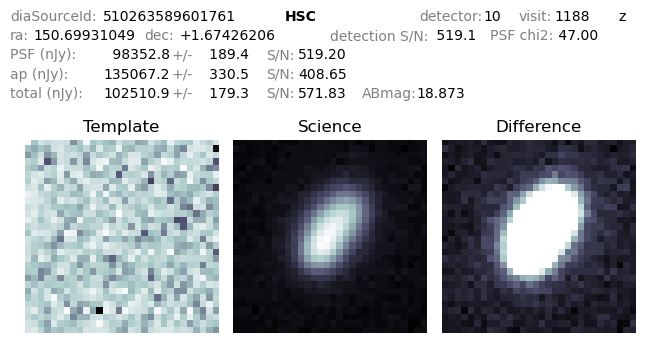

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.69931049167593+1.6742620636425656&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.5229924988634664


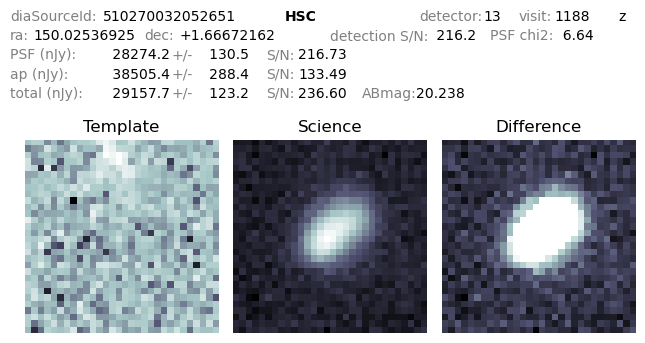

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.02536925145708+1.6667216189332725&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.402075397404506


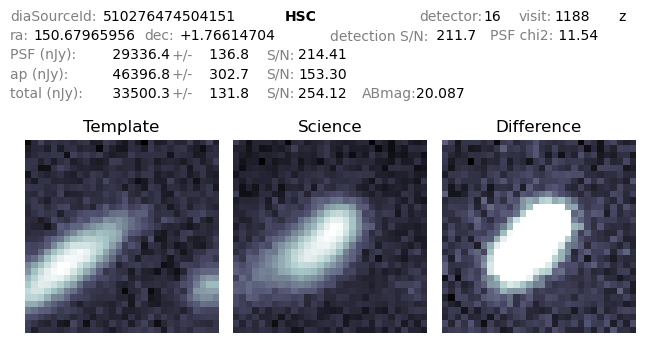

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.67965955595432+1.7661470389998237&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.8052348143853718


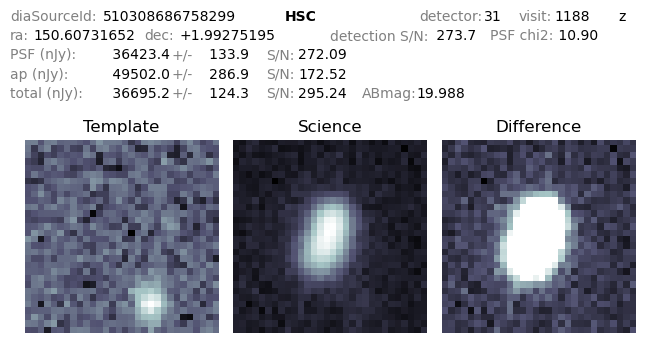

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.60731651640228+1.9927519458226102&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.4215527694526013


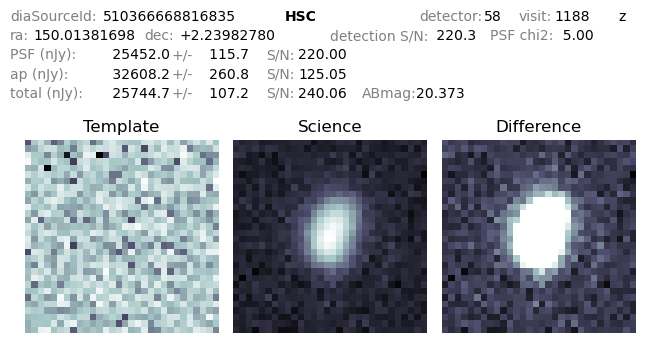

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.01381697738944+2.23982780427352&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.2490691660787479


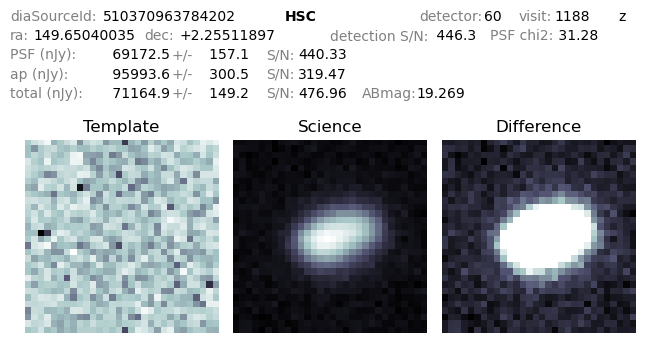

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.65040034631357+2.2551189701163414&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.4671347426997319


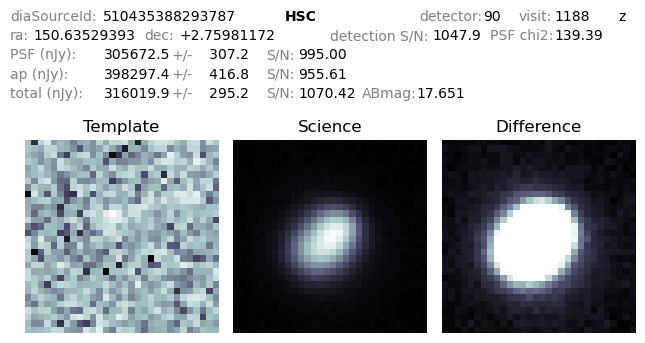

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.6352939270029+2.7598117175556256&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.0885301026419745


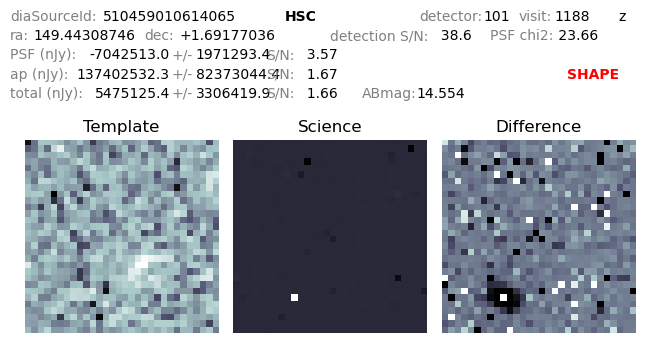

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.4430874627304+1.691770355676727&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

nan


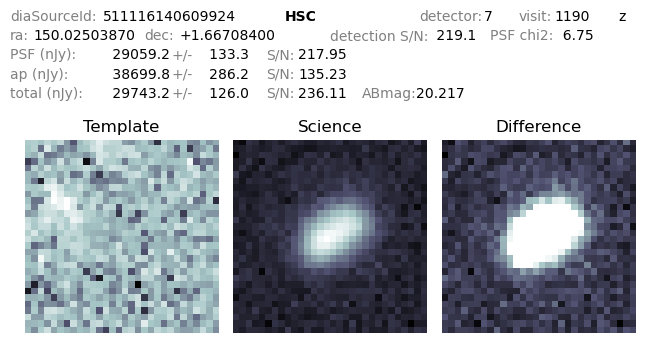

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.02503870285443+1.6670840012304735&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.3897867554196515


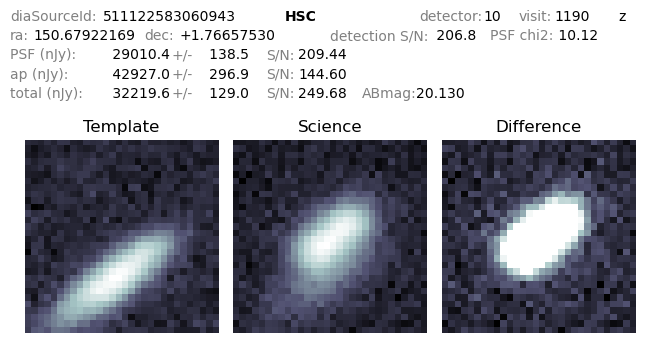

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.67922168983694+1.7665752964260177&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.7414334993858713


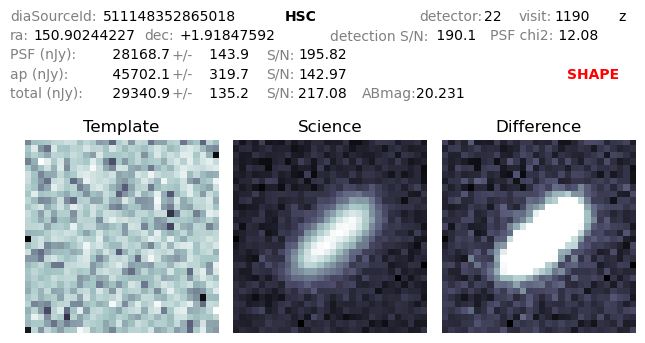

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.9024422749995+1.9184759224324448&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.8041123739684066


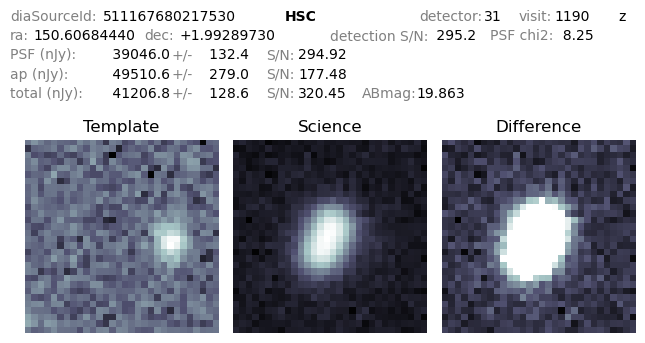

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.60684440395974+1.9928972959262856&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.2637531462774922


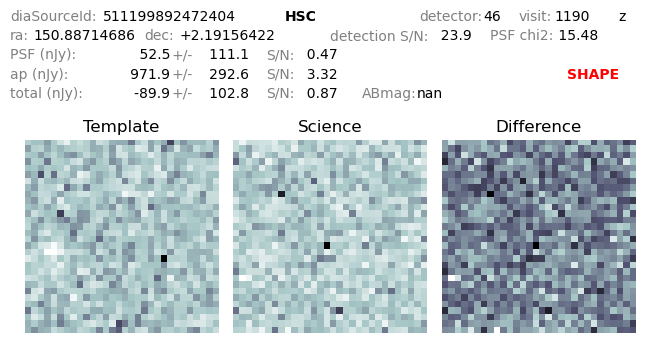

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.8871468605309+2.19156422087997&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
nan


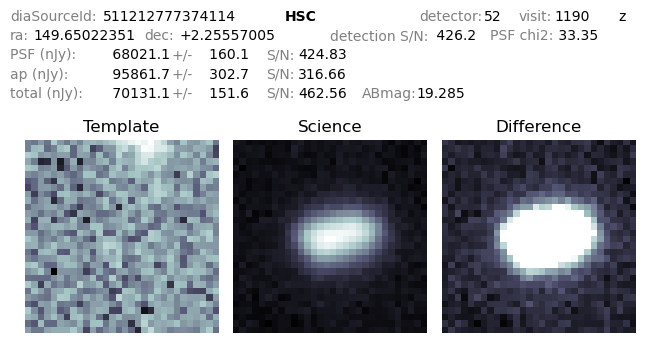

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.6502235112026+2.255570047218142&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.5606189596630804


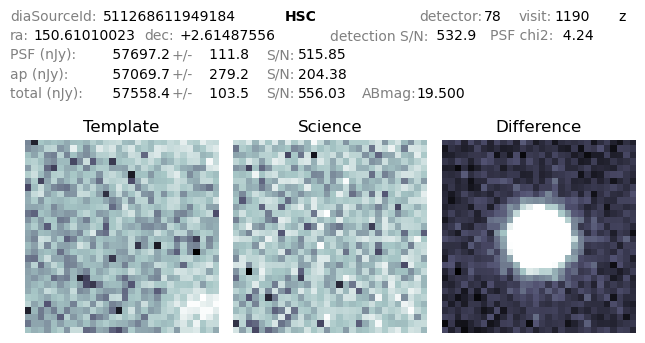

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.61010022928855+2.6148755583664856&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.07416400567948898


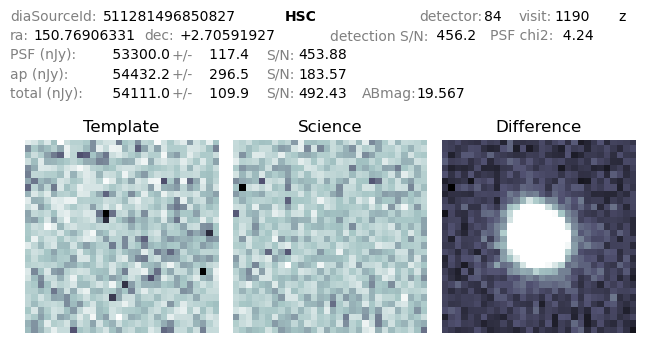

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.76906330735218+2.7059192683041853&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5005943316246629


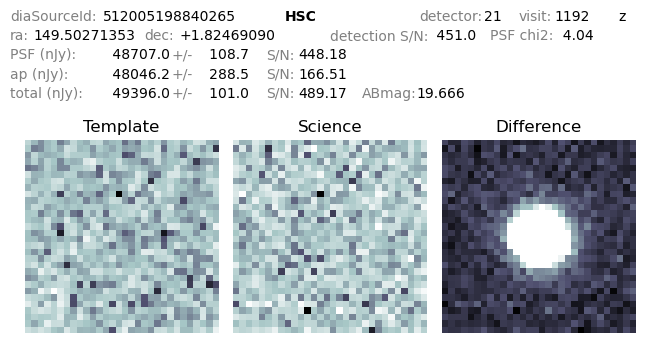

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.50271352948292+1.82469090259905&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.4907773691423838


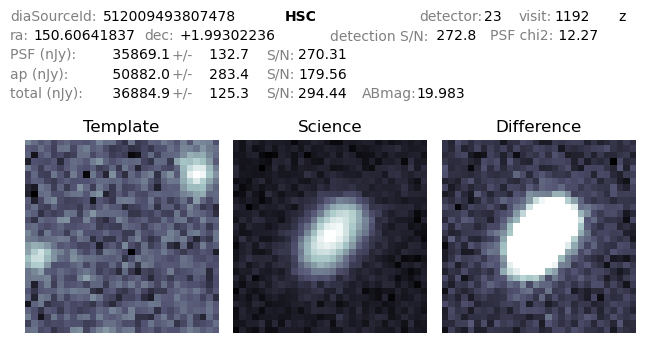

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.60641837241707+1.9930223647129235&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.4310749713667905


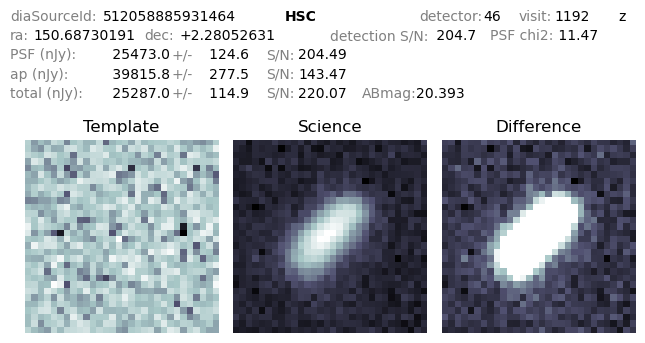

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.68730190975677+2.2805263080810847&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8412375009109194


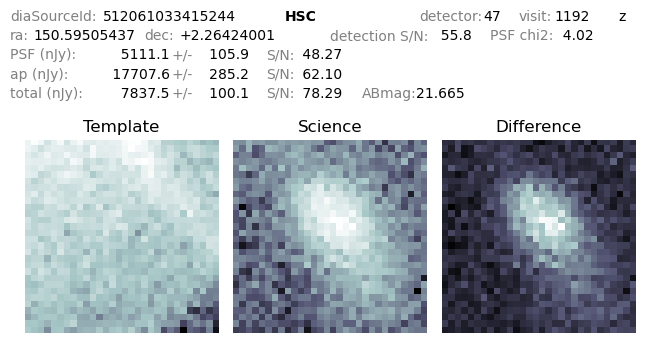

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.59505437364436+2.264240013430634&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.885765524543561


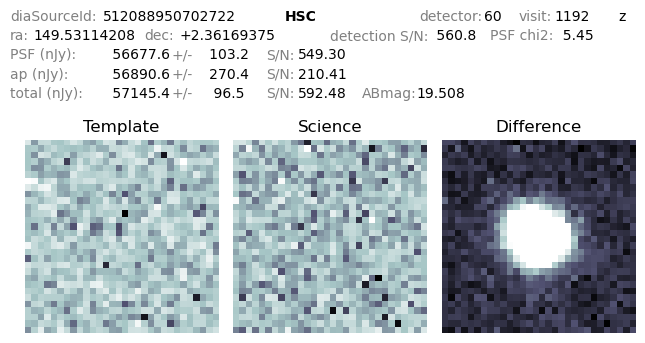

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.53114208495+2.3616937536668865&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6695786159106649


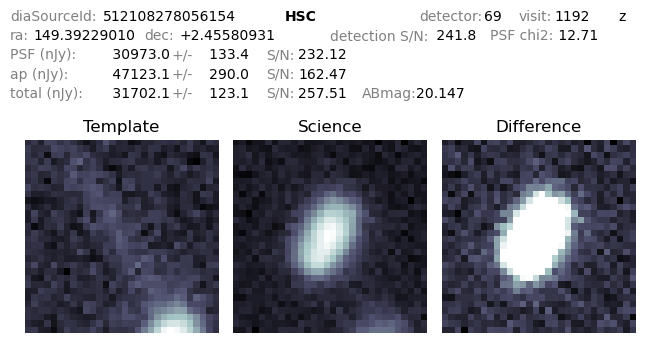

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.3922901047158+2.4558093074257594&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.5018665827327606


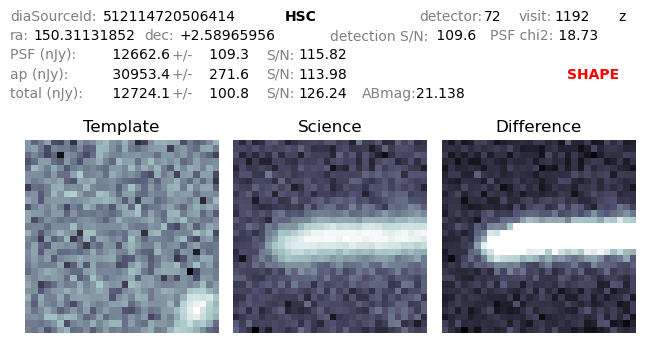

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.3113185152699+2.589659557876936&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

5.134678071603191


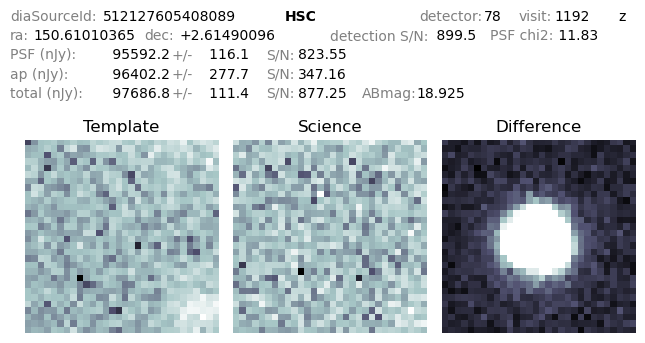

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.61010364799182+2.61490096377425&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5898015438328594


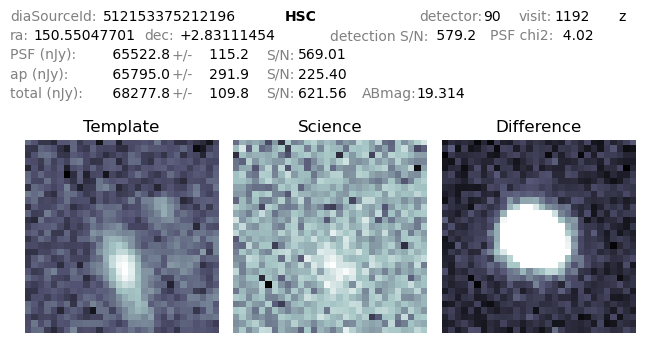

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.55047701435672+2.831114536627146&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6891050238899199


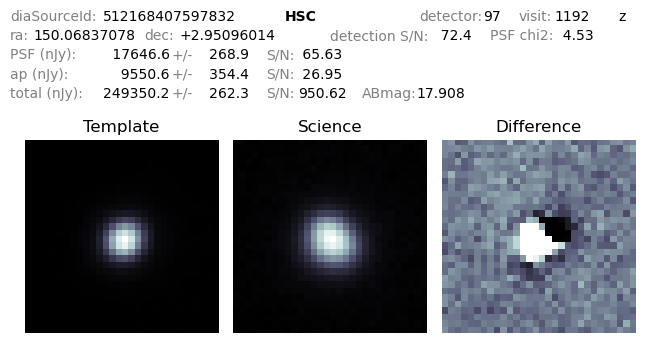

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.06837078305009+2.9509601356546167&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5425776784895258


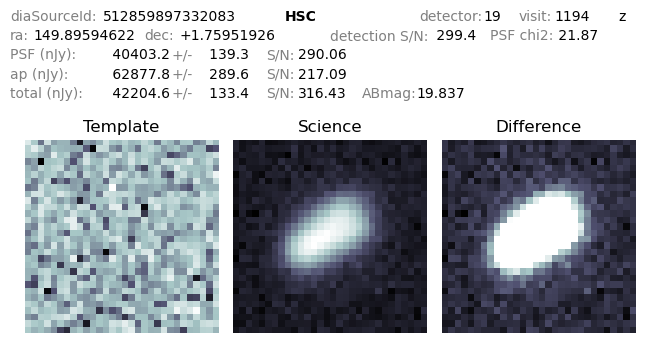

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.8959462238568+1.7595192575532683&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8323839668147288


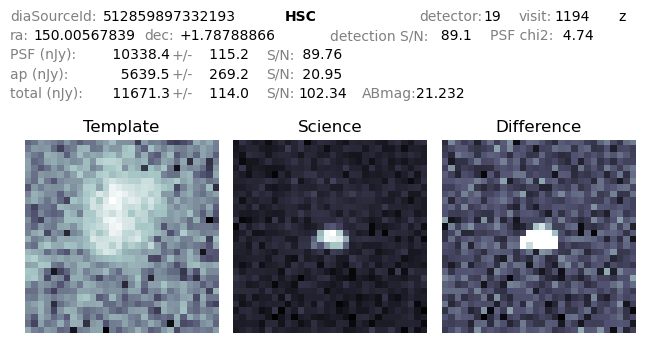

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.00567838749404+1.7878886610806708&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.5159657346968225


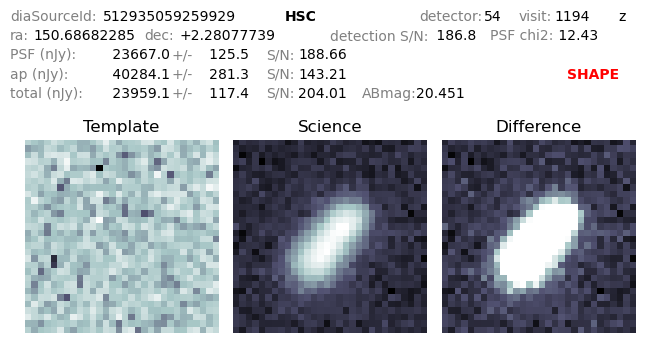

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.68682284756073+2.280777392080334&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.7383446458715739


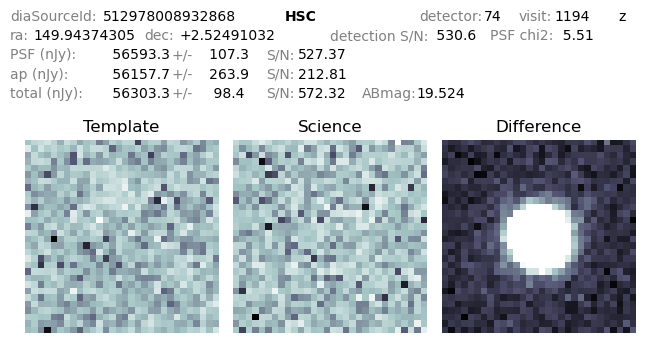

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.94374304592256+2.5249103184015915&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.6222652996224998


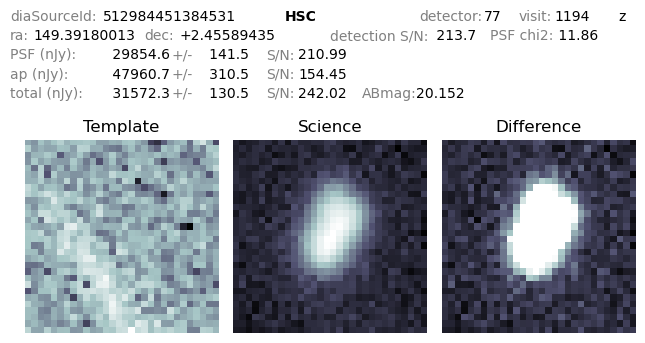

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.39180013156252+2.455894348087198&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.6393940298691194


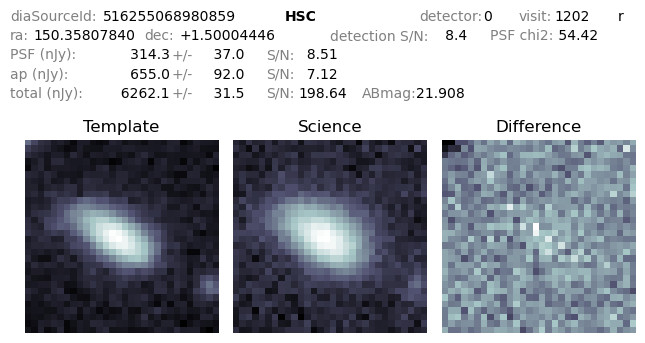

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.35807840383512+1.5000444600925118&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

1.9196156966863083


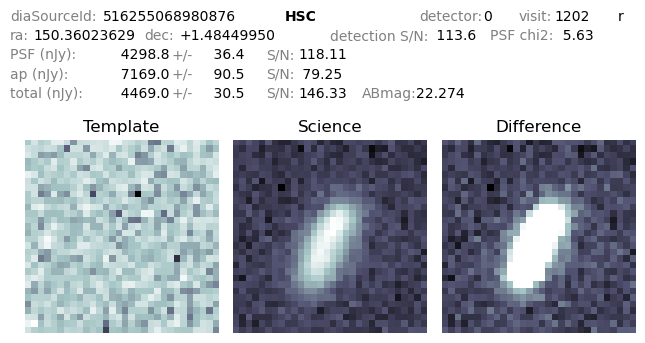

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.36023629083311+1.4844995016000433&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.8949873267027373


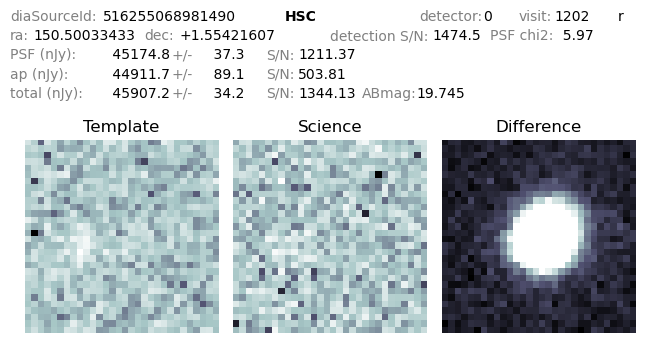

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.50033433077138+1.5542160712903315&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.45870817998438074


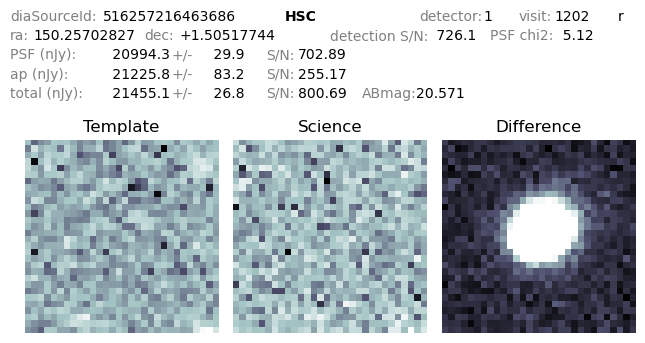

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.257028274777+1.505177435373709&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.47868230908056264


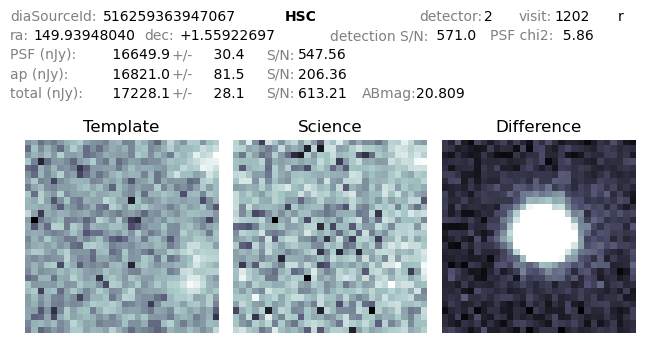

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.93948040193789+1.559226970707346&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.4987869029114769


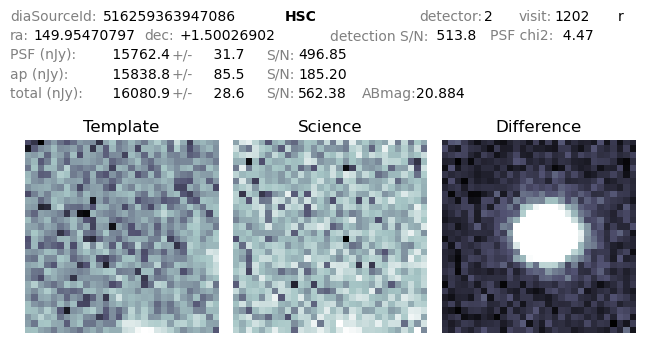

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.95470796690765+1.5002690195348696&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.4128592764204204


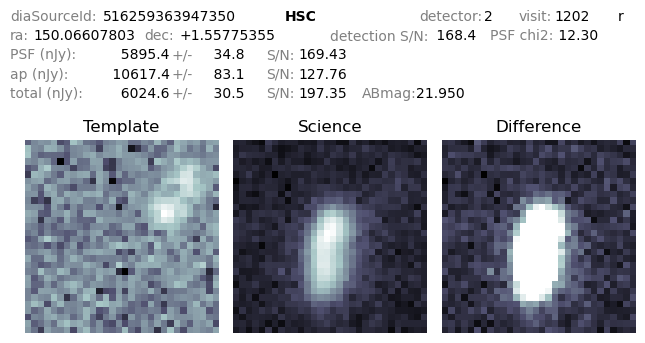

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.06607802712094+1.5577535545774785&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
1.9436807548133466


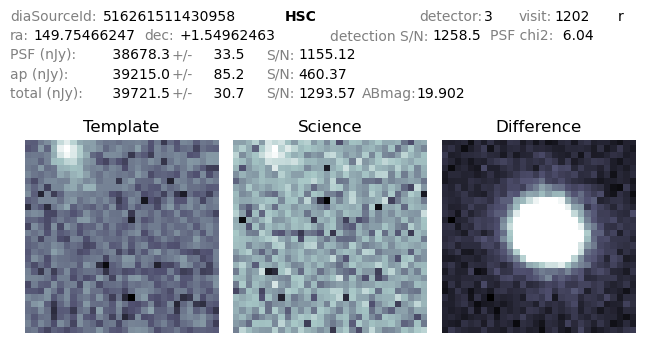

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.75466247429222+1.5496246300940655&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.3994760758028458


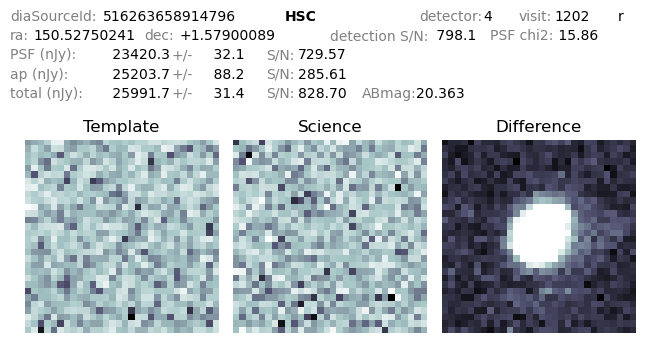

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.52750241278028+1.5790008928646817&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.5021784380182416


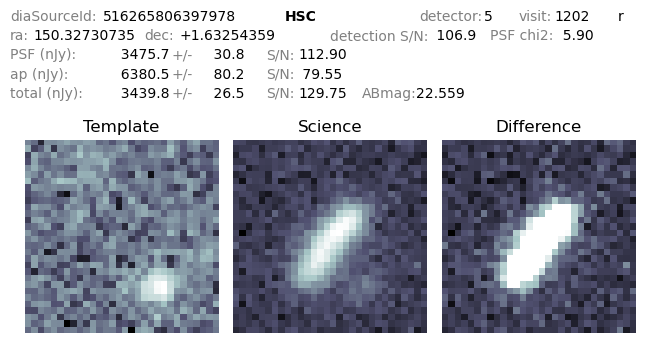

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.32730735231502+1.632543592675361&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

2.1265996539530025


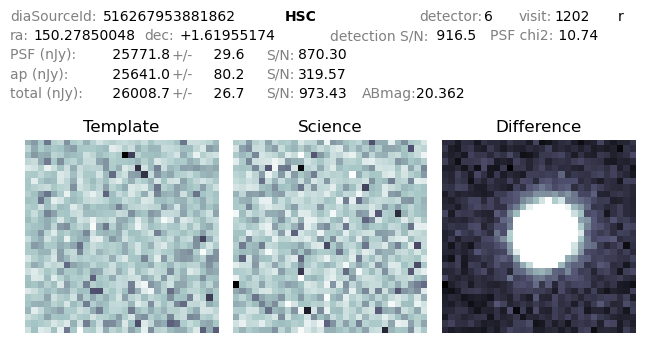

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2785004793549+1.6195517414213154&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.48692486938778967


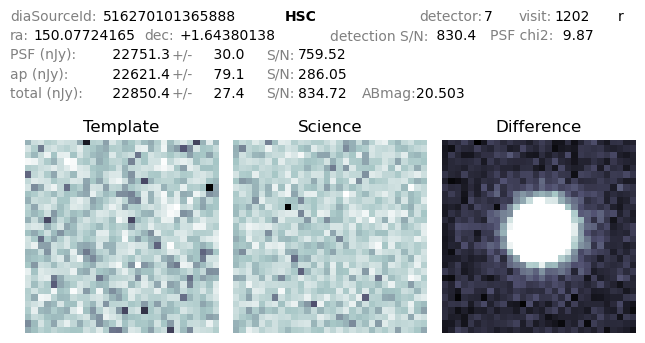

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.0772416470563+1.6438013823143087&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.3976095789251632


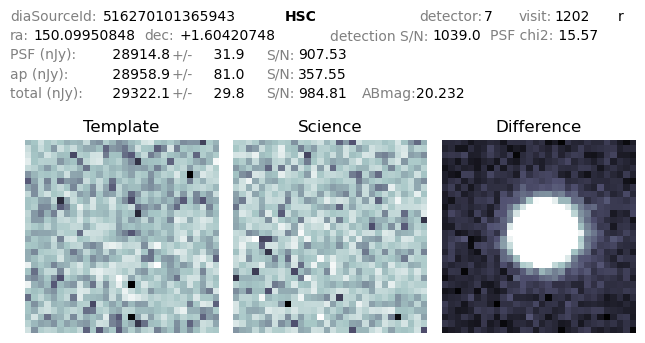

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.09950848494873+1.6042074783823514&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.45056214856359506


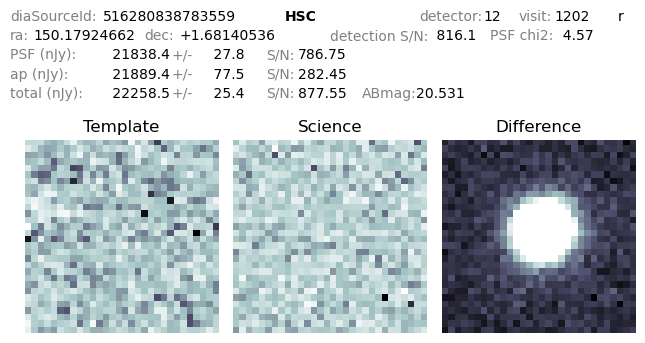

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.17924661695758+1.681405360620352&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.44385620194653413


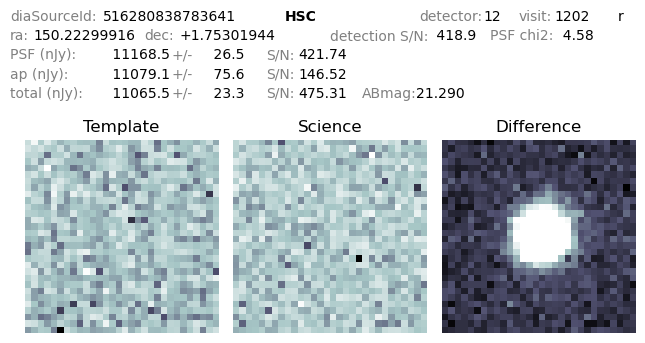

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.22299916083824+1.7530194378633035&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.3091262219202992


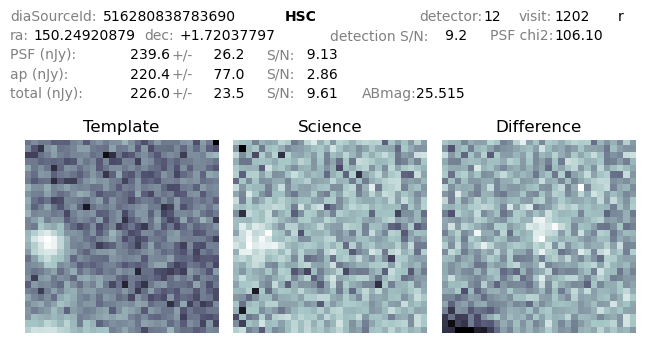

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2492087877263+1.7203779703912938&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.6226175073461835


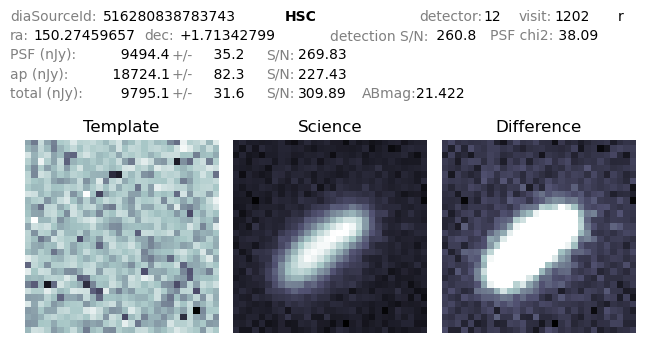

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=150.2745965698133+1.713427988213258&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
2.2596348555439314


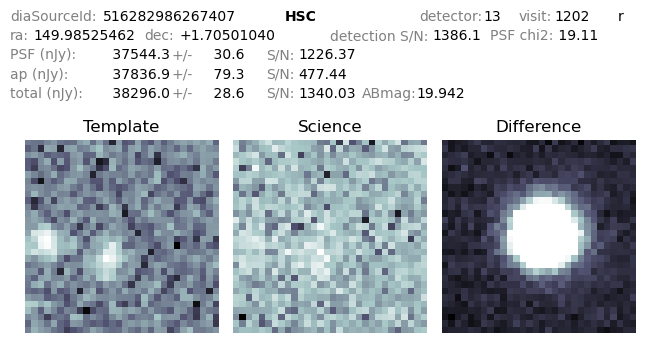

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.98525462175292+1.7050104038019878&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

0.366051828107184


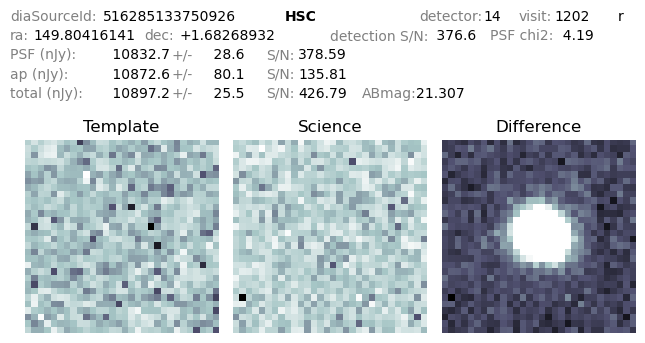

[Link to Simbad search](http://simbad.cds.unistra.fr/simbad/sim-coo?Coord=149.80416141342752+1.6826893185390686&CooFrame=FK5&CooEpoch=2000&CooEqui=2000&CooDefinedFrames=none&Radius=3.0&Radius.unit=arcsec&submit=submit+query&CoordList=)

No matched sources within 3.0 arcseconds.
0.48441115823911224


In [65]:
filter_key=["isDipole", "apFlux", "snr"]
action_key=["bool", "ge", "ge"]
value_key=[False, 0.0, 8.0]

filteredData=filter_data(highReducedChiSources,filter_key,action_key,value_key)

for index, source in filteredData[0:10000].iterrows():
    single_path = path_manager(source['diaSourceId'])
    display(Image(single_path))
    make_simbad_link(source['ra'], source['decl'])
    print(source['trailLength'])
